In [1]:
# Importing necessary libraries for vector data manipulation and visualization
#--visualization
import datashader as ds 
import datashader.transfer_functions as tf
from datashader.colors import Sets1to3
from datashader.utils import export_image
from PIL import Image, ImageDraw, ImageFont
import io
import imageio
import colorcet as cc
from colorcet import fire, glasbey
from IPython.display import display

#--geospatial data processing
import geopandas as gpd
import geopandas as gpd
import cudf   # for GPU acceleration
import cuspatial #spatial version
import dask#; dask.config.set({"dataframe.backend": "cudf"})
import dask.dataframe as dd
from dask.delayed import delayed
from dask.distributed import Client, LocalCluster
import dask_geopandas as dgpd
from shapely.validation import explain_validity
from shapely.geometry import Point, box
import pyarrow.parquet as pq
import rmm


#police data
from police_api import PoliceAPI #no setup required, just install the package 'police-api-client', see https://github.com/rkhleics/police-api-client-python/
from police_api.exceptions import InvalidCategoryException
from police_api.service import APIError


# Importing necessary libraries for web scraping (here: temperature raster data, unclear API thus scraping was necessary)
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
import re
import fsspec as fs
from base64 import b64encode
import zipfile

# Importing necessary libraries for rasters
from netCDF4 import Dataset # for netCDF data, scaped
import cupy as cp
import rioxarray
import xarray as xr
from rasterstats import zonal_stats             # for aggregating raster data based on polygon vector data
from rasterio.transform import from_origin

# general libraries
import os
import numpy as np
import pandas as pd
from datetime import datetime
from tqdm import tqdm # showing progress bar
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import json
import csv
import logging
import sqlite3 #for dealing with gpkg (which are sqlite databases)
from pathlib import Path
from typing import Union
from datetime import date, timedelta
from dateutil.relativedelta import relativedelta # For easy month iteration
import time
import glob
import traceback
import shutil
import hashlib


# Set up folder structure and gpkg to store processed data in (with UK crs)

In [2]:
# define root of project, and frequently used paths
SCRIPT_LOCATION = Path.cwd().resolve()       # get the location of the script (current working directory, root/code/Data_munching)
PROJECT_ROOT = SCRIPT_LOCATION.parent.parent # go two directories up to get the project root

#dirs in project root
DATA_DIR = PROJECT_ROOT / 'data'             # data directory
PLOT_DIR = PROJECT_ROOT / 'plots'            # figures directory

#subdirs of data directory
CRIME_DIR = DATA_DIR / 'crime'               # crime data directory
HELPER_DIR = DATA_DIR / 'help_data'          # helper data directory, e.g. for gis boundaries
MAIN_DATA_DIR = DATA_DIR / 'main'            # main data directory, where processed data is stored
TEMP_DIR = DATA_DIR / 'temperature'          # temp data directory, where raster temperature data is stored
LSOA_DIR = DATA_DIR / 'lsoa'                 # lsoa data directory, where lsoa shapefiles are stored
MSOA_DIR = DATA_DIR / 'msoa'
TEMP_DDIR = TEMP_DIR / 'download'

#subdirs for plots
CRIME_PLOT_DIR = PLOT_DIR / 'crime_distribution'

# if directories do not exist, create them
directories_to_create = [
    DATA_DIR,
    PLOT_DIR,
    CRIME_DIR,
    HELPER_DIR,
    MAIN_DATA_DIR,
    TEMP_DIR,
    LSOA_DIR,
    CRIME_PLOT_DIR
]

for dir_path in directories_to_create:
    try:
        dir_path.mkdir(parents=True, exist_ok=True)  # exist_ok=True: won't raise error if directory already exist, parents=True: will create parent directories if needed 
        print(f"Directory ensured: {dir_path}")
    except OSError as e:
        # Handle potential permission errors or other OS issues
        print(f"Error creating directory {dir_path}: {e}")
    except Exception as e:
        print(f"An unexpected error occurred creating {dir_path}: {e}")

Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/plots
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data/crime
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data/main
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data/temperature
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa
Directory ensured: /mnt/c/Users/Ruben/Documents/Project_crime/plots/crime_distribution


In [3]:
# initiate a gpkg database to store the downloaded and processed data
GPKG_FILENAME = 'processed_london_crime_data.gpkg'
GPKG_PATH = MAIN_DATA_DIR / GPKG_FILENAME
TARGET_CRS = "EPSG:27700" #UK crs
TARGET_EPSG = 27700
API_CRS = "EPSG:4326"
API_EPSG = 4326
# check if the gpkg file already exists, if not, create it
if not GPKG_PATH.exists():
    empty_gdf = gpd.GeoDataFrame(geometry=[], crs = TARGET_CRS)
    placeholder_layer = 'init_gpkg' #can be removed later
    empty_gdf.to_file(GPKG_PATH, layer=placeholder_layer, driver='GPKG')
else:
    print(f"GeoPackage already exists at: {GPKG_PATH}.")

GeoPackage already exists at: /mnt/c/Users/Ruben/Documents/Project_crime/data/main/processed_london_crime_data.gpkg.


## Downloading the data

### first get statistical gis boundaries of London
We are particularly interested in the 2011 LSOA data, giving a good balacne between detail and aggregation for the crime data later.

[Source]( https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london): 

Greater London Authority. Opinion Research and General Statistics (GLA). (n.d.). *Statistical GIS Boundary Files for London*. London Datastore. Retrieved April 5, 2025. 


[UK Open Government Licence](https://www.nationalarchives.gov.uk/information-management/re-using-public-sector-information/uk-government-licensing-framework/)

Contains Ordnance Survey data © Crown copyright and database right 2012.  
Contains National Statistics data © Crown copyright and database right 2012. 

In [4]:
download_url_gis_boundaries = r'https://data.london.gov.uk/download/statistical-gis-boundary-files-london/9ba8c833-6370-4b11-abdc-314aa020d5e0/statistical-gis-boundaries-london.zip'

def download_link(url: str, target_dir: Union[str, Path]) -> Union[Path, None]:
    try:
        # Extract filename from URL
        parsed_url = urlparse(url)
        filename = Path(parsed_url.path).name
        if not filename:
            # If the URL does not have a filename, use the last part of the URL
            filename = url.split('/')[-1]
            if '?' in filename:  # clean parameters if any stuck to the name
                filename = filename.split('?')[0]

        target_file_path = Path(target_dir) / filename

        # Ensure the target directory exists
        Path(target_dir).mkdir(parents=True, exist_ok=True)

        # Avoid re-downloading if the file already exists
        if target_file_path.exists():
            print(f"File already exists: {target_file_path}", "Skipping download.")
            return target_file_path
        else:
            print(f"Starting download from: {url}")
            print(f"Saving to: {target_file_path}")
            response = requests.get(url, stream=True)
            response.raise_for_status()  # Check for HTTP errors
            # Write the content to the file in chunks
            chunk_size = 8192
            total_downloaded = 0
            with open(target_file_path, 'wb') as f:
                for chunk in response.iter_content(chunk_size=chunk_size):
                    if chunk:
                        f.write(chunk)
                        total_downloaded += len(chunk)
                        print(f"\rDownloaded {total_downloaded / (1024*1024):.2f} MB", end="")

            print(f"\nDownload complete. File saved to {target_file_path}")
            print(f"Total size: {total_downloaded / (1024*1024):.2f} MB")
            return target_file_path
    except requests.exceptions.RequestException as e:
        print(f"\nError during download: {e}")
    except OSError as e:
        print(f"\nError creating directory or writing file: {e}")
    except Exception as e:
        print(f"\nAn unexpected error occurred: {e}")
    return None
    
zip_file_path = download_link(download_url_gis_boundaries, HELPER_DIR) # download the GIS boundaries from the GLA website

File already exists: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/statistical-gis-boundaries-london.zip Skipping download.


The areas are given in different files contained in the zipfile. Select the ones we want by filtering filenames with 'LSOA' and '2011' in the name.

In [5]:
import zipfile
from pathlib import Path # Good practice for handling paths

def filter_files_from_zip(zip_file_path: Path, filter_strings: list) -> list:
    """
    Filters file names within a zip archive based on a list of required substrings.

    Parameters:
    - zip_file_path: Path object pointing to the zip file.
    - filter_strings: A list of strings. A file name is included if it
                      contains *all* strings from this list.

    Returns:
    - filtered_files: A list of file names from the zip archive that
                      match the filtering criteria. Returns an empty list
                      if no files match or if an error occurs.
    """
    # Initialize a NEW list to store results
    filtered_files_results = []

    # Ensure filter_strings is a list
    if isinstance(filter_strings, str):
        filter_strings = [filter_strings]

    if not filter_strings:
         return filtered_files_results

    # Check if the zip file exists
    if not zip_file_path.is_file():
        print(f"Error: ZIP file not found at {zip_file_path}")
        return filtered_files_results # Return empty list on error

    # gather all files in the zip file that match the filter criteria
    try:
        with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            for file_name in zip_ref.namelist():
                if all(s in file_name for s in filter_strings):
                    filtered_files_results.append(file_name)

    # Handle potential errors
    except zipfile.BadZipFile:
        print(f"Error: File {zip_file_path} is not a valid ZIP file or is corrupted.")
        return [] 
    except Exception as e:
        print(f"An unexpected error occurred while reading the ZIP file: {e}")
        return [] 

    return filtered_files_results

#get files in the zip file that match the filter criteria
filter_criteria_lsoa = ['LSOA', "2011"]
filter_criteria_msoa = ['MSOA', "2011"]
list_of_filtered_files_lsoa = filter_files_from_zip(zip_file_path, filter_criteria_lsoa)
list_of_filtered_files_msoa = filter_files_from_zip(zip_file_path, filter_criteria_msoa)



In [6]:
list_of_filtered_files_msoa

['statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.dbf',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.prj',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.sbn',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.sbx',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.shp',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.shp.xml',
 'statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.shx',
 'statistical-gis-boundaries-london/MapInfo/MSOA_2011_London_gen_MHW.DAT',
 'statistical-gis-boundaries-london/MapInfo/MSOA_2011_London_gen_MHW.ID',
 'statistical-gis-boundaries-london/MapInfo/MSOA_2011_London_gen_MHW.MAP',
 'statistical-gis-boundaries-london/MapInfo/MSOA_2011_London_gen_MHW.tab']

In [6]:
# now extract the files from the zip file
def extract_files_from_zip(zip_file_path: Path, file_names: list, target_dir: Path) -> list:
    """
    Extracts specified files from a zip archive to a target directory.

    Parameters:
    - zip_file_path: Path object pointing to the zip file.
    - file_names: A list of file names to extract from the zip archive.
    - target_dir: Path object pointing to the target directory where files will be extracted.

    Returns:
    - extracted_files: A list of paths to the extracted files.
    """
    # Initialize a list to store results
    extracted_files = []

    # Ensure target_dir exists
    target_dir.mkdir(parents=True, exist_ok=True)

    # Check if the zip file exists
    if not zip_file_path.is_file():
        print(f"Error: ZIP file not found at {zip_file_path}")
        return extracted_files  # Return empty list on error

    # Extract files from the zip archive
    try:
        with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            for file_name in file_names:
                # Check if the file exists in the zip before extracting
                if file_name in zip_ref.namelist():
                    # Construct full path for extraction
                    target_file_path = target_dir / Path(file_name).name
                    with open(target_file_path, 'wb') as f:
                        f.write(zip_ref.read(file_name))
                        extracted_files.append(target_file_path)
                        print(f"Extracted {file_name} to {target_file_path}")

    # Handle potential errors
    except zipfile.BadZipFile:
        print(f"Error: File {zip_file_path} is not a valid ZIP file or is corrupted.")
        return [] 
    except Exception as e:
        print(f"An unexpected error occurred while extracting files: {e}")
        return [] 

    return extracted_files

# extract the files from the zip file, put into lsao directory
extracted_files_lsoa = extract_files_from_zip(zip_file_path, list_of_filtered_files_lsoa, LSOA_DIR)
extracted_files_msoa = extract_files_from_zip(zip_file_path, list_of_filtered_files_msoa, MSOA_DIR)

Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.dbf to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.dbf
Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.prj to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.prj
Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.sbn to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.sbn
Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.sbx to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.sbx
Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.shp to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.shp
Extracted statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.shp.xml to /mnt/c/Users/Ruben/Documents/Project_crime/data/lsoa/LSOA_2011_London_gen_MHW.shp.xml
Extracted stat

In [19]:
extracted_files_msoa

[PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.dbf'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.prj'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.sbn'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.sbx'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.shp'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.shp.xml'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.shx'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.DAT'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.ID'),
 PosixPath('/mnt/c/Users/Ruben/Documents/project_crime/data/msoa/MSOA_2011_London_gen_MHW.MAP'),
 PosixPath('/mnt/c/Users/Ru

In [7]:
# read the shapefiles into a geopandas dataframe, inspect it and make sure to use correct crs
shp_files_found_lsoa  = list(LSOA_DIR.rglob('*.shp'))
shp_files_found_msoa  = list(MSOA_DIR.rglob('*.shp'))
if not shp_files_found_lsoa or not shp_files_found_msoa:
        print("No shp files found in lsao or msoadir.")
else:
    if len(shp_files_found_msoa) > 1 or len(shp_files_found_lsoa) > 1:
        print(f"Warning: More than one shp file found in lsao dir. Using the first one.")
        shp_path_lsoa = shp_files_found_lsoa[0]
        shp_path_msoa = shp_files_found_msoa[0]
    else: #no warning
        shp_path_lsoa = shp_files_found_lsoa[0]
        shp_path_msoa = shp_files_found_msoa[0]

In [8]:
lsoa_shapefile = gpd.read_file(shp_path_lsoa).to_crs(epsg=TARGET_EPSG)
msoa_shapefile = gpd.read_file(shp_path_msoa).to_crs(epsg=TARGET_EPSG)

# Inspect the lsoa and msoa data

In [22]:
print(lsoa_shapefile.crs, msoa_shapefile.crs)

EPSG:27700 EPSG:27700


In [24]:
lsoa_shapefile.columns

Index(['LSOA11CD', 'LSOA11NM', 'MSOA11CD', 'MSOA11NM', 'LAD11CD', 'LAD11NM',
       'RGN11CD', 'RGN11NM', 'USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN',
       'HHOLDS', 'AVHHOLDSZ', 'geometry'],
      dtype='object')

In [25]:
msoa_shapefile.columns

Index(['MSOA11CD', 'MSOA11NM', 'LAD11CD', 'LAD11NM', 'RGN11CD', 'RGN11NM',
       'USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN', 'HHOLDS', 'AVHHOLDSZ',
       'geometry'],
      dtype='object')

In [26]:
len(lsoa_shapefile)

4835

In [27]:
len(msoa_shapefile) 

983

In [28]:
# for our purposes, we only need the geometry and the lsoa code, msoa code used for plotting to show resolution differecne
lsoa_shapefile = lsoa_shapefile[['LSOA11CD', 'MSOA11CD', 'geometry']]
lsoa_shapefile.head(5)

,LSOA11CD,MSOA11CD,geometry
0,E01000001,E02000001,"POLYGON ((532105.092 182011.23, 532162.491 181..."
1,E01000002,E02000001,"POLYGON ((532746.813 181786.891, 532671.688 18..."
2,E01000003,E02000001,"POLYGON ((532135.145 182198.119, 532158.25 182..."
3,E01000005,E02000001,"POLYGON ((533807.946 180767.77, 533649.063 180..."
4,E01000006,E02000017,"POLYGON ((545122.049 184314.931, 545271.917 18..."


In [46]:
print(
    lsoa_shapefile.LSOA11CD.unique().shape,
    msoa_shapefile.MSOA11CD.unique().shape,
)

(4835,) (983,)


In [29]:
lsoa_shapefile.isna().sum() # check for missing values

LSOA11CD    0
MSOA11CD    0
geometry    0
dtype: int64

In [30]:
msoa_shapefile.isna().sum() 

MSOA11CD     0
MSOA11NM     0
LAD11CD      0
LAD11NM      0
RGN11CD      0
RGN11NM      0
USUALRES     0
HHOLDRES     0
COMESTRES    0
POPDEN       0
HHOLDS       0
AVHHOLDSZ    0
geometry     0
dtype: int64

# check for faulty geometries

In [9]:
invalid_geometries_count = (~lsoa_shapefile['geometry'].is_valid).sum()
valid_geometries_count = lsoa_shapefile['geometry'].is_valid.sum()

print(f"Number of invalid geometries: {invalid_geometries_count}")
print(f"Number of valid geometries: {valid_geometries_count}")


Number of invalid geometries: 8
Number of valid geometries: 4827


In [10]:
# Since we ahve 8 invalid geometries, we will investigate them
invalid_geometries = lsoa_shapefile[~lsoa_shapefile['geometry'].is_valid]
invalid_reasons = invalid_geometries['geometry'].apply(explain_validity)
invalid_reasons

280     Ring Self-intersection[524114.807962692 195546...
799     Ring Self-intersection[544591.411956789 168278...
1260    Ring Self-intersection[518322.776964573 181857...
1333    Ring Self-intersection[519692.173963877 179591...
3745    Ring Self-intersection[513579.730965624 171614...
3799    Ring Self-intersection[515339.347965108 172354...
3925    Ring Self-intersection[534328.818959723 175124...
4482    Ring Self-intersection[525059.475962488 173320...
Name: geometry, dtype: object

In [11]:
# the reason is selfintersection, and for self-intersecting polygons, we can try to fix them using the buffer(0) trick
invalid_mask = ~lsoa_shapefile['geometry'].is_valid
buffered_geoms = lsoa_shapefile.loc[invalid_mask, 'geometry'].buffer(0)
lsoa_shapefile.loc[invalid_mask, 'geometry'] = buffered_geoms
print(f"Number of invalid geometries after repair: {(~lsoa_shapefile['geometry'].is_valid).sum()}")

Number of invalid geometries after repair: 0


In [12]:
#repeat for msoa
invalid_geometries_count = (~msoa_shapefile['geometry'].is_valid).sum()
valid_geometries_count = msoa_shapefile['geometry'].is_valid.sum()

print(f"Number of invalid geometries: {invalid_geometries_count}")
print(f"Number of valid geometries: {valid_geometries_count}")

invalid_geometries = msoa_shapefile[~msoa_shapefile['geometry'].is_valid]
invalid_reasons = invalid_geometries['geometry'].apply(explain_validity)
print(invalid_reasons)

Number of invalid geometries: 4
Number of valid geometries: 979
146    Ring Self-intersection[544591.411956092 168278...
241    Ring Self-intersection[518322.776964832 181857...
494    Ring Self-intersection[509845.123966657 181953...
914    Ring Self-intersection[525059.475962367 173320...
Name: geometry, dtype: object


In [13]:
#egain buffer0 trick
# the reason is selfintersection, and for self-intersecting polygons, we can try to fix them using the buffer(0) trick
invalid_mask = ~msoa_shapefile['geometry'].is_valid
buffered_geoms = msoa_shapefile.loc[invalid_mask, 'geometry'].buffer(0)
msoa_shapefile.loc[invalid_mask, 'geometry'] = buffered_geoms
print(f"Number of invalid geometries after repair: {(~msoa_shapefile['geometry'].is_valid).sum()}")

Number of invalid geometries after repair: 0


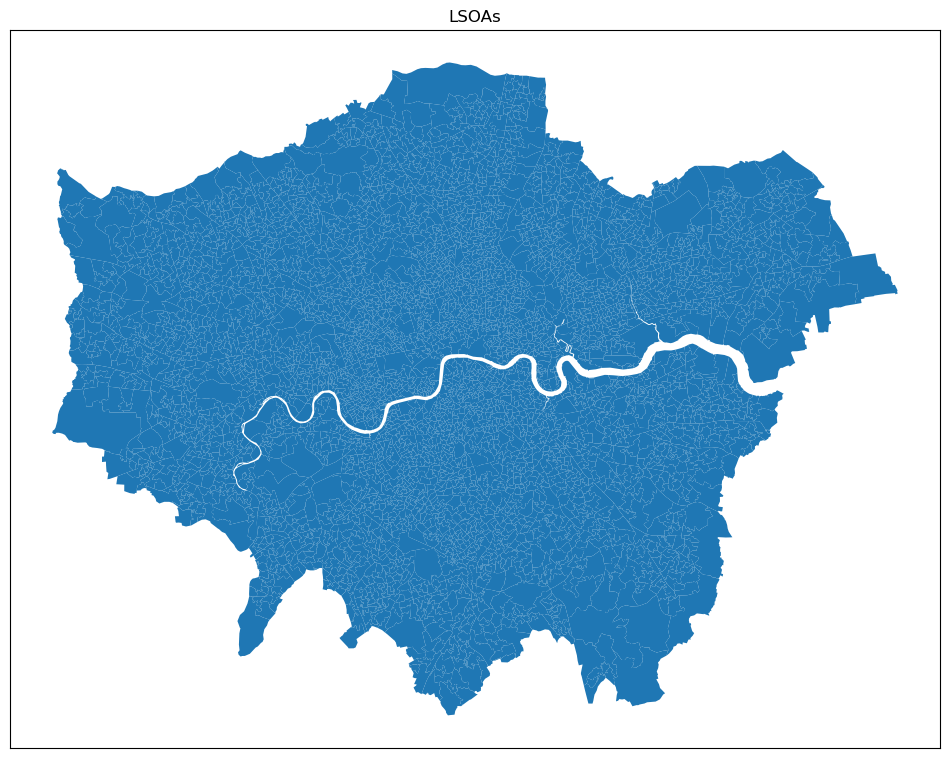

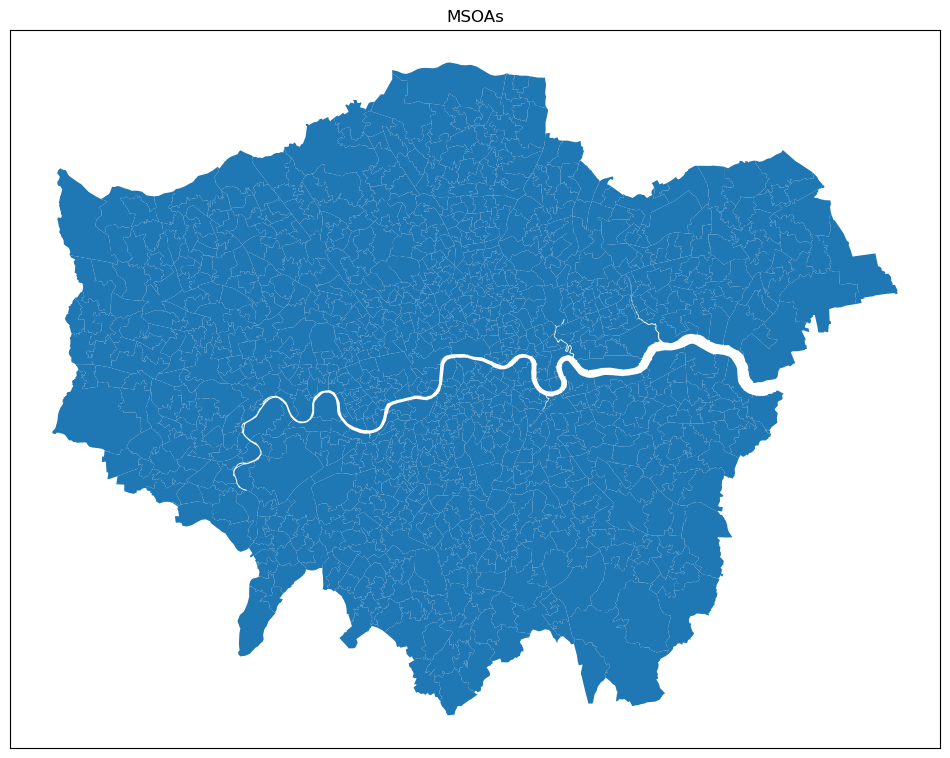

In [14]:
fig1, ax1 = plt.subplots(1, 1, figsize=(12, 12))
lsoa_shapefile.plot(

    categorical=True,
    legend=False,     
    ax=ax1           
)
ax1.set_title('LSOAs')
ax1.set_xticks([])
ax1.set_yticks([])

fig2, ax2 = plt.subplots(1, 1, figsize=(12, 12))
msoa_shapefile.plot(

    categorical=True,
    legend=False,
    ax=ax2           
)
ax2.set_title('MSOAs')
ax2.set_xticks([])
ax2.set_yticks([])

# Show both figures
plt.show()

In [13]:
lsoa_shapefile.explore(
    column='MSOA11CD',  # Color polygons by MSOA code
    cmap='tab20',       
    tooltip=['LSOA11CD'],  
    popup=True,       
    tiles='CartoDB positron',  
    legend=False,        
    name='LSOA Polygons'  
)

In [51]:
# the data looks good and is now clean, we can save it to the gpkg file
lsoa_shapefile.to_file(GPKG_PATH, layer='LSOA', driver='GPKG', mode = 'w') #(uncomment to save)
msoa_shapefile.to_file(GPKG_PATH, layer='MSOA', driver='GPKG', mode = 'w') #(uncomment to save)

In [15]:
# save london bounding box based on LSOA bounding box, for both crs
lsoa_temp = lsoa_shapefile.copy()
lsoa_temp = lsoa_temp.to_crs(epsg = API_EPSG)

BBOX_LONDON_TARGET_CRS = lsoa_shapefile.total_bounds
BBOX_LONDON_API_CRS = lsoa_temp.total_bounds


print(BBOX_LONDON_TARGET_CRS, BBOX_LONDON_API_CRS)

[503574.18796892 155850.79792321 561956.68795139 200933.60890963] [-0.51028051 51.28675863  0.3340239  51.69187567]


# Downloading crime data
Source: [data.police.uk](https://data.police.uk/), detailed explanation about the data and its quality can be found [here](https://data.police.uk/about/). 

ASB Incidents, Crime and Outcomes (Crime and Criminal Justice). Monthly data on Individual crime and anti-social behaviour (ASB) incidents, including street-level location information and subsequent police and court outcomes associated with the crime.
Licence: [Open Government Licence v3.0](https://www.nationalarchives.gov.uk/doc/open-government-licence/version/3/). 

"The following data should not be considered as official statistics, but rather as an indication only, of current force performance on the date it is published."

The source includes a [standard API](https://data.police.uk/docs/) JSON web service using HTTP GET and POST requests, but there is also a [python package](https://github.com/rkhleics/police-api-client-python/) for dealing with the API, which I tried but wasn't helpful for my purpose.

[API rate limit](https://data.police.uk/docs/api-call-limits/): "on average you must make fewer than 15 requests each second, but you can make up to 30 in a single second."

# Findings of API:

The API does not provide all data for all years, but only for the last couple of years.
this is a problem, since we need the data from 2011 to 2019 for the analysis.
Therefore we need to download the archives 'manuall', and extract the data from there.
The blocks below shows the limitation (bounding box of London being too big, and not enough temporal range)

In [21]:
# define the area of interest, based on the LSOA shapefile, but in EPSG:4326 (as most APIs use this)
lsoa_shapefile = lsoa_shapefile.to_crs(epsg=4326)
bbox = lsoa_shapefile.total_bounds

bounding_box_polygon = [
    (bbox[1], bbox[0]),  #sw
    (bbox[1], bbox[2]),  #se
    (bbox[3], bbox[2]),  #ne
    (bbox[3], bbox[0]),  #nw
    (bbox[1], bbox[0])   #close
]

#format coordinates to 3 decimal places
for i in range(len(bounding_box_polygon)):
    lat, lon = bounding_box_polygon[i]
    bounding_box_polygon[i] = (round(lat, 1), round(lon, 1))  

#format coordinate for api call (example : poly=52.268,0.543:52.794,0.238:52.130,0.478)
bounding_box_polygon_api = "&poly=" + ':'.join([f"{lat},{lon}" for lat, lon in bounding_box_polygon])
bounding_box_polygon_api

'&poly=51.3,-0.5:51.3,0.3:51.7,0.3:51.7,-0.5:51.3,-0.5'

In [22]:
# get start and end date for the data we want to download (biggest range is 2010-12 to latest month)
start_date = date(2010, 12, 1)
end_date = date(2025, 2, 1)

# create a list of months to download
dates_to_fetch = []
current_date = start_date
while current_date <= end_date:
    dates_to_fetch.append(current_date.strftime('%Y-%m'))
    current_date += relativedelta(months=1)




In [23]:
# exmaine example of when api call fails
base_url_api_all_crimes = r"https://data.police.uk/api/crimes-street/all-crime"
date_api = f"?date={dates_to_fetch[150]}"
bounding_box_polygon_api = "&poly=" + ':'.join([f"{lat},{lon}" for lat, lon in bounding_box_polygon])
api_call = base_url_api_all_crimes + date_api + bounding_box_polygon_api
api_call

'https://data.police.uk/api/crimes-street/all-crime?date=2023-06&poly=51.3,-0.5:51.3,0.3:51.7,0.3:51.7,-0.5:51.3,-0.5'

Below we can see that even just taking London for a month, the bounding box is too big

In [24]:
response = requests.get(api_call)
response # status 503 - "If a custom area contains more than 10,000 crimes, the API will return a 503 status code."


<Response [503]>

Here we can see that we can't pick early dates, it simply returns 404

In [25]:
date_api = f"?date={dates_to_fetch[1]}"
bounding_box_polygon_api = "&poly=" + ':'.join([f"{lat},{lon}" for lat, lon in bounding_box_polygon])
api_call = base_url_api_all_crimes + date_api + bounding_box_polygon_api
api_call

'https://data.police.uk/api/crimes-street/all-crime?date=2011-01&poly=51.3,-0.5:51.3,0.3:51.7,0.3:51.7,-0.5:51.3,-0.5'

In [26]:
response = requests.get(api_call)
response # status 404 - data simply not available for this date


<Response [404]>

# Solution: 
Sadly, this solution is brute force: get the entire archive, and water it down to what we need.  

Step 1: Scrape the [archive](https://data.police.uk/data/archive/) (each zipped 'month' is the publication month, which all contain a temporal range of a couple of years, so dont scrape them all!). 

Step 2: Zips contain csvs, get only relevant csvs, process them and eventuall save as a gpkg. 

In [27]:
TARGET_URL = "https://data.police.uk/data/archive/"
OUTPUT_FILE = HELPER_DIR / "selected_archive_links.txt"

def parse_archive_info(block, base_url):
    """
    Parses an HTML block representing an archive file to extract relevant info.
    Returns a dictionary or None if parsing fails.
    """
    info = {}
    try:
        # Find the link (usually within a heading or strong tag)
        link_tag = block.find('a', href=re.compile(r'\.zip$', re.IGNORECASE))
        if not link_tag:
            return None

        info['link_url'] = urljoin(base_url, link_tag['href'])
        link_text = link_tag.get_text(strip=True) 
        match_end = re.search(r"([A-Za-z]+)\s+(\d{4})", link_text)
        if not match_end:
            print(f"Warning: Could not parse end date from link text: {link_text}")
            return None
        end_month_str, end_year_str = match_end.groups()
        try:
            temp_end_date = datetime.strptime(f"{end_month_str} {end_year_str}", "%B %Y").date()
            info['archive_end_date'] = (temp_end_date + relativedelta(months=1)) - relativedelta(days=1)
        except ValueError:
             print(f"Warning: Could not parse month '{end_month_str}'. Skipping.")
             return None

        # Find the description text (e.g., "Contains data from Mar 2022 to Feb 2025")
        description_tag = block.find(string=re.compile(r"Contains data from", re.IGNORECASE))
        if not description_tag:
             p_tags = block.find_all('p')
             for p in p_tags:
                 if "Contains data from" in p.get_text():
                      description_tag = p.get_text(strip=True)
                      break
             if not description_tag:
                 print(f"Warning: Could not find description text for link: {link_text}")
                 return None
        else:
             description_tag = description_tag.strip()

        # Extract start and end dates from the description string
        match_range = re.search(r"from\s+([A-Za-z]{3})\s+(\d{4})\s+to\s+([A-Za-z]{3})\s+(\d{4})", description_tag, re.IGNORECASE)
        if not match_range:
            print(f"Warning: Could not parse date range from description: {description_tag}")
            if 'archive_end_date' in info:
                 return None
            else:
                 return None

        start_month_abbr, start_year_str, end_month_abbr, end_year_str_desc = match_range.groups()

        # Parse start date (beginning of the month)
        try:
             info['range_start_date'] = datetime.strptime(f"{start_month_abbr} {start_year_str}", "%b %Y").date()
        except ValueError:
             print(f"Warning: Could not parse start date '{start_month_abbr} {start_year_str}'. Skipping.")
             return None

        return info

    except Exception as e:
        print(f"Error parsing block: {e}")
        return None

In [28]:
print(f"Fetching archive page: {TARGET_URL}")
try:
    response = requests.get(TARGET_URL, timeout=30)
    response.raise_for_status() # Check for HTTP errors
except requests.exceptions.RequestException as e:
    print(f"Error fetching URL: {e}")
    exit()



Fetching archive page: https://data.police.uk/data/archive/


In [29]:
print("Parsing HTML content...")
soup = BeautifulSoup(response.content, 'html.parser')
soup

Parsing HTML content...



<!DOCTYPE html>

<!--[if lt IE 7]><html class="no-js lt-ie9 lt-ie8 lt-ie7" lang="en" 
><![endif]-->
<!--[if (IE 7)&!(IEMobile)]><html class="no-js lt-ie9 lt-ie8 ie7" lang="en" 
><![endif]-->
<!--[if (IE 8)&!(IEMobile)]><html class="no-js lt-ie9 ie8" lang="en" 
><![endif]-->
<!--[if gt IE 8]><!--><html class="no-js" lang="en"><!--<![endif]-->
<head>
<title>Data downloads | data.police.uk</title>
<meta charset="utf-8"/>
<meta content="width=device-width, initial-scale=1.0" name="viewport"/>
<meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
<meta content="yes" name="mobile-web-app-capable">
<meta content="" name="description"/>
<!-- Google tag (gtag.js) -->
<script async="" src="https://www.googletagmanager.com/gtag/js?id=G-VR2SY40V3F"></script>
<script>
            window.dataLayer = window.dataLayer || [];
            function gtag(){dataLayer.push(arguments);}
            gtag('js', new Date());

            gtag('config', 'G-VR2SY40V3F');
        </script>
<link href="/

In [30]:
# as we can see, the archive blocks are in divs with class 'download'
archive_blocks = soup.find_all('div', class_='download')
archive_blocks

[<div class="download">
 <i class="icon-file"></i> <span><a href="/data/archive/2025-02.zip">February 2025</a> (1.6 GB)</span>
 <p class="contained-range">Contains data from Mar 2022 to Feb 2025</p>
 <p class="md5sum">5384ad7c2e7ffd078a81311ec24e0708</p>
 </div>,
 <div class="download">
 <i class="icon-file"></i> <span><a href="/data/archive/2025-01.zip">January 2025</a> (1.6 GB)</span>
 <p class="contained-range">Contains data from Feb 2022 to Jan 2025</p>
 <p class="md5sum">48d820c25444e03898c2d75b58eca75a</p>
 </div>,
 <div class="download">
 <i class="icon-file"></i> <span><a href="/data/archive/2024-12.zip">December 2024</a> (1.6 GB)</span>
 <p class="contained-range">Contains data from Jan 2022 to Dec 2024</p>
 <p class="md5sum">ff8039785470c322d1e8f146dae728cf</p>
 </div>,
 <div class="download">
 <i class="icon-file"></i> <span><a href="/data/archive/2024-11.zip">November 2024</a> (1.6 GB)</span>
 <p class="contained-range">Contains data from Dec 2021 to Nov 2024</p>
 <p class=

In [31]:
#retrieve linkurl, start and end date from the crime archive blocks
nr_blocks = len(archive_blocks)
all_archives_info = []
for block in archive_blocks:
    # Skip the "neighbourhood" download block if present, focus on monthly crime archives
    parent_div = block.find_parent('div', class_='archive')
    if parent_div and 'neighbourhood' in parent_div.get('class', []):
        continue
    if parent_div and 'crime' not in parent_div.get('class', []):
         print(f"Skipping non-crime block: {parent_div.get('class')}")
         continue
    info = parse_archive_info(block, TARGET_URL)
    if info:
        all_archives_info.append(info)


In [32]:
all_archives_info

[{'link_url': 'https://data.police.uk/data/archive/2025-02.zip',
  'archive_end_date': datetime.date(2025, 2, 28),
  'range_start_date': datetime.date(2022, 3, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2025-01.zip',
  'archive_end_date': datetime.date(2025, 1, 31),
  'range_start_date': datetime.date(2022, 2, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-12.zip',
  'archive_end_date': datetime.date(2024, 12, 31),
  'range_start_date': datetime.date(2022, 1, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-11.zip',
  'archive_end_date': datetime.date(2024, 11, 30),
  'range_start_date': datetime.date(2021, 12, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-10.zip',
  'archive_end_date': datetime.date(2024, 10, 31),
  'range_start_date': datetime.date(2021, 11, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-09.zip',
  'archive_end_date': datetime.date(2024, 9, 30),
  'range_start_date': datetime.date(2021, 10, 1)},
 {'l

In [33]:
# Sort archives by the end date of the archive snapshot, descending (latest first)
all_archives_info.sort(key=lambda x: x['archive_end_date'], reverse=True)
all_archives_info

[{'link_url': 'https://data.police.uk/data/archive/2025-02.zip',
  'archive_end_date': datetime.date(2025, 2, 28),
  'range_start_date': datetime.date(2022, 3, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2025-01.zip',
  'archive_end_date': datetime.date(2025, 1, 31),
  'range_start_date': datetime.date(2022, 2, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-12.zip',
  'archive_end_date': datetime.date(2024, 12, 31),
  'range_start_date': datetime.date(2022, 1, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-11.zip',
  'archive_end_date': datetime.date(2024, 11, 30),
  'range_start_date': datetime.date(2021, 12, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-10.zip',
  'archive_end_date': datetime.date(2024, 10, 31),
  'range_start_date': datetime.date(2021, 11, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2024-09.zip',
  'archive_end_date': datetime.date(2024, 9, 30),
  'range_start_date': datetime.date(2021, 10, 1)},
 {'l

In [34]:
# now select the archives that are relevant for our date range, so no duplicates
selected_archives = []

# Start with the date range covered by the absolute latest archive
if all_archives_info:
    latest_archive = all_archives_info[0]
    selected_archives.append(latest_archive)
    next_target_start_date = latest_archive['range_start_date']
else:
    print("Cannot proceed without parsed archive info.")
    exit()


# Loop while the start date of the last selected archive is still after our overall target start date
while selected_archives[-1]['range_start_date'] > start_date:
    target_end_date = next_target_start_date - relativedelta(days=1)
    # Find the archive whose own end date is this target end date
    found_next = False
    for archive in all_archives_info:
        if archive['archive_end_date'] == target_end_date:
            if archive in selected_archives:
                continue
            selected_archives.append(archive)
            # Set the next start date 
            next_target_start_date = archive['range_start_date']
            found_next = True
            break 

    if not found_next:
        if selected_archives[-1]['range_start_date'] <= end_date:
             print("The last selected archive already covers the required start date.")
        else:
             print("There might be a gap in the archives or parsing issue.")
             print(f"Last selected archive started {selected_archives[-1]['range_start_date']}.")
        break # Stop the loop if we can't find the next contiguous archive

print(f"\nSelection complete. Found {len(selected_archives)} archives.")



Selection complete. Found 4 archives.


In [35]:
selected_archives

[{'link_url': 'https://data.police.uk/data/archive/2025-02.zip',
  'archive_end_date': datetime.date(2025, 2, 28),
  'range_start_date': datetime.date(2022, 3, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2022-02.zip',
  'archive_end_date': datetime.date(2022, 2, 28),
  'range_start_date': datetime.date(2019, 3, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2019-02.zip',
  'archive_end_date': datetime.date(2019, 2, 28),
  'range_start_date': datetime.date(2016, 3, 1)},
 {'link_url': 'https://data.police.uk/data/archive/2016-02.zip',
  'archive_end_date': datetime.date(2016, 2, 29),
  'range_start_date': datetime.date(2010, 12, 1)}]

In [36]:
download_links = [archive['link_url'] for archive in selected_archives]
download_links

['https://data.police.uk/data/archive/2025-02.zip',
 'https://data.police.uk/data/archive/2022-02.zip',
 'https://data.police.uk/data/archive/2019-02.zip',
 'https://data.police.uk/data/archive/2016-02.zip']

In [37]:
crime_archives = HELPER_DIR / "crime_archive_zips"
zip_file_paths = []
for link in download_links:
    zip_file_path = download_link(link, crime_archives) 
    zip_file_paths.append(zip_file_path)
zip_file_paths

File already exists: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2025-02.zip Skipping download.
File already exists: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2022-02.zip Skipping download.
File already exists: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2019-02.zip Skipping download.
File already exists: /mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2016-02.zip Skipping download.


[PosixPath('/mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2025-02.zip'),
 PosixPath('/mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2022-02.zip'),
 PosixPath('/mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2019-02.zip'),
 PosixPath('/mnt/c/Users/Ruben/Documents/Project_crime/data/help_data/crime_archive_zips/2016-02.zip')]

# Convert downloaded zips with 168 csvs to one geoparquet efficiently

In [38]:
#setup variables and dask for combining csv data into a geoparquet
INTERMEDIATE_GEOPARQUET_DIR = Path(HELPER_DIR) / 'intermediate_partitioned.geoparquet.dir'
FINAL_SINGLE_GEOPARQUET_FILE = Path(HELPER_DIR) / 'final_crime_data.geoparquet'
N_WORKERS = 16
MEMORY_PER_WORKER = '5GB'
PARTITION_SIZE = "512MB"
DASK_TEMP_DIR = Path(HELPER_DIR) / "dask-worker-space"

# from inspecting a csv manually:
COLS_TO_READ_ORIGINAL = ['Month', 'Longitude', 'Latitude', 'LSOA code', 'LSOA name',
                         'Crime type', 'persistent_id', 'id', 'Crime ID']
FINAL_COLS_CLEANED_ATTR = ['month', 'longitude', 'latitude', 'lsoa_code',
                           'lsoa_name', 'crime_type']
ID_COLS_CLEANED = ['persistent_id', 'id', 'crime_id']
COLS_NEEDED_CLEANED_ATTR = sorted(list(set(FINAL_COLS_CLEANED_ATTR + ID_COLS_CLEANED))) 
DTYPES_ORIGINAL = {'Month': 'string', 'Longitude': 'float64', 'Latitude': 'float64',
                   'LSOA code': 'string', 'LSOA name': 'string', 'Crime type': 'string',
                   'persistent_id': 'string', 'id': 'string', 'Crime ID': 'string'}

# helper function 
def clean_col_name(col_name):
    if isinstance(col_name, str):
        return col_name.strip().lower().replace(' ', '_')
    return col_name

DTYPES_CLEAN = {clean_col_name(k): v for k, v in DTYPES_ORIGINAL.items()}
lat_col_clean = 'latitude'
lon_col_clean = 'longitude'

# helper functions for processing data
def find_street_csvs_in_zip(zip_ref):
    street_csv_pattern = re.compile(r'\d{4}-\d{2}/.*?-street\.csv$', re.IGNORECASE)
    return [name for name in zip_ref.namelist() if street_csv_pattern.match(name)]

@delayed
def read_create_gdf(zip_filepath, csv_name_in_zip, columns_original_to_read,
                    dtypes_original_to_use, columns_cleaned_needed_attr,
                    target_crs="EPSG:4326"):
    
    # Define the expected structure of the output GeoDataFrame for this task, including geometry
    meta_gdf_dtypes = {k: v for k, v in DTYPES_CLEAN.items() if k in columns_cleaned_needed_attr}
    meta_gdf_dtypes['geometry'] = 'geometry'
    empty_gdf = gpd.GeoDataFrame(
        columns=columns_cleaned_needed_attr + ['geometry'], 
        geometry=gpd.GeoSeries(dtype='geometry'), 
        crs=target_crs
    ).astype(meta_gdf_dtypes, errors='ignore') 


    try:
        # get cols, ensure coords
        cols_to_read = list(columns_original_to_read)
        dtypes_read = dict(dtypes_original_to_use)
        for orig_col in ['Latitude', 'Longitude']:
            if orig_col not in cols_to_read and orig_col in DTYPES_ORIGINAL:
                cols_to_read.append(orig_col)
                if orig_col not in dtypes_read:
                    dtypes_read[orig_col] = DTYPES_ORIGINAL[orig_col]

        # read the csvs form zips into dataframe
        with zipfile.ZipFile(str(zip_filepath), 'r') as z:
            with z.open(csv_name_in_zip, 'r') as zf:
                df = pd.read_csv(
                    io.BytesIO(zf.read()),
                    usecols=cols_to_read,
                    dtype=dtypes_read,
                    engine='pyarrow' 
                )

        #clean column names #convert latitude and longitude to numeric, dropping invalid rows BEFORE geometry creation
        df.columns = [clean_col_name(col) for col in df.columns]        
        df[lat_col_clean] = pd.to_numeric(df.get(lat_col_clean), errors='coerce')
        df[lon_col_clean] = pd.to_numeric(df.get(lon_col_clean), errors='coerce')
        df.dropna(subset=[lat_col_clean, lon_col_clean], inplace=True)
        if df.empty:
            return empty_gdf

        #create geodataframe, create geometry from latitude and longitude
        geometry = gpd.points_from_xy(
            df[lon_col_clean],
            df[lat_col_clean],
            crs=target_crs
        )
        cols_to_keep_in_gdf = [c for c in columns_cleaned_needed_attr if c in df.columns]
        gdf = gpd.GeoDataFrame(
            df[cols_to_keep_in_gdf], 
            geometry=geometry,
            crs=target_crs
        )
        #Ensure all columns are present, filling missing ones
        final_expected_cols = columns_cleaned_needed_attr + ['geometry']
        for col in final_expected_cols:
            if col not in gdf.columns:
                target_dtype = meta_gdf_dtypes.get(col, 'object')
                if col == 'geometry':
                     gdf[col] = gpd.GeoSeries([None] * len(gdf), dtype='geometry', crs=target_crs)
                else:
                    if pd.api.types.is_string_dtype(target_dtype) or target_dtype == 'string':
                         gdf[col] = pd.Series([pd.NA] * len(gdf), dtype=target_dtype)
                    elif pd.api.types.is_numeric_dtype(target_dtype):
                         gdf[col] = pd.Series([pd.NA] * len(gdf), dtype=target_dtype) # Use pd.NA for numeric
                    elif pd.api.types.is_boolean_dtype(target_dtype):
                         gdf[col] = pd.Series([pd.NA] * len(gdf), dtype=target_dtype)
                    else: # Fallback for object, etc.
                         gdf[col] = pd.Series([None] * len(gdf), dtype='object') # Use None for object

        # Reorder columns to match the expected order for consistency
        return gdf[final_expected_cols]

    except FileNotFoundError:
         print(f"WARNING: File not found inside ZIP: {csv_name_in_zip} in {zip_filepath}. Skipping.")
         return empty_gdf
    except KeyError as e:
         print(f"ERROR processing {csv_name_in_zip}: Missing expected column {e}. Skipping task.")
         return empty_gdf
    except Exception as e:
        print(f"ERROR processing {csv_name_in_zip}: {type(e).__name__} - {e}")
        return empty_gdf
    
def temp_chunks_2_combined(FINAL_SINGLE_GEOPARQUET_FILE, INTERMEDIATE_GEOPARQUET_DIR):
    #concat chunks into 1 file using PyArrow
    intermediate_dir = Path(INTERMEDIATE_GEOPARQUET_DIR)
    final_single_file = Path(FINAL_SINGLE_GEOPARQUET_FILE)
    partition_files = sorted(intermediate_dir.glob("part*.parquet")) 
    writer = None
    #get schema and GeoParquet metadata 
    first_file = pq.ParquetFile(partition_files[0])
    schema = first_file.schema_arrow
    file_metadata = first_file.metadata.metadata 
    geo_metadata_bytes = file_metadata.get(b'geo', None) 
    if geo_metadata_bytes:
        existing_schema_meta = schema.metadata if schema.metadata else {}
        combined_metadata = { **existing_schema_meta, b'geo': geo_metadata_bytes }
        schema = schema.with_metadata(combined_metadata)
        print("Schema updated with GeoParquet metadata.")
    else:
        print("WARNING: No GeoParquet metadata found in the first partition file's metadata. The output may be a standard Parquet file.")
    #init writer
    final_single_file.parent.mkdir(parents=True, exist_ok=True)
    writer = pq.ParquetWriter(str(final_single_file), schema=schema)

    #read each partition, and write to the single file
    for i, file_path in enumerate(partition_files):
        print(f"  Processing file {i+1}/{len(partition_files)}: {file_path.name}")
        table = pq.read_table(file_path, schema=schema) # Read using the common schema
        writer.write_table(table)

    #clean up writer and remove chunkdir with temp files
    writer.close()
    shutil.rmtree(intermediate_dir)

In [39]:
final_output_location = FINAL_SINGLE_GEOPARQUET_FILE 
#set up dask cluster for processing data in parallel, along with dasboard. 
try:
    DASK_TEMP_DIR.mkdir(parents=True, exist_ok=True)
    dask.config.set({"shuffle": "disk", "temporary_directory": str(DASK_TEMP_DIR)})
    try:
        cluster = LocalCluster(n_workers=N_WORKERS, threads_per_worker=1, memory_limit=MEMORY_PER_WORKER)
        client = Client(cluster)
        print(f"Dask Client Started. Dashboard: {client.dashboard_link}")
    except Exception as e:
        print(f"CRITICAL ERROR setting up Dask client: {e}")
        raise

    #get rid of PosixPath
    selected_zip_files = [str(item) for item in zip_file_paths if isinstance(item, (str, Path)) and str(item).strip()]
   
    #Metadata: determine columns and dtypes to prepare dask-GeoPandas which needs to know speficities.
    cleaned_to_original_map = {clean_col_name(orig): orig for orig in COLS_TO_READ_ORIGINAL}
    #inspect headers of any street csv (csv with filenaming ending in -street, were not interseted in outcomes etc.)
    #i just take first one, read it, clean it, check it, fix it if needed, set up meta
    with zipfile.ZipFile(selected_zip_files[0], 'r') as zip_ref:
        street_csvs = find_street_csvs_in_zip(zip_ref)
        first_csv_path_in_zip = street_csvs[0]
        with zip_ref.open(first_csv_path_in_zip, 'r') as zf:
            #read
            first_df_cols_original = pd.read_csv(io.BytesIO(zf.read()), nrows=0, engine='python').columns
            #clean
            first_df_cols_clean = [clean_col_name(col) for col in first_df_cols_original]
            print(f"Cleaned columns found in first file: {first_df_cols_clean}")
            #check
            if lat_col_clean not in first_df_cols_clean: raise ValueError(f"CRITICAL ERROR: Required cleaned latitude column '{lat_col_clean}' not found.")
            if lon_col_clean not in first_df_cols_clean: raise ValueError(f"CRITICAL ERROR: Required cleaned longitude column '{lon_col_clean}' not found.")
            cols_needed_present_clean_attr = [c for c in COLS_NEEDED_CLEANED_ATTR if c in first_df_cols_clean]
            cols_original_to_read = [cleaned_to_original_map[c] for c in cols_needed_present_clean_attr if c in cleaned_to_original_map]
            #fix
            for orig_col in ['Latitude', 'Longitude']:
                if orig_col not in cols_original_to_read and orig_col in DTYPES_ORIGINAL:
                    cols_original_to_read.append(orig_col)
            #meta for gdf
            dtypes_original_for_read = {orig: DTYPES_ORIGINAL[orig] for orig in cols_original_to_read if orig in DTYPES_ORIGINAL}
            meta_gdf_dtypes = {k: v for k, v in DTYPES_CLEAN.items() if k in cols_needed_present_clean_attr}
            meta_gdf_dtypes['geometry'] = 'geometry'
            meta_columns = cols_needed_present_clean_attr + ['geometry']
            meta_gdf_for_dask = gpd.GeoDataFrame(columns=meta_columns, geometry=gpd.GeoSeries(dtype='geometry'), crs="EPSG:4326").astype(meta_gdf_dtypes, errors='ignore')
            print(f"Dask-GeoPandas meta prepared. Schema: {meta_gdf_for_dask.dtypes.to_dict()}")
    
    #set up tasks (read and create GDFs)
    delayed_gdf_tasks = []
    task_count = 0; skipped_zips = 0
    for zip_filepath_str in selected_zip_files:
        try:
            with zipfile.ZipFile(zip_filepath_str, 'r') as z:
                street_csv_files = find_street_csvs_in_zip(z)
                if not street_csv_files: print(f"  WARNING: No '...-street.csv' files found in ZIP: {os.path.basename(zip_filepath_str)}. Skipping this ZIP."); skipped_zips += 1; continue
                for csv_name in street_csv_files:
                    task = read_create_gdf(zip_filepath=zip_filepath_str, csv_name_in_zip=csv_name, columns_original_to_read=cols_original_to_read, dtypes_original_to_use=dtypes_original_for_read, columns_cleaned_needed_attr=cols_needed_present_clean_attr, target_crs="EPSG:4326")
                    delayed_gdf_tasks.append(task); task_count += 1
        except zipfile.BadZipFile:
                print(f"Skipping corrupted ZIP: {os.path.basename(zip_filepath_str)}"); skipped_zips += 1
        except Exception as e:
            print(f"ERROR queuing tasks for ZIP {os.path.basename(zip_filepath_str)}: {type(e).__name__} - {e}"); skipped_zips += 1

    #set up dask gdf with meta and tasks, and repartition
    dgdf = dd.from_delayed(delayed_gdf_tasks, meta=meta_gdf_for_dask)
    dgdf = dgdf.repartition(partition_size=PARTITION_SIZE)

    #write data per chunk
    intermediate_dir_path = Path(INTERMEDIATE_GEOPARQUET_DIR)
    if intermediate_dir_path.exists():
        shutil.rmtree(intermediate_dir_path)

    print("Converting to dask-geopandas GeoDataFrame for spatial Parquet writing...")
    try:
        dgdf.to_parquet(
            str(intermediate_dir_path),
            overwrite=True,
            compute=True 
        )
    except Exception as e:
        raise RuntimeError(f"CRITICAL ERROR writing intermediate directory: {type(e).__name__} - {e}")

    #init writer to combine partittions
    temp_chunks_2_combined(FINAL_SINGLE_GEOPARQUET_FILE, INTERMEDIATE_GEOPARQUET_DIR)

except MemoryError:
    traceback.print_exc()

except Exception as e:
    traceback.print_exc()

#further clean up (dask)
finally:
    if client: 
        print("\n--- Shutting down Dask client ---"); client.close(); print("Dask client closed.")
    if cluster: 
        print("--- Shutting down Dask cluster ---"); cluster.close(); print("Dask cluster closed.")
    client = None; cluster = None
    if DASK_TEMP_DIR.exists():
         print(f"--- Cleaning up Dask temporary directory: {DASK_TEMP_DIR} ---")
         try: shutil.rmtree(DASK_TEMP_DIR); print("Dask temporary directory removed.")
         except Exception as e: print(f"Warning: Could not remove Dask temp directory {DASK_TEMP_DIR}: {e}")


/home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages/dask/config.py:787: FutureWarning: Dask configuration key 'shuffle' has been deprecated; please use 'dataframe.shuffle.algorithm' instead
  warnings.warn(


Dask Client Started. Dashboard: http://127.0.0.1:8787/status
Cleaned columns found in first file: ['crime_id', 'month', 'reported_by', 'falls_within', 'longitude', 'latitude', 'location', 'lsoa_code', 'lsoa_name', 'crime_type', 'last_outcome_category', 'context']
Dask-GeoPandas meta prepared. Schema: {'crime_id': string[python], 'crime_type': string[python], 'latitude': dtype('float64'), 'longitude': dtype('float64'), 'lsoa_code': string[python], 'lsoa_name': string[python], 'month': string[python], 'geometry': <geopandas.array.GeometryDtype object at 0x7fd475504490>}
Converting to dask-geopandas GeoDataFrame for spatial Parquet writing...
Schema updated with GeoParquet metadata.
  Processing file 1/71: part.0.parquet
  Processing file 2/71: part.1.parquet
  Processing file 3/71: part.10.parquet
  Processing file 4/71: part.11.parquet
  Processing file 5/71: part.12.parquet
  Processing file 6/71: part.13.parquet
  Processing file 7/71: part.14.parquet
  Processing file 8/71: part.15.p

# Now we have downloaded all crime data and saved it in a geoparquet
for possible future use, I did not yet filter the data down to just london and crime type = 'Anti-social behaviour'. So lets to that now.

In [ ]:
# Configuration
INPUT_GEOPARQUET_FILE = FINAL_SINGLE_GEOPARQUET_FILE
OUTPUT_GEOPARQUET_DIR = HELPER_DIR / 'filtered_crime_by_london/'  
OUTPUT_GEOPARQUET_FILE = HELPER_DIR / 'filtered_crime_by_london.geoparquet'
TARGET_CRIME_TYPES = ["Anti-social behaviour"]
CRIME_TYPE_COLUMN = 'crime_type'

# Initialize Dask client
client = Client(n_workers=6, threads_per_worker=1, memory_limit='12GB')
print(f"Dashboard link: {client.dashboard_link}")

try:
    # Read input data with Dask (lazy loading)
    ddf = dgpd.read_parquet(INPUT_GEOPARQUET_FILE, gather_spatial_partitions=False)
    
    # Create bounding box geometry for spatial filtering
    bbox = box(*BBOX_LONDON_API_CRS)
    
    # Define processing function for each partition
    def process_partition(gdf):
        # Spatial filter
        filtered = gdf[gdf.geometry.within(bbox)]
        # Crime type filter
        #filtered = filtered[filtered[CRIME_TYPE_COLUMN].isin(TARGET_CRIME_TYPES)]
        # Reproject if needed
        if not filtered.empty and filtered.crs != TARGET_CRS:
            filtered = filtered.to_crs(TARGET_CRS)
        return filtered
    
    # Apply processing to each partition and write results incrementally
    result = ddf.map_partitions(
        process_partition,
        meta=ddf._meta
                )
    
    # Write results to Parquet (automatically handles partitioning)
    result.to_parquet(
        OUTPUT_GEOPARQUET_DIR,
    )
    
    temp_chunks_2_combined(OUTPUT_GEOPARQUET_FILE, OUTPUT_GEOPARQUET_DIR)

except Exception as e:
    print(f"Error: {str(e)}")
    import traceback
    traceback.print_exc()

finally:
    client.close()

Dashboard link: http://127.0.0.1:8787/status
Schema updated with GeoParquet metadata.
  Processing file 1/34: part.0.parquet
  Processing file 2/34: part.1.parquet
  Processing file 3/34: part.10.parquet
  Processing file 4/34: part.11.parquet
  Processing file 5/34: part.12.parquet
  Processing file 6/34: part.13.parquet
  Processing file 7/34: part.14.parquet
  Processing file 8/34: part.15.parquet
  Processing file 9/34: part.16.parquet
  Processing file 10/34: part.17.parquet
  Processing file 11/34: part.18.parquet
  Processing file 12/34: part.19.parquet
  Processing file 13/34: part.2.parquet
  Processing file 14/34: part.20.parquet
  Processing file 15/34: part.21.parquet
  Processing file 16/34: part.22.parquet
  Processing file 17/34: part.23.parquet
  Processing file 18/34: part.24.parquet
  Processing file 19/34: part.25.parquet
  Processing file 20/34: part.26.parquet
  Processing file 21/34: part.27.parquet
  Processing file 22/34: part.28.parquet
  Processing file 23/34:

In [ ]:

# Configuration
INPUT_GEOPARQUET_FILE = FINAL_SINGLE_GEOPARQUET_FILE
OUTPUT_GEOPARQUET_DIR = HELPER_DIR / 'filtered_crime_by_london/'  
OUTPUT_GEOPARQUET_FILE = HELPER_DIR / 'filtered_crime_by_london_dedup.geoparquet'
TARGET_CRIME_TYPES = ["Anti-social behaviour"]
CRIME_TYPE_COLUMN = 'crime_type'

# Initialize Dask client
client = Client(n_workers=6, threads_per_worker=1, memory_limit='12GB')
print(f"Dashboard link: {client.dashboard_link}")

try:
    # Read input data with Dask (lazy loading)
    ddf = dgpd.read_parquet(INPUT_GEOPARQUET_FILE, gather_spatial_partitions=False)
    
    # Create bounding box geometry for spatial filtering
    bbox = box(*BBOX_LONDON_API_CRS)
    
    # Define processing function for each partition
    def process_partition(gdf):
        # Spatial filter
        filtered = gdf[gdf.geometry.within(bbox)]
        # Crime type filter
        #filtered = filtered[filtered[CRIME_TYPE_COLUMN].isin(TARGET_CRIME_TYPES)]

        # Deduplicate only non-null crime_ids
        non_null = filtered[filtered["crime_id"].notnull()].copy()
        nulls = filtered[filtered["crime_id"].isnull()].copy()
        non_null = non_null.drop_duplicates(subset=["crime_id"])
        filtered = pd.concat([non_null, nulls], ignore_index=True)

        # Reproject if needed
        if not filtered.empty and filtered.crs != TARGET_CRS:
            filtered = filtered.to_crs(TARGET_CRS)
        return filtered
    
    # Apply processing to each partition and write results incrementally
    result = ddf.map_partitions(
        process_partition,
        meta=ddf._meta
                )
    
    # Write results to Parquet (automatically handles partitioning)
    result.to_parquet(
        OUTPUT_GEOPARQUET_DIR,
    )
    
    temp_chunks_2_combined(OUTPUT_GEOPARQUET_FILE, OUTPUT_GEOPARQUET_DIR)

except Exception as e:
    print(f"Error: {str(e)}")
    import traceback
    traceback.print_exc()

finally:
    client.close()

Dashboard link: http://127.0.0.1:8787/status
Schema updated with GeoParquet metadata.
  Processing file 1/34: part.0.parquet
  Processing file 2/34: part.1.parquet
  Processing file 3/34: part.10.parquet
  Processing file 4/34: part.11.parquet
  Processing file 5/34: part.12.parquet
  Processing file 6/34: part.13.parquet
  Processing file 7/34: part.14.parquet
  Processing file 8/34: part.15.parquet
  Processing file 9/34: part.16.parquet
  Processing file 10/34: part.17.parquet
  Processing file 11/34: part.18.parquet
  Processing file 12/34: part.19.parquet
  Processing file 13/34: part.2.parquet
  Processing file 14/34: part.20.parquet
  Processing file 15/34: part.21.parquet
  Processing file 16/34: part.22.parquet
  Processing file 17/34: part.23.parquet
  Processing file 18/34: part.24.parquet
  Processing file 19/34: part.25.parquet
  Processing file 20/34: part.26.parquet
  Processing file 21/34: part.27.parquet
  Processing file 22/34: part.28.parquet
  Processing file 23/34:

# Crime Data London: Using cudf to work out the effect of deduplication of crime_id and inspect quality of the data

In [16]:
# load the deduplicated file and the non-deduplicated file
deplu = HELPER_DIR / 'filtered_crime_by_london_dedup.geoparquet'
ndeplu = HELPER_DIR / 'filtered_crime_by_london.geoparquet'

deplu_gdf = gpd.read_file(deplu,
                    engine='pyogrio',
                    use_arrow = True)
ndplu_gdf = gpd.read_file(ndeplu,
                    engine='pyogrio',
                    use_arrow = True)

#prepare for cudf
ndplu_gdf['x'] = ndplu_gdf.geometry.x.astype('float32')
ndplu_gdf['y'] = ndplu_gdf.geometry.y.astype('float32')
ndplu_gdf = ndplu_gdf.drop(columns=['geometry'])

deplu_gdf['x'] = deplu_gdf.geometry.x.astype('float32')
deplu_gdf['y'] = deplu_gdf.geometry.y.astype('float32')
deplu_gdf = deplu_gdf.drop(columns=['geometry'])

In [17]:
deplu_cudf = cudf.DataFrame.from_pandas(deplu_gdf)
ndplu_cudf = cudf.DataFrame.from_pandas(ndplu_gdf)

### for both gdf, get an idea of how many rows contain the same data X amount of times (per X), excluding crime_id

In [18]:
count_distribution = (
    deplu_cudf.groupby([
        'crime_type', 'latitude', 'longitude', 'lsoa_code',
        'lsoa_name', 'month', 'x', 'y'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution) #(regular gdf takes 11+ seconds for this operation, cudf takes 0.2 with rtx4090)


1      8565635
2      1645362
3       488258
4       218749
5       106250
        ...   
172          1
175          1
201          1
211          1
231          1
Name: count, Length: 143, dtype: int64


In [19]:
count_distribution = (
    ndplu_cudf.groupby([
        'crime_type', 'latitude', 'longitude', 'lsoa_code',
        'lsoa_name', 'month', 'x', 'y'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution) #(regular gdf takes 20+ seconds for this operation, cudf takes 0.1 with rtx4090)



1      8439272
2      1736316
3       536523
4       241659
5       116803
        ...   
172          1
175          1
201          1
211          1
231          1
Name: count, Length: 142, dtype: int64


### As we can see, the deduplicated already contains less when looking at all the data, but high frequency of exactly the same data is not rare given we don't consider the crime_Id. 

## Now lets look at unique counts including crime_id

In [20]:
count_distribution = (
    deplu_cudf.groupby([
        'crime_id','crime_type', 'latitude', 'longitude', 'lsoa_code',
        'lsoa_name', 'month', 'x', 'y'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution)


1    11048965
2       60511
Name: count, dtype: int64


In [21]:
count_distribution = (
    deplu_cudf.groupby([
        'crime_id'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution)
#This indicates that some rows that share crime_id map to different values... (though rare, n=17)

1    11048933
2       60528
Name: count, dtype: int64


In [22]:
count_distribution = (
    ndplu_cudf.groupby([
        'crime_id','crime_type', 'latitude', 'longitude', 'lsoa_code',
        'lsoa_name', 'month', 'x', 'y'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution)

1     10873477
2       292155
3        31575
4         8910
5         2194
6         1112
7          403
8          281
9          124
10          87
11          42
12          32
13          27
14          16
15          15
16          13
17           8
18           6
19           4
20           6
21           8
22           5
23           1
24           2
25           1
26           1
29           1
30           1
34           1
35           1
36           1
49           1
69           1
72           1
Name: count, dtype: int64


### As we can see, the deduplication has removed all occurences for which there is a count of >2. Presumably, this is an artifact because the deduplication process happened per partition, not over the entire dataset. Therefore, we need to ensure we deduplicate again whenever we load this dataset.


In [23]:
counts = deplu_cudf["crime_id"].value_counts()
singletons = counts[counts == 1].index
crime_cudf = deplu_cudf[
    (deplu_cudf["crime_id"].isin(singletons)) |
    (deplu_cudf["crime_id"].isnull())
]

In [24]:
#confirm:
count_distribution = (
    crime_cudf.groupby([
        'crime_id'
    ])
    .size()
    .value_counts()
    .sort_index()
)

print(count_distribution)
#This indicates that some rows that share crime_id map to different values... (though rare, n=17)

1    11048933
Name: count, dtype: int64


# Now inspect missing values

In [25]:
crime_cudf.isna().sum()

crime_id      5568973
crime_type          0
latitude            0
longitude           0
lsoa_code           4
lsoa_name           4
month               0
x                   0
y                   0
dtype: int64

In [26]:
perc = (len(crime_cudf) - crime_cudf.isna().sum()['crime_id'])*100/ len(crime_cudf)
round(perc, 2)

66.49

Only minor for lsoa_code/name, but 66.49% of crime_id is missing, that warrants further investigation. First I want to investigate whether months are missing, because maybe denoting crime_id was not done over the entire timerange.

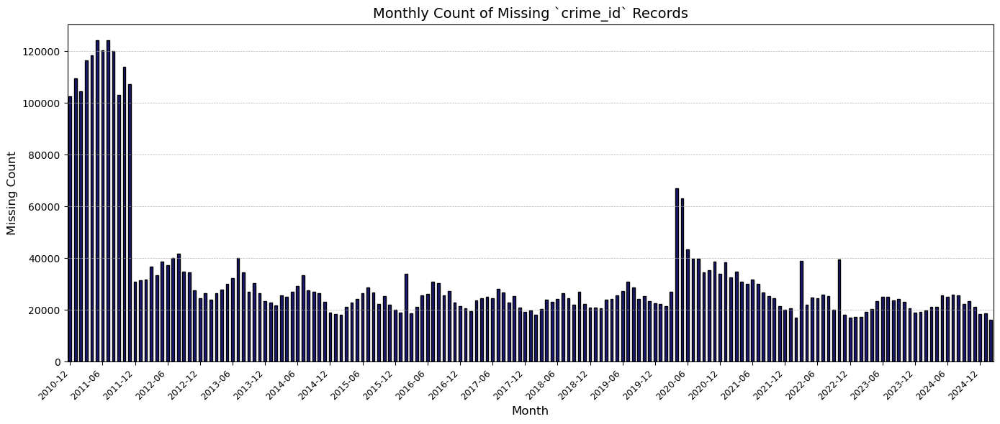

In [27]:
missing_df  = crime_cudf[crime_cudf["crime_id"].isnull()]
missing_counts = missing_df .groupby("month").size().sort_index()
missing_counts_pd = missing_counts.to_pandas()


plt.figure(figsize=(14, 6))
missing_counts_pd.plot(kind='bar', color='midnightblue', edgecolor='black')

plt.title("Monthly Count of Missing `crime_id` Records", fontsize=14)
plt.xlabel("Month", fontsize=12)
plt.ylabel("Missing Count", fontsize=12)

# Improve X-axis readability
plt.xticks(ticks=range(0, len(missing_counts_pd), 6), 
           labels=missing_counts_pd.index[::6], 
           rotation=45, 
           ha='right', fontsize=9)

plt.grid(axis='y', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

I was half right, it seems it got implemented in 2011. Interestingly, we can see a periodic missing data pattern over the years (with spike at covid). Missingness is thus not MCAR. Main issue now is determining which of these missing crime_id are duplicates. lets look at the non-missing distribution of duplicate data (so same data when ignoring id)

In [28]:
# Split into two subsets
with_crime_id = crime_cudf[crime_cudf["crime_id"].notnull()]
without_crime_id = crime_cudf[crime_cudf["crime_id"].isnull()]

# Define groupby keys
group_keys = [
    'crime_type', 'latitude', 'longitude', 'lsoa_code',
    'lsoa_name', 'month', 'x', 'y'
]

# Count distribution for rows WITH crime_id
count_dist_with = (
    with_crime_id.groupby(group_keys)
    .size()
    .value_counts()
    .sort_index()
)

# Count distribution for rows WITHOUT crime_id
count_dist_without = (
    without_crime_id.groupby(group_keys)
    .size()
    .value_counts()
    .sort_index()
)

# Print them side by side
print("Count distribution WITH crime_id:\n", count_dist_with)
print("\nCount distribution WITHOUT crime_id:\n", count_dist_without)


Count distribution WITH crime_id:
 1      6672323
2      1036697
3       269708
4       100794
5        46890
        ...   
147          1
149          1
156          2
172          1
231          1
Name: count, Length: 131, dtype: int64

Count distribution WITHOUT crime_id:
 1      1893300
2       569898
3       218545
4       112488
5        59360
        ...   
155          1
159          1
175          1
201          1
211          1
Name: count, Length: 112, dtype: int64


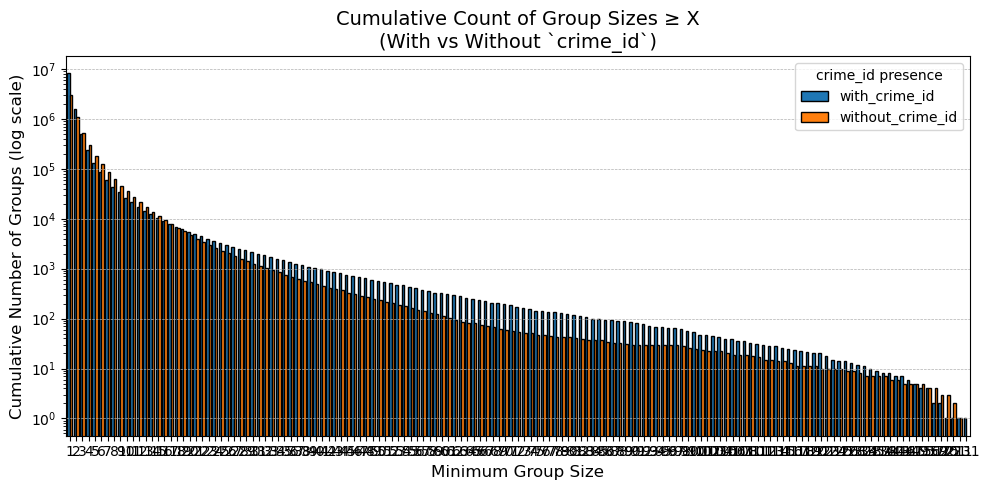

In [69]:
count_dist_with = count_dist_with.to_pandas()
count_dist_without = count_dist_without.to_pandas()
# Combine into a DataFrame for comparison
dist_df = pd.DataFrame({
    'with_crime_id': count_dist_with,
    'without_crime_id': count_dist_without
}).fillna(0)

# Compute cumulative counts
cumulative_df = dist_df.sort_index(ascending=False).cumsum().sort_index()

# Plot cumulative version
ax = cumulative_df.plot(
    kind='bar',
    figsize=(10, 5),
    width=0.8,
    edgecolor='black',
    color=['#1f77b4', '#ff7f0e']
)

plt.yscale("log")
plt.title("Cumulative Count of Group Sizes ≥ X\n(With vs Without `crime_id`)", fontsize=14)
plt.xlabel("Minimum Group Size", fontsize=12)
plt.ylabel("Cumulative Number of Groups (log scale)", fontsize=12)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', linewidth=0.5)
plt.legend(title="crime_id presence", fontsize=10)
plt.tight_layout()
plt.show()


# Conclusion missing crime_id data: 
Given the plot above, one can assume there are duplicates for the rows where crime_id is missing, but right now I can't think of a way of deduplicating with a missing crime_id. We need to take into account this artifact when reporting the quality of the data.

# Inspecting distribution of the data (crime types and spatial distribution)

I will first investigate the distribution of the crime type data, and the temporal range (because the crime types may not have been recorded (continously) over the entire temporal range). Moreover, I will look into both the distirbution of the data over time to inspect trends, and look at the spatial distribution.

A. distirbution of crime types in absolute numbers

In [72]:
gb_crime_type = crime_cudf.groupby('crime_type').size()
gb_crime_type

crime_type
Theft from the person            642652
Violence and sexual offences    2696252
Other crime                      546699
Bicycle theft                    247055
Possession of weapons             64013
Public disorder and weapons       54168
Burglary                        1095785
Vehicle crime                   1521512
Public order                     644208
Shoplifting                      698233
Other theft                     1780815
Anti-social behaviour           4397325
Violent crime                    352702
Robbery                          409591
Criminal damage and arson        880715
Drugs                            586181
dtype: int64

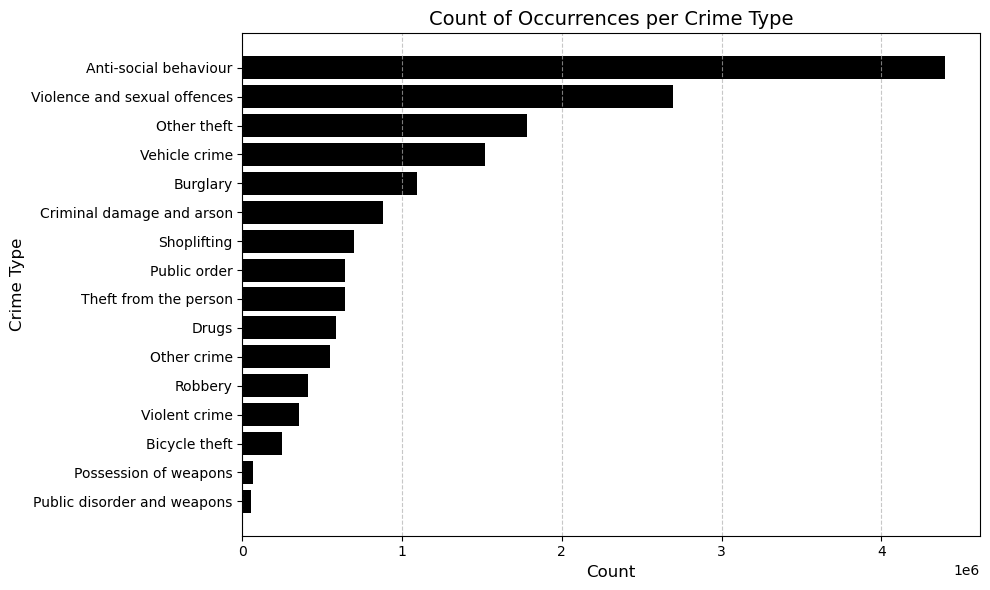

In [76]:
#plot
gb_crime_type_pd = gb_crime_type.to_pandas().sort_values(ascending=False)
plt.figure(figsize=(10, 6))
plt.barh(gb_crime_type_pd.index, gb_crime_type_pd.values, align='center', color='black')
plt.xlabel('Count', fontsize=12)
plt.ylabel('Crime Type', fontsize=12)
plt.title('Count of Occurrences per Crime Type', fontsize=14)
plt.gca().invert_yaxis()  
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()  
plt.show()

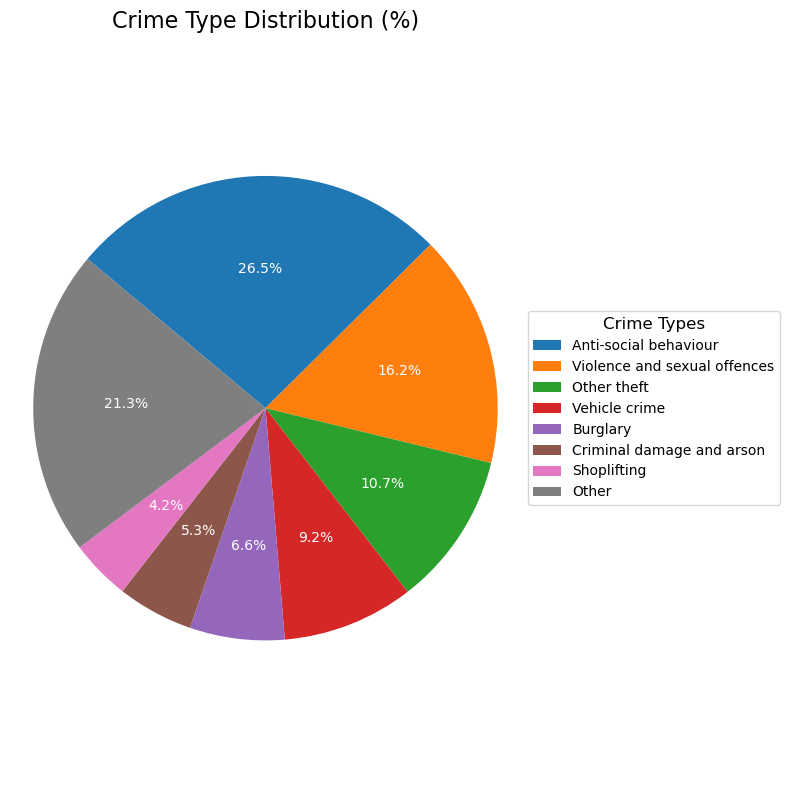

In [ ]:
# Collapse minor categories into 'Other' for visual clarity
cutoff = 0.04 # 5% cutoff, purely for visual purposes
threshold = cutoff* gb_crime_type_pd.sum()  
major = gb_crime_type_pd[gb_crime_type_pd >= threshold]
minor = gb_crime_type_pd[gb_crime_type_pd < threshold]
major['Other'] = minor.sum()

# Plot
plt.figure(figsize=(8, 8))
wedges, texts, autotexts = plt.pie(
    major.values,
    labels=None,  
    autopct='%1.1f%%',
    startangle=140,
    counterclock=False,
    textprops=dict(color="white", fontsize=10)
)

plt.title('Crime Type Distribution (%)', fontsize=16)
plt.legend(
    wedges,
    major.index,
    title="Crime Types",
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    fontsize=10,
    title_fontsize=12
)
plt.axis('equal')  
plt.tight_layout()
plt.show()

### A. Observation: 
Anti-social behaviour is the most represented crime_type with 26.5%, probably because of its lower threshold of committing this type of crime and its broad and general definition. Other major reported crime types are 'Violence and sexual offences' (16.2%), 'Other theft' (10.7%) and 'Vehicle crime' (9.2%). The other crime constitute a quite a small portion of the data individually.

# B. Temporal range

In [ ]:
#cnvert the montjh column from string (YYYY-MM) to datetime to better deal with temporal data
crime_cudf['month'] = cudf.to_datetime(crime_cudf['month'], format='%Y-%m')

# Compute the min and max dates for each crime type
min_dates = crime_cudf.groupby('crime_type')['month'].min()
max_dates = crime_cudf.groupby('crime_type')['month'].max()

# Calculate the difference in months
temporal_span_months = (max_dates.dt.year - min_dates.dt.year) * 12 + (max_dates.dt.month - min_dates.dt.month)
print(temporal_span_months)


crime_type
Theft from the person           141
Violence and sexual offences    141
Other crime                     170
Bicycle theft                   141
Possession of weapons           141
Public disorder and weapons      19
Burglary                        170
Vehicle crime                   170
Public order                    141
Shoplifting                     161
Other theft                     161
Anti-social behaviour           170
Violent crime                    28
Robbery                         170
Criminal damage and arson       161
Drugs                           161
Name: month, dtype: int16


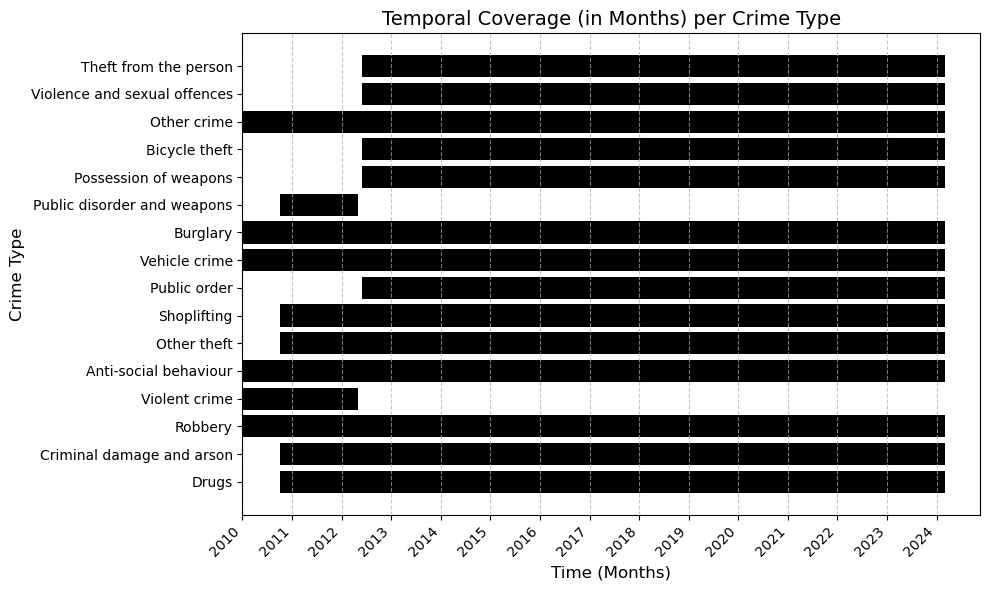

In [85]:
df_range = crime_cudf.groupby('crime_type').agg({'month': ['min', 'max']}).to_pandas()
df_range.columns = ['min_month', 'max_month']
df_range['min_month'] = pd.to_datetime(df_range['min_month'])
df_range['max_month'] = pd.to_datetime(df_range['max_month'])
df_range['span_months'] = (
    (df_range['max_month'].dt.year - df_range['min_month'].dt.year) * 12
    + (df_range['max_month'].dt.month - df_range['min_month'].dt.month)
)

# Numeric representation of the earliest month: year*12 + month
df_range['bottom_month_num'] = df_range['min_month'].apply(lambda x: x.year * 12 + x.month)

#plot
fig, ax = plt.subplots(figsize=(10, 6))

bars = ax.barh(
    y=df_range.index,
    width=df_range['span_months'],
    left=df_range['bottom_month_num'],
    color='black',
    align='center'
)

ax.invert_yaxis()
ax.set_xlabel('Time (Months)', fontsize=12)
ax.set_ylabel('Crime Type', fontsize=12)
ax.set_title('Temporal Coverage (in Months) per Crime Type', fontsize=14)

def monthnum_to_ym(month_num):
    """Convert numeric month (year*12 + month) back to 'YYYY-MM'."""
    year = (month_num - 1) // 12
    month = (month_num - 1) % 12 + 1
    return f"{year:04d}"

xmin, xmax = ax.get_xlim()
tick_step = 12  # one tick per year, adjust as needed
tick_positions = range(int(xmin), int(xmax) + 1, tick_step)
tick_labels = [monthnum_to_ym(tp) for tp in tick_positions]

ax.set_xticks(list(tick_positions))
ax.set_xticklabels(tick_labels, rotation=45, ha='right')

ax.grid(axis='x', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


# B: Observation
Since we are interested in data from 2011 onwards, quite a few crime types are not relevant for our analysis a priori. The most frequent crimes (see A.) are all well represented in the temporal range.

# C: Spatial distribution
First plot all the data of london over the entire timespan in one image

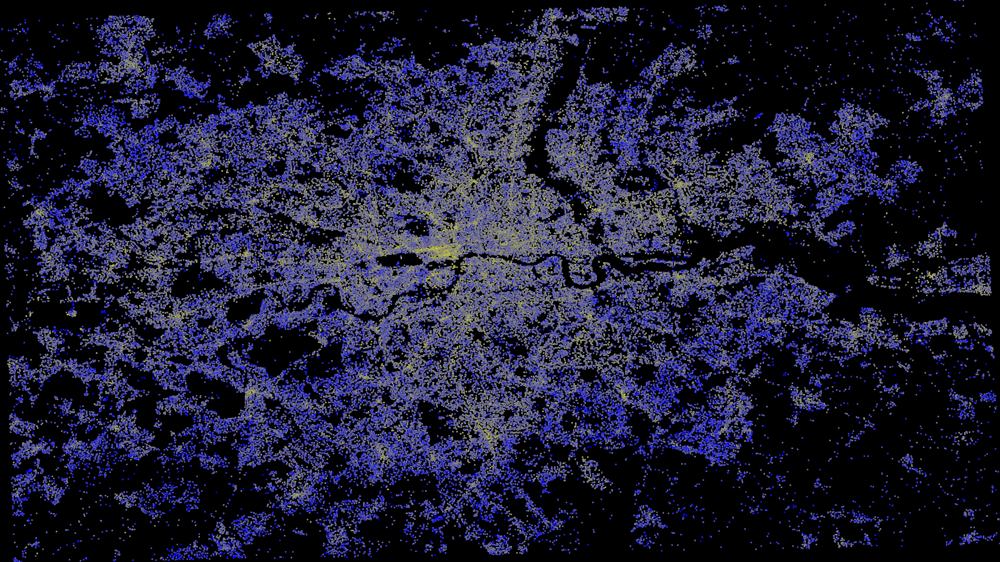

In [94]:
CRIME_PLOT_DIR = PLOT_DIR / 'crime_distribution'

# Define the canvas resolution and spatial extents based on your data
def setup_canvas(crime_cudf, scale_hd=1, ck = False):
    x_min = crime_cudf['x'].min().item()
    x_max = crime_cudf['x'].max().item()
    y_min = crime_cudf['y'].min().item()
    y_max = crime_cudf['y'].max().item()

    canvas = ds.Canvas(plot_width=int(1920 *  (1/scale_hd)), plot_height=int(1080*(1/scale_hd)),
                    x_range=(x_min, x_max),
                    y_range=(y_min, y_max))
    
    agg = canvas.points(crime_cudf, 'x', 'y')

    # Convert to categorical for per-crime-type aggregation
    if ck:
        if crime_cudf['crime_type'].dtype != 'category':
            crime_cudf['crime_type'] = crime_cudf['crime_type'].astype('category')

        agg = canvas.points(crime_cudf, 'x', 'y', agg=ds.count_cat('crime_type'))
    return canvas, agg

scale_hd = 1
canvas, agg = setup_canvas(crime_cudf, scale_hd, False)

low_colour = "blue"
high_colour = "yellow"
# Shade the aggregated image with a color map, spread to improve point visibility
img = tf.shade(agg, cmap=[low_colour, high_colour], 
               how='log',
               min_alpha=100,
               span=[1, 54000])
img = tf.dynspread(img, threshold=0.94, max_px=4)
img = tf.set_background(img, 'black')
img_path = CRIME_PLOT_DIR / f'crime_distribution_{low_colour}_{high_colour}_aggr_ushd.png'
img.to_pil().save(img_path)
display(img.to_pil())

In [89]:
!!pip install matplotlib-scalebar


['Collecting matplotlib-scalebar',
 '  Downloading matplotlib_scalebar-0.9.0-py3-none-any.whl.metadata (18 kB)',
 'Requirement already satisfied: matplotlib in /home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages (from matplotlib-scalebar) (3.10.1)',
 'Requirement already satisfied: contourpy>=1.0.1 in /home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages (from matplotlib->matplotlib-scalebar) (1.3.1)',
 'Requirement already satisfied: cycler>=0.10 in /home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages (from matplotlib->matplotlib-scalebar) (0.12.1)',
 'Requirement already satisfied: fonttools>=4.22.0 in /home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages (from matplotlib->matplotlib-scalebar) (4.56.0)',
 'Requirement already satisfied: kiwisolver>=1.3.1 in /home/ajruben/miniforge3/envs/rapids-25.02/lib/python3.11/site-packages (from matplotlib->matplotlib-scalebar) (1.4.7)',
 'Requirement already satisfied: n

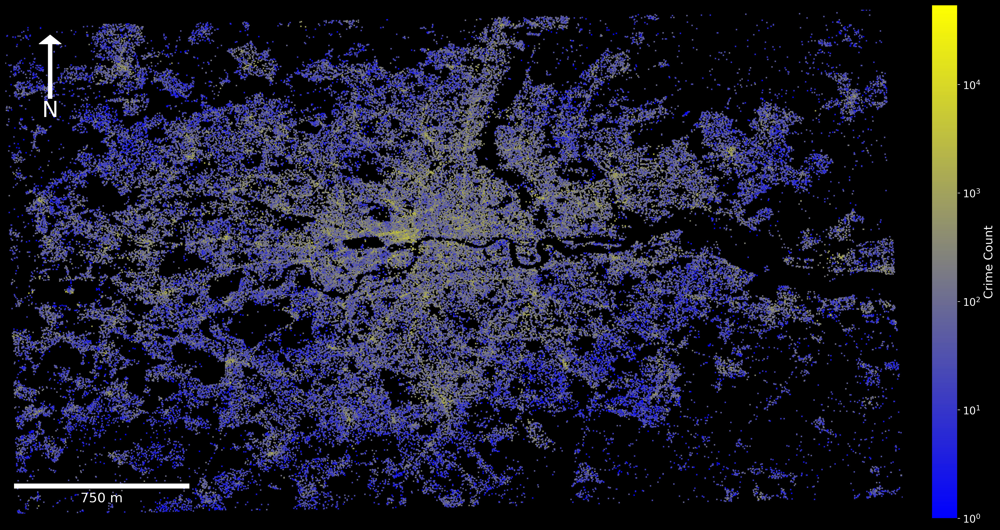

In [129]:
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.cm import ScalarMappable
from matplotlib.colors import LogNorm, LinearSegmentedColormap
from matplotlib.font_manager import FontProperties

img_pil = img.to_pil()
width, height = img_pil.size

fig, ax = plt.subplots(figsize=(width / 100, height / 100), dpi=200)

ax.imshow(img_pil)
ax.axis('off')

fontprops = FontProperties(size=14)
scalebar = ScaleBar(2, units='m', location='lower left', box_alpha=0,
                    color='white', scale_loc='bottom', border_pad=1, font_properties={'size': 18})
ax.add_artist(scalebar)

#North arrow (bottom left 
ax.annotate('N',
            xy=(0.05, 0.95),     # Tip of arrow (higher y = closer to top)
            xytext=(0.05, 0.80), # Base of arrow (slightly below tip)
            xycoords='axes fraction',
            arrowprops=dict(facecolor='white', edgecolor='white',
                            width=2 * arrow_scale, headwidth=12 * arrow_scale),
            ha='center', va='center',
            fontsize=int(12 * arrow_scale), color='white')

# === Colorbar (horizontal, bottom) ===
cmap = LinearSegmentedColormap.from_list("crime_map", [low_colour, high_colour])
norm = LogNorm(vmin=1, vmax=54000)
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Add colorbar below the image
cbar = fig.colorbar(sm, ax=ax, orientation='vertical', fraction=0.05, pad=0.03)
cbar.set_label('Crime Count', color='white', fontsize=16)
cbar.ax.tick_params(color='white', labelcolor='white', labelsize=14)

# === Final tweaks ===
fig.patch.set_facecolor('black')  # Background if saving transparent
plt.subplots_adjust(left=0.02, right=0.98, top=0.98, bottom=0.08)

# Save
final_path = CRIME_PLOT_DIR / f'crime_distribution_layout_cleaned.png'
plt.savefig(final_path, bbox_inches='tight', pad_inches=0.2, facecolor='black')
plt.show()


Colour the crimetypes

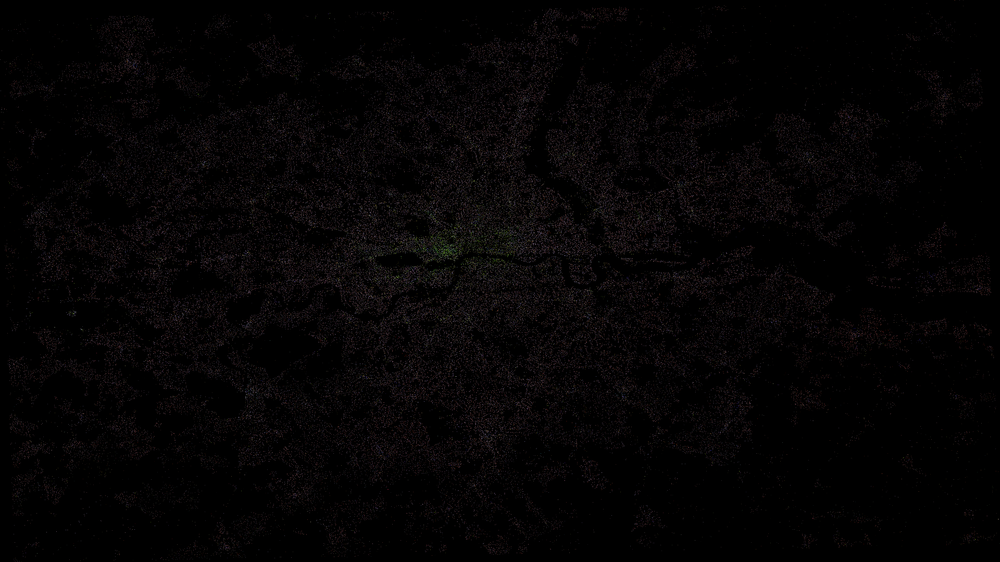

In [206]:
scale_hd = 1.0
canvas, agg = setup_canvas(crime_cudf, scale_hd, True)

# Build color key
unique_crimes = crime_cudf['crime_type'].dropna().unique().to_arrow().to_pylist()
color_key = dict(zip(unique_crimes, glasbey[:len(unique_crimes)]))

img = tf.shade(agg, color_key=color_key, how='log', min_alpha=10)
img = tf.dynspread(img, threshold=0.4, max_px=4)
img = tf.set_background(img, 'black')

# Save
img_path = CRIME_PLOT_DIR / 'crime_type_distribution_log_spread_ck.png'
img.to_pil().save(img_path)

# Show
display(img.to_pil())


# TODO
### continue plotting here, and also over range (line plots)

In [ ]:

# === Step 1: Generate Datashader Image for Points ===
# Determine spatial extents from your cuDF DataFrame
x_min = cudf_df['x'].min().item()
x_max = cudf_df['x'].max().item()
y_min = cudf_df['y'].min().item()
y_max = cudf_df['y'].max().item()

# Create a 1920x1080 canvas
canvas = raster.Canvas(
    plot_width=1920,
    plot_height=1080,
    x_range=(x_min, x_max),
    y_range=(y_min, y_max)
)

# Aggregate the points (GPU-accelerated with cuDF)
agg = canvas.points(cudf_df, 'x', 'y')

# Shade using a log transform and dynamic spreading
img = tf.shade(agg, cmap=["red", "yellow"], how='log')
img = tf.dynspread(img, threshold=0.5, max_px=2)
raster_pil = img.to_pil()

# === Step 2: Render the Borough Polygons with Transparent Fill, White Lines & Labels ===
# Load borough polygons and reproject to EPSG:4326 (assuming points use this CRS)
boroughs = gpd.read_file(
    r'/mnt/c/Users/Ruben/Documents/Project_crime/data/London_Boroughs.gpkg',
    layer='london_boroughs'
)
boroughs = boroughs.to_crs(epsg=4326)

# Create a matplotlib figure with the same resolution as the datashader image
fig, ax = plt.subplots(figsize=(1920/100, 1080/100), dpi=100)
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axis('off')  # Remove axes for a clean map

# Plot polygons with no fill (transparent) and white outlines
boroughs.plot(
    ax=ax,
    facecolor="none",      # transparent fill
    edgecolor="white",     # white borders
    linewidth=0.9,
    alpha=0.4
)



# Save the polygon (with labels) layer to an in-memory buffer
buf = io.BytesIO()
plt.savefig(buf, format="png", bbox_inches="tight", pad_inches=0, transparent=True)
plt.close(fig)
buf.seek(0)
polygon_img = Image.open(buf)
polygon_img = polygon_img.resize(ds_pil.size)

# === Step 3: Composite the Two Layers ===
# Overlay the polygon layer (with labels and white boundaries) on top of the datashader image
composite = Image.alpha_composite(ds_pil.convert("RGBA"), polygon_img.convert("RGBA"))
composite.save("crime_vertices.png")


In [ ]:


# Load borough polygons and reproject to EPSG:4326
boroughs = gpd.read_file(
    r'/mnt/c/Users/Ruben/Documents/Project_crime/data/London_Boroughs.gpkg',
    layer='london_boroughs'
)
boroughs = boroughs.to_crs(epsg=4326)

# Determine spatial extent of the polygons
poly_minx, poly_miny, poly_maxx, poly_maxy = boroughs.total_bounds

# Create a figure sized for 1920x1080 (16:9)
fig, ax = plt.subplots(figsize=(1920/100, 1080/100), dpi=100)
ax.set_xlim(poly_minx, poly_maxx)
ax.set_ylim(poly_miny, poly_maxy)
ax.set_aspect('equal')
ax.axis('off')  # Remove axes for a clean map

# Plot boroughs with a slightly grey fill and white outlines
boroughs.plot(
    ax=ax,
    facecolor="#555555",  # slightly grey fill
    edgecolor="white",    # white boundaries
    linewidth=1.0,
    alpha=0.9             # nearly opaque fill
)

# Calculate centroids for label placement
boroughs["centroid"] = boroughs.geometry.centroid

# Add labels for each polygon using the 'name' column
for idx, row in boroughs.iterrows():
    cx, cy = row["centroid"].x, row["centroid"].y
    label = row["name"]
    ax.text(
        cx, cy, label,
        fontsize=10, color="white",
        ha="center", va="center", wrap=True
    )

# Adjust the subplot to use the full figure area
fig.subplots_adjust(left=0, right=1, top=1, bottom=0)

# Save the figure with a black background so it fits perfectly on a slide
plt.savefig(
    "boroughs_labeled_only_1920x1080.png",
    dpi=100,
    facecolor="black"  # sets the figure background to black
)
plt.close(fig)


/tmp/ipykernel_20626/247484634.py:31: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  boroughs["centroid"] = boroughs.geometry.centroid


# gif

In [ ]:


# Extract x, y coordinates
gdf['x'] = gdf.geometry.x
gdf['y'] = gdf.geometry.y

# (Optional) Format 'Month' as string "YYYY-MM" if needed:
# gdf['Month'] = gdf['Month'].dt.strftime('%Y-%m')

# Create a cuDF DataFrame from the pandas GeoDataFrame
cudf_df_all = cudf.DataFrame.from_pandas(gdf[['x', 'y', 'Month']])

# Determine overall spatial extent to keep the canvas consistent
x_min = cudf_df_all['x'].min().item()
x_max = cudf_df_all['x'].max().item()
y_min = cudf_df_all['y'].min().item()
y_max = cudf_df_all['y'].max().item()

# Get a sorted list of unique months (as strings)
months = sorted(cudf_df_all['Month'].unique().to_pandas().tolist())

# --- Generate Frames ---
frames = []
plot_width, plot_height = 1920, 1080  # Resolution

for m in months:  # Assuming 'months' is defined elsewhere
    month_df = cudf_df_all[cudf_df_all['Month'] == m]  # Assuming 'cudf_df_all' is a CuDF DataFrame
    
    # Datashader canvas and aggregation
    canvas = ds.Canvas(
        plot_width=plot_width, plot_height=plot_height,
        x_range=(x_min, x_max), y_range=(y_min, y_max)  # Assuming ranges are defined
    )
    agg = canvas.points(month_df, 'x', 'y')
    img = tf.shade(agg, cmap=["red", "yellow"])#, how='log')
    img = tf.dynspread(img, threshold=0.5, max_px=2)
    
    # Convert to PIL and composite with black background
    ds_pil = img.to_pil()
    background = Image.new("RGBA", (plot_width, plot_height), "black")
    combined = Image.alpha_composite(background, ds_pil.convert("RGBA"))
    draw = ImageDraw.Draw(combined)

    # --- Font Configuration ---
    try:
        title_font = ImageFont.truetype("arial.TTF", 40)  # Improved size
        month_font = ImageFont.truetype("arial.TTF", 50)  # Improved size
        label_font = ImageFont.truetype("arial.TTF", 30)   # Improved size
    except IOError:
        try:
            title_font = ImageFont.truetype("DejaVuSans-Bold", 30)
            month_font = ImageFont.truetype("DejaVuSans-Bold", 50)
            label_font = ImageFont.truetype("DejaVuSans-Bold", 20)
        except IOError:
            title_font = month_font = label_font = ImageFont.load_default()

    # --- Title with Background ---
    title_text = "Crime Data in London, all crime reported on the street, Dec 2013 - Jan 2025"
    title_bbox = draw.textbbox((0, 0), title_text, font=title_font)
    title_width = title_bbox[2] - title_bbox[0]
    title_height = title_bbox[3] - title_bbox[1]
    title_left = (plot_width - title_width) // 2
    title_top = 30
    draw.rectangle([title_left, title_top, title_left + title_width, title_top + title_height], fill="black")
    draw.text((title_left, title_top), title_text, fill="white", font=title_font, 
              stroke_width=4, stroke_fill="black")

    # --- Month Label with Background ---
    month_text = m
    month_bbox = draw.textbbox((0, 0), month_text, font=month_font)
    month_width = month_bbox[2] - month_bbox[0]
    month_height = month_bbox[3] - month_bbox[1]
    month_left = plot_width - month_width - 100
    month_top = plot_height - 160  # Adjusted for larger font
    draw.rectangle([month_left, month_top, month_left + month_width, month_top + month_height], fill="black")
    draw.text((month_left, month_top), month_text, fill="white", font=month_font, 
              stroke_width=4, stroke_fill="black")

    # --- Colorbar ---
    bar_width, bar_height = 24, 400
    bar_margin = 30
    colorbar = Image.new("RGB", (bar_width, bar_height), "black")
    bar_draw = ImageDraw.Draw(colorbar)
    for i in range(bar_height):
        ratio = i / (bar_height - 1)
        r, g, b = 255, int(ratio * 255), 0
        bar_draw.line([(0, bar_height - 1 - i), (bar_width, bar_height - 1 - i)], fill=(r, g, b))
    combined.paste(colorbar, (plot_width - bar_width - bar_margin, 150))

    # --- Colorbar Labels with Background ---
    # High label
    high_text = "High"
    high_bbox = draw.textbbox((0, 0), high_text, font=label_font)
    high_width = high_bbox[2] - high_bbox[0]
    high_height = high_bbox[3] - high_bbox[1]
    high_left = plot_width - bar_width - bar_margin - high_width - 30
    high_top = 140
    draw.rectangle([high_left, high_top, high_left + high_width, high_top + high_height], fill="black")
    draw.text((high_left, high_top), high_text, fill="white", font=label_font, 
              stroke_width=4, stroke_fill="black")

    # Low label
    low_text = "Low"
    low_bbox = draw.textbbox((0, 0), low_text, font=label_font)
    low_width = low_bbox[2] - low_bbox[0]
    low_height = low_bbox[3] - low_bbox[1]
    low_left = plot_width - bar_width - bar_margin - low_width - 30
    low_top = 150 + bar_height - low_height
    draw.rectangle([low_left, low_top, low_left + low_width, low_top + low_height], fill="black")
    draw.text((low_left, low_top), low_text, fill="white", font=label_font, 
              stroke_width=4, stroke_fill="black")

    # --- North Arrow ---
    # Define arrow coordinates
    arrow_start = (80, 230)
    arrow_end = (80, 120)

    # Define arrowhead parameters
    arrowhead_height = 34
    arrowhead_base_y = arrow_end[1] + arrowhead_height  # 120 + 24 = 144
    shaft_end = (arrow_end[0], arrowhead_base_y)  # (80, 144)

    # Draw the shaft
    draw.line([arrow_start, shaft_end], fill="white", width=12)

    # Draw the arrowhead
    arrowhead = [
        (arrow_end[0] - 12, arrowhead_base_y),  # (80 - 12, 144) = (68, 144)
        (arrow_end[0] + 12, arrowhead_base_y),  # (80 + 12, 144) = (92, 144)
        arrow_end                               # (80, 120)
    ]
    draw.polygon(arrowhead, fill="white")

    # Draw "N" with background
    n_text = "N"
    n_font = ImageFont.truetype("DejaVuSans-Bold", 35)
    n_bbox = draw.textbbox((0, 0), n_text, font=n_font)
    n_width = n_bbox[2] - n_bbox[0]
    n_height = n_bbox[3] - n_bbox[1]
    n_left = arrow_end[0] - 15              # 80 - 35 = 45
    n_top = arrow_end[1] - 70               # 120 - 70 = 50

    # Draw black background rectangle for "N"
    draw.rectangle([n_left, n_top, n_left + n_width, n_top + n_height], fill="black")

    # Draw "N" text
    draw.text(
        (n_left, n_top),
        n_text,
        fill="white",
        font=n_font,
        stroke_width=4,
        stroke_fill="black"
    )

    frames.append(combined)

# --- Save GIF ---
gif_filename = "crime_points_evolution.gif"
imageio.mimsave(gif_filename, frames, duration=1)
print(f"Saved GIF as {gif_filename}")

Saved GIF as crime_points_evolution.gif


In [ ]:


# Load your GeoDataFrame (assuming 'gdf' is already loaded with 'geometry', 'Month', 'Crime type')
# Extract x, y coordinates
gdf['x'] = gdf.geometry.x
gdf['y'] = gdf.geometry.y

# Ensure 'Crime type' is included in the cuDF DataFrame
cudf_df_all = cudf.DataFrame.from_pandas(gdf[['x', 'y', 'Month', 'Crime type']])

# Determine overall spatial extent for consistency across all GIFs
x_min = cudf_df_all['x'].min().item()
x_max = cudf_df_all['x'].max().item()
y_min = cudf_df_all['y'].min().item()
y_max = cudf_df_all['y'].max().item()

# Get sorted unique months
months = sorted(cudf_df_all['Month'].unique().to_pandas().tolist())

# Define canvas parameters
plot_width, plot_height = 1920, 1080
canvas = ds.Canvas(plot_width=plot_width, plot_height=plot_height, x_range=(x_min, x_max), y_range=(y_min, y_max))

# Font configuration (consistent across all GIFs)
try:
    title_font = ImageFont.truetype("arial.TTF", 40)
    month_font = ImageFont.truetype("arial.TTF", 50)
    label_font = ImageFont.truetype("arial.TTF", 30)
except IOError:
    try:
        title_font = ImageFont.truetype("DejaVuSans-Bold", 30)
        month_font = ImageFont.truetype("DejaVuSans-Bold", 50)
        label_font = ImageFont.truetype("DejaVuSans-Bold", 20)
    except IOError:
        title_font = month_font = label_font = ImageFont.load_default()

# --- 2. GIFs for Specific Crime Types ---

crime_types = ['Anti-social behaviour', 'Violent crime', 'Robbery', 'Burglary']

for crime_type in crime_types:
    # Filter data
    crime_df = cudf_df_all[cudf_df_all['Crime type'] == crime_type]
    if crime_df.empty:
        print(f"No data for crime type: {crime_type}, skipping GIF creation.")
        continue
    months_crime = sorted(crime_df['Month'].unique().to_pandas().tolist())
    
    # Generate frames
    frames_crime = []
    for m in months_crime:
        month_df = crime_df[crime_df['Month'] == m]
        agg = canvas.points(month_df, 'x', 'y')
        img = tf.shade(agg, cmap=["red", "yellow"])  # Log scale can be added with how='log' if needed
        img = tf.dynspread(img, threshold=0.5, max_px=2)
        
        # Convert to PIL
        ds_pil = img.to_pil()
        background = Image.new("RGBA", (plot_width, plot_height), "black")
        combined = Image.alpha_composite(background, ds_pil.convert("RGBA"))
        draw = ImageDraw.Draw(combined)
        
        # Title
        title_text = f"{crime_type} in London, Dec 2013 - Jan 2025"
        title_bbox = draw.textbbox((0, 0), title_text, font=title_font)
        title_width = title_bbox[2] - title_bbox[0]
        title_height = title_bbox[3] - title_bbox[1]
        title_left = (plot_width - title_width) // 2
        title_top = 30
        draw.rectangle([title_left, title_top, title_left + title_width, title_top + title_height], fill="black")
        draw.text((title_left, title_top), title_text, fill="white", font=title_font, stroke_width=4, stroke_fill="black")
        
        # Month label
        month_text = m
        month_bbox = draw.textbbox((0, 0), month_text, font=month_font)
        month_width = month_bbox[2] - month_bbox[0]
        month_height = month_bbox[3] - month_bbox[1]
        month_left = plot_width - month_width - 100
        month_top = plot_height - 160
        draw.rectangle([month_left, month_top, month_left + month_width, month_top + month_height], fill="black")
        draw.text((month_left, month_top), month_text, fill="white", font=month_font, stroke_width=4, stroke_fill="black")
        
        # Colorbar
        bar_width, bar_height = 24, 400
        bar_margin = 30
        colorbar = Image.new("RGB", (bar_width, bar_height), "black")
        bar_draw = ImageDraw.Draw(colorbar)
        for i in range(bar_height):
            ratio = i / (bar_height - 1)
            r, g, b = 255, int(ratio * 255), 0
            bar_draw.line([(0, bar_height - 1 - i), (bar_width, bar_height - 1 - i)], fill=(r, g, b))
        combined.paste(colorbar, (plot_width - bar_width - bar_margin, 150))
        
        # Colorbar labels
        high_text = "High"
        high_bbox = draw.textbbox((0, 0), high_text, font=label_font)
        high_width = high_bbox[2] - high_bbox[0]
        high_height = high_bbox[3] - high_bbox[1]
        high_left = plot_width - bar_width - bar_margin - high_width - 30
        high_top = 140
        draw.rectangle([high_left, high_top, high_left + high_width, high_top + high_height], fill="black")
        draw.text((high_left, high_top), high_text, fill="white", font=label_font, stroke_width=4, stroke_fill="black")
        
        low_text = "Low"
        low_bbox = draw.textbbox((0, 0), low_text, font=label_font)
        low_width = low_bbox[2] - low_bbox[0]
        low_height = low_bbox[3] - low_bbox[1]
        low_left = plot_width - bar_width - bar_margin - low_width - 30
        low_top = 150 + bar_height - low_height
        draw.rectangle([low_left, low_top, low_left + low_width, low_top + low_height], fill="black")
        draw.text((low_left, low_top), low_text, fill="white", font=label_font, stroke_width=4, stroke_fill="black")
        
        # North Arrow
        arrow_start = (80, 230)
        arrow_end = (80, 120)
        arrowhead_height = 34
        arrowhead_base_y = arrow_end[1] + arrowhead_height
        shaft_end = (arrow_end[0], arrowhead_base_y)
        draw.line([arrow_start, shaft_end], fill="white", width=12)
        arrowhead = [
            (arrow_end[0] - 12, arrowhead_base_y),
            (arrow_end[0] + 12, arrowhead_base_y),
            arrow_end
        ]
        draw.polygon(arrowhead, fill="white")
        
        n_text = "N"
        n_font = ImageFont.truetype("DejaVuSans-Bold", 35)
        n_bbox = draw.textbbox((0, 0), n_text, font=n_font)
        n_width = n_bbox[2] - n_bbox[0]
        n_height = n_bbox[3] - n_bbox[1]
        n_left = arrow_end[0] - 15
        n_top = arrow_end[1] - 70
        draw.rectangle([n_left, n_top, n_left + n_width, n_top + n_height], fill="black")
        draw.text((n_left, n_top), n_text, fill="white", font=n_font, stroke_width=4, stroke_fill="black")
        
        # Append to the correct list
        frames_crime.append(combined)
    
    # Save GIF only if there are frames
    filename = f"{crime_type.replace(' ', '_').lower()}_evolution.gif"
    if frames_crime:
        imageio.mimsave(filename, frames_crime, duration=1)
        print(f"Saved GIF as {filename}")
    else:
        print(f"No frames for {crime_type}, skipping GIF creation.")

Saved GIF as anti-social_behaviour_evolution.gif
Saved GIF as violent_crime_evolution.gif
Saved GIF as robbery_evolution.gif
Saved GIF as burglary_evolution.gif


# Chloropleth gif

In [ ]:


# ---------------------------
# 1. LOAD & PREPARE DATA
# ---------------------------

# 1.3. Spatial join - attach borough names to each crime record
joined = gpd.sjoin(
    gdf[['geometry', 'Month', 'Crime type']], 
    boroughs[['borough', 'geometry']],  # 'boroughs' should have a column named 'borough'
    how='left', 
    predicate='within'
)

# 1.4. Convert to cuDF for GPU-accelerated grouping
df = joined[['borough', 'Month', 'Crime type']].dropna(subset=['borough'])
cudf_df = cudf.DataFrame.from_pandas(df)
cudf_df['Month'] = pd.to_datetime(cudf_df['Month'].to_pandas())

# 1.5. Precompute aggregated counts (All Crime Types + Specific Types)
grouped_all = cudf_df.groupby(['borough', 'Month']).size().reset_index(name='average_crime_count_all')

crime_types = ['Anti-social behaviour', 'Violent crime', 'Robbery', 'Burglary']
grouped_by_type = {}
for ctype in crime_types:
    subset = cudf_df[cudf_df['Crime type'] == ctype]
    grouped = subset.groupby(['borough', 'Month']).size().reset_index(name='average_crime_count')
    grouped_by_type[ctype] = grouped

# Convert them back to pandas for easier merging/plotting
grouped_all_pd = grouped_all.to_pandas()
grouped_type_pd = {ctype: dfc.to_pandas() for ctype, dfc in grouped_by_type.items()}

# ---------------------------
# 2. SETUP FOR GIF CREATION
# ---------------------------

# 2.1. Unique months across the entire data
all_months = sorted(grouped_all_pd['Month'].unique())

# 2.2. Create a custom color map from red -> yellow (to match your DS colorbar)
red_to_yellow = mcolors.LinearSegmentedColormap.from_list(
    "red_to_yellow", [(1, 0, 0), (1, 1, 0)]
)

# 2.3. Font configuration
try:
    title_font = ImageFont.truetype("arial.TTF", 40)
    month_font = ImageFont.truetype("arial.TTF", 50)
    label_font = ImageFont.truetype("arial.TTF", 30)
except IOError:
    # Fallback(s)
    try:
        title_font = ImageFont.truetype("DejaVuSans-Bold", 30)
        month_font = ImageFont.truetype("DejaVuSans-Bold", 50)
        label_font = ImageFont.truetype("DejaVuSans-Bold", 20)
    except IOError:
        title_font = month_font = label_font = ImageFont.load_default()

# 2.4. For consistent layout, define canvas dimensions (similar to your DS approach)
plot_width, plot_height = 1920, 1080
DPI = 100  # so figure size in inches => (19.2, 10.8)

def global_vmin_vmax(count_df, colname='average_crime_count'):
    """Find global min and max for a column of aggregated crime counts."""
    vmin = count_df[colname].min()
    vmax = count_df[colname].max()
    return (vmin, vmax)

# ---------------------------
# 3. CHOROPLETH FRAME CREATION
# ---------------------------

def create_choropleth_frame(
    boroughs_gdf, 
    monthly_df, 
    month, 
    crime_label,
    vmin, 
    vmax, 
    title_text
):
    """
    Plot a single-month choropleth onto a Matplotlib figure sized 1920x1080,
    then composite with a black background. Lastly, annotate with text, arrow, etc.
    Returns a PIL Image object (RGBA).
    """
    # 3.1. Merge monthly data with borough polygons
    merged = boroughs_gdf.merge(monthly_df[monthly_df['Month'] == month],
                                on='borough', how='left')

    # 3.2. Create a figure exactly 1920×1080 in size
    fig, ax = plt.subplots(
        figsize=(plot_width / DPI, plot_height / DPI),
        dpi=DPI
    )
    # Remove margins so final PNG is 1920x1080 exactly
    plt.subplots_adjust(left=0, right=1, bottom=0, top=1)
    ax.set_facecolor((0, 0, 0, 0))
    ax.axis('off')
    
    # 3.3. Plot the polygons as a choropleth
    merged.plot(
        column='average_crime_count',
        ax=ax,
        cmap=red_to_yellow,
        edgecolor='black',
        linewidth=0.5,
        vmin=vmin,
        vmax=vmax
    )
    
    # 3.4. Render to PNG in memory (no 'tight' bounding box => exact 1920×1080)
    buf = io.BytesIO()
    plt.savefig(buf, format='png', transparent=True)
    plt.close(fig)
    buf.seek(0)

    # 3.5. Open as PIL (RGBA)
    map_image = Image.open(buf).convert("RGBA")

    # 3.6. Composite onto black background (1920×1080)
    background = Image.new("RGBA", (plot_width, plot_height), "black")
    # At this point, map_image should also be 1920×1080 => no mismatch
    if map_image.size != (plot_width, plot_height):
        raise ValueError(
            f"Map image size {map_image.size} != background {plot_width, plot_height}. "
            "Check figure sizing or bounding box settings."
        )
    combined = Image.alpha_composite(background, map_image)
    draw = ImageDraw.Draw(combined)

    # -------------------------------------------
    # 3.7. ANNOTATIONS (TITLE, MONTH, COLORBAR, NORTH ARROW)
    # -------------------------------------------

    # TITLE
    title_bbox = draw.textbbox((0, 0), title_text, font=title_font)
    title_width = title_bbox[2] - title_bbox[0]
    title_height = title_bbox[3] - title_bbox[1]
    title_left = (plot_width - title_width) // 2
    title_top = 30
    draw.rectangle([title_left, title_top, title_left + title_width, title_top + title_height],
                   fill="black")
    draw.text((title_left, title_top), title_text,
              fill="white", font=title_font, stroke_width=4, stroke_fill="black")

    # MONTH LABEL (bottom-right)
    month_str = month.strftime('%Y-%m')
    month_bbox = draw.textbbox((0, 0), month_str, font=month_font)
    month_width = month_bbox[2] - month_bbox[0]
    month_height = month_bbox[3] - month_bbox[1]
    month_left = plot_width - month_width - 100
    month_top = plot_height - 160
    draw.rectangle([month_left, month_top, month_left + month_width, month_top + month_height],
                   fill="black")
    draw.text((month_left, month_top), month_str,
              fill="white", font=month_font, stroke_width=4, stroke_fill="black")

    # COLORBAR (red->yellow gradient, with 'Low'/'High')
    bar_width, bar_height = 24, 400
    bar_margin = 30
    colorbar = Image.new("RGB", (bar_width, bar_height), "black")
    bar_draw = ImageDraw.Draw(colorbar)
    
    for i in range(bar_height):
        ratio = i / (bar_height - 1)
        # red at top => i=0 => ratio=0 => (255,0,0)
        # yellow at bottom => i=bar_height => ratio=1 => (255,255,0)
        # 'High' at top, 'Low' at bottom => invert index
        r, g, b = (255, int(ratio * 255), 0)
        bar_draw.line(
            [(0, bar_height - 1 - i), (bar_width, bar_height - 1 - i)],
            fill=(r, g, b)
        )
    combined.paste(colorbar, (plot_width - bar_width - bar_margin, 150))

    # "High" label
    high_text = "High"
    high_bbox = draw.textbbox((0, 0), high_text, font=label_font)
    high_width = high_bbox[2] - high_bbox[0]
    high_height = high_bbox[3] - high_bbox[1]
    high_left = plot_width - bar_width - bar_margin - high_width - 30
    high_top = 140
    draw.rectangle([high_left, high_top, high_left + high_width, high_top + high_height],
                   fill="black")
    draw.text((high_left, high_top), high_text,
              fill="white", font=label_font, stroke_width=4, stroke_fill="black")

    # "Low" label
    low_text = "Low"
    low_bbox = draw.textbbox((0, 0), low_text, font=label_font)
    low_width = low_bbox[2] - low_bbox[0]
    low_height = low_bbox[3] - low_bbox[1]
    low_left = plot_width - bar_width - bar_margin - low_width - 30
    low_top = 150 + bar_height - low_height
    draw.rectangle([low_left, low_top, low_left + low_width, low_top + low_height],
                   fill="black")
    draw.text((low_left, low_top), low_text,
              fill="white", font=label_font, stroke_width=4, stroke_fill="black")

    # NORTH ARROW (top-left)
    arrow_start = (80, 230)
    arrow_end = (80, 120)
    arrowhead_height = 34
    arrowhead_base_y = arrow_end[1] + arrowhead_height
    shaft_end = (arrow_end[0], arrowhead_base_y)
    draw.line([arrow_start, shaft_end], fill="white", width=12)
    arrowhead = [
        (arrow_end[0] - 12, arrowhead_base_y),
        (arrow_end[0] + 12, arrowhead_base_y),
        arrow_end
    ]
    draw.polygon(arrowhead, fill="white")

    # "N"
    try:
        n_font = ImageFont.truetype("DejaVuSans-Bold", 35)
    except IOError:
        n_font = ImageFont.load_default()
    n_text = "N"
    n_bbox = draw.textbbox((0, 0), n_text, font=n_font)
    n_width = n_bbox[2] - n_bbox[0]
    n_height = n_bbox[3] - n_bbox[1]
    n_left = arrow_end[0] - 15
    n_top = arrow_end[1] - 70
    draw.rectangle([n_left, n_top, n_left + n_width, n_top + n_height],
                   fill="black")
    draw.text((n_left, n_top), n_text,
              fill="white", font=n_font, stroke_width=4, stroke_fill="black")

    return combined

# ---------------------------
# 4. GIF GENERATION
# ---------------------------

def create_crime_choropleth_gif(
    boroughs_gdf,
    aggregated_df,   # Must have columns: [borough, Month, average_crime_count]
    all_months_list,
    out_filename,
    chart_title
):
    """Generate frames for all months and build a GIF."""
    if aggregated_df.empty:
        print(f"No data for {chart_title}, skipping GIF creation.")
        return

    # global vmin/vmax so color range is consistent across months
    vmin, vmax = global_vmin_vmax(aggregated_df, colname='average_crime_count')

    # generate frames
    frames = []
    for m in all_months_list:
        # If that month has no data => produce a frame with 0's
        if m not in aggregated_df['Month'].values:
            temp_df = aggregated_df.copy()
            temp_df.loc[:, 'average_crime_count'] = 0
            month_img = create_choropleth_frame(
                boroughs_gdf, temp_df, m,
                crime_label=chart_title, vmin=vmin, vmax=vmax,
                title_text=chart_title + " in London, Dec 2013 - Jan 2025"
            )
        else:
            month_img = create_choropleth_frame(
                boroughs_gdf, aggregated_df, m,
                crime_label=chart_title, vmin=vmin, vmax=vmax,
                title_text=chart_title + " in London, Dec 2013 - Jan 2025"
            )
        frames.append(month_img)

    # save GIF if frames are present
    if frames:
        imageio.mimsave(out_filename, frames, duration=1)
        print(f"Saved GIF as {out_filename}")
    else:
        print(f"No frames generated for {chart_title}, skipping GIF creation.")

# ---------------------------
# 5. BUILD GIFs
# ---------------------------

# 5.1. All Crimes Combined
create_crime_choropleth_gif(
    boroughs,
    grouped_all_pd.rename(columns={'crime_count_all': 'crime_count'}),
    all_months,
    out_filename="all_crimes_evolution.gif",
    chart_title="All Crime Types"
)

# 5.2. Specific Crime Types
for ctype in crime_types:
    pdf = grouped_type_pd[ctype].rename(columns={'crime_count': 'crime_count'})
    
    fname = f"{ctype.replace(' ', '_').lower()}_evolution.gif"
    create_crime_choropleth_gif(
        boroughs,
        pdf,
        all_months,
        out_filename=fname,
        chart_title=ctype
    )


Saved all_crime_types_winter.png with color range [-9272, 295842]
Saved all_crime_types_summer.png with color range [-9272, 295842]
Saved all_crime_types_difference.png with color range [-9272, 295842]
Saved anti-social_behaviour_winter.png with color range [46, 66496]
Saved anti-social_behaviour_summer.png with color range [46, 66496]
Saved anti-social_behaviour_difference.png with color range [46, 66496]
Saved violent_crime_winter.png with color range [-1384, 5324]
Saved violent_crime_summer.png with color range [-1384, 5324]
Saved violent_crime_difference.png with color range [-1384, 5324]
Saved robbery_winter.png with color range [-874, 9918]
Saved robbery_summer.png with color range [-874, 9918]
Saved robbery_difference.png with color range [-874, 9918]
Saved burglary_winter.png with color range [-3618, 13546]
Saved burglary_summer.png with color range [-3618, 13546]
Saved burglary_difference.png with color range [-3618, 13546]


# seasonal comparisons

In [ ]:


# ---------------------------------------
# 1. LOAD & PREPARE DATA
# ---------------------------------------

# 1.4. Convert to cuDF for GPU-accelerated grouping
df_cpu = joined[['borough', 'Month', 'Crime type']].dropna(subset=['borough'])
df_cudf = cudf.DataFrame.from_pandas(df_cpu)
df_cudf['Month'] = pd.to_datetime(df_cudf['Month'].to_pandas())

# 1.5. Group for ALL crime types
grouped_all = df_cudf.groupby(['borough', 'Month']).size().reset_index(name='crime_count_all')

# Group for specific crime types
crime_types = ['Anti-social behaviour', 'Violent crime', 'Robbery', 'Burglary']
grouped_by_type = {}
for ctype in crime_types:
    subset = df_cudf[df_cudf['Crime type'] == ctype]
    grouped = subset.groupby(['borough', 'Month']).size().reset_index(name='crime_count')
    grouped_by_type[ctype] = grouped

# Convert them to pandas
grouped_all_pd = grouped_all.to_pandas()  # [borough, Month, crime_count_all]
grouped_type_pd = {c: grp.to_pandas() for c, grp in grouped_by_type.items()}

# ---------------------------------------
# 2. AGGREGATE FOR WINTER vs. SUMMER
# ---------------------------------------

def aggregate_winter_summer(df_pd, count_col):
    """
    Given a pandas DF with [borough, Month, <count_col>],
    returns two DFs: winter_agg, summer_agg with columns [borough, crime_count].
    Winter = Dec(12), Jan(1), Feb(2)
    Summer = Jun(6), Jul(7), Aug(8)
    """
    df_pd['month_num'] = df_pd['Month'].dt.month

    # Winter
    winter_agg = (
        df_pd[df_pd['month_num'].isin([12, 1, 2])]
        .groupby('borough', as_index=False)[count_col]
        .sum()
        .rename(columns={count_col: 'crime_count'})
    )

    # Summer
    summer_agg = (
        df_pd[df_pd['month_num'].isin([6, 7, 8])]
        .groupby('borough', as_index=False)[count_col]
        .sum()
        .rename(columns={count_col: 'crime_count'})
    )
    return winter_agg, summer_agg

# 2.1. All Crimes Combined
winter_all, summer_all = aggregate_winter_summer(grouped_all_pd, 'crime_count_all')

# 2.2. Each Crime Type
aggregated_types = {}
for ctype in crime_types:
    df_type = grouped_type_pd[ctype]  # [borough, Month, crime_count]
    w_agg, s_agg = aggregate_winter_summer(df_type, 'crime_count')
    aggregated_types[ctype] = (w_agg, s_agg)

# ---------------------------------------
# 3. STATIC CHOROPLETH FUNCTION
# ---------------------------------------

plot_width, plot_height = 1920, 1080
DPI = 100

red_to_yellow = mcolors.LinearSegmentedColormap.from_list(
    "red_to_yellow", [(1, 0, 0), (1, 1, 0)]
)

def create_static_choropleth(
    boroughs_gdf,
    aggregated_df,  # columns: [borough, crime_count]
    out_filename,
    title_text,
    vmin=None,
    vmax=None
):
    """
    Generate a 1920x1080 static choropleth map, merging 'aggregated_df' 
    on 'boroughs_gdf', color-coded by 'crime_count'.
    Displays a big title at the top, black background, no axis,
    and shows the *average* (mean) crime value under the title.
    """
    # Merge stats with polygons
    merged = boroughs_gdf.merge(aggregated_df, on='borough', how='left')

    # Compute color scale if not given
    if vmin is None:
        vmin = merged['crime_count'].min()
    if vmax is None:
        vmax = merged['crime_count'].max()

    # Create figure
    fig, ax = plt.subplots(figsize=(plot_width / DPI, plot_height / DPI), dpi=DPI)
    plt.subplots_adjust(left=0, right=1, bottom=0, top=1)
    ax.set_facecolor((0, 0, 0, 0))
    ax.axis('off')

    merged.plot(
        column='crime_count',
        ax=ax,
        cmap=red_to_yellow,
        edgecolor='black',
        linewidth=0.5,
        vmin=vmin,
        vmax=vmax
    )

    buf = io.BytesIO()
    plt.savefig(buf, format='png', transparent=True)
    plt.close(fig)
    buf.seek(0)
    map_image = Image.open(buf).convert("RGBA")

    background = Image.new("RGBA", (plot_width, plot_height), "black")
    if map_image.size != (plot_width, plot_height):
        raise ValueError("Map image size mismatch; check figure sizing.")
    combined = Image.alpha_composite(background, map_image)
    draw = ImageDraw.Draw(combined)

    # Title
    try:
        title_font = ImageFont.truetype("arial.TTF", 60)
    except IOError:
        title_font = ImageFont.load_default()
    title_bbox = draw.textbbox((0, 0), title_text, font=title_font)
    t_w = title_bbox[2] - title_bbox[0]
    t_h = title_bbox[3] - title_bbox[1]
    left_x = (plot_width - t_w) // 2
    top_y = 50
    # Black rectangle behind text
    draw.rectangle([left_x, top_y, left_x + t_w, top_y + t_h], fill="black")
    draw.text((left_x, top_y), title_text, fill="white", font=title_font)

    # Show the average (mean) crime count
    mean_val = aggregated_df['crime_count'].mean()
    avg_text = f"Average: {mean_val:,.2f}"
    # We'll draw it right under the main title
    # Next row: top_y + t_h + some padding
    try:
        avg_font = ImageFont.truetype("arial.TTF", 40)
    except IOError:
        avg_font = ImageFont.load_default()

    avg_bbox = draw.textbbox((0, 0), avg_text, font=avg_font)
    a_w = avg_bbox[2] - avg_bbox[0]
    a_h = avg_bbox[3] - avg_bbox[1]
    avg_left = (plot_width - a_w) // 2
    avg_top = top_y + t_h + 10  # 10px padding
    draw.rectangle([avg_left, avg_top, avg_left + a_w, avg_top + a_h], fill="black")
    draw.text((avg_left, avg_top), avg_text, fill="white", font=avg_font)

    # Save the final PNG
    combined.save(out_filename)
    print(f"Saved static map => {out_filename}")

# ---------------------------------------
# 4. CREATE WINTER & SUMMER MAPS
# ---------------------------------------
# => 2 PNGs each for "All crimes" & each "crime type", with average shown.

# 4.1. All Crimes
vmin_all = min(winter_all['crime_count'].min(), summer_all['crime_count'].min())
vmax_all = max(winter_all['crime_count'].max(), summer_all['crime_count'].max())

create_static_choropleth(
    boroughs,
    winter_all,
    out_filename="all_crimes_winterc1.png",
    title_text="All Crimes - Winter (Dec, Jan, Feb)",
    vmin=vmin_all,
    vmax=vmax_all
)

create_static_choropleth(
    boroughs,
    summer_all,
    out_filename="all_crimes_summerc1.png",
    title_text="All Crimes - Summer (Jun, Jul, Aug)",
    vmin=vmin_all,
    vmax=vmax_all
)

# 4.2. Specific Crime Types
for ctype in crime_types:
    winter_agg, summer_agg = aggregated_types[ctype]
    vmin_ct = min(winter_agg['crime_count'].min(), summer_agg['crime_count'].min())
    vmax_ct = max(winter_agg['crime_count'].max(), summer_agg['crime_count'].max())

    base_name = ctype.replace(' ', '_').lower()

    # Winter
    create_static_choropleth(
        boroughs,
        winter_agg,
        out_filename=f"{base_name}_winterc1.png",
        title_text=f"{ctype} - Winter (Dec, Jan, Feb)",
        vmin=vmin_ct,
        vmax=vmax_ct
    )

    # Summer
    create_static_choropleth(
        boroughs,
        summer_agg,
        out_filename=f"{base_name}_summerc1.png",
        title_text=f"{ctype} - Summer (Jun, Jul, Aug)",
        vmin=vmin_ct,
        vmax=vmax_ct
    )


Saved static map => all_crimes_winterc1.png
Saved static map => all_crimes_summerc1.png
Saved static map => anti-social_behaviour_winterc1.png
Saved static map => anti-social_behaviour_summerc1.png
Saved static map => violent_crime_winterc1.png
Saved static map => violent_crime_summerc1.png
Saved static map => robbery_winterc1.png
Saved static map => robbery_summerc1.png
Saved static map => burglary_winterc1.png
Saved static map => burglary_summerc1.png


# just plot lines

In [ ]:

# 1. Combine data for the 4 lines (All Crimes, Anti-social, Robbery, Burglary).
df_all = grouped_all_pd[['Month', 'crime_count_all']].rename(
    columns={'crime_count_all': 'crime_count'}
).copy()
df_all['Crime type'] = "All Crimes"

df_asb = grouped_type_pd['Anti-social behaviour'][['Month','crime_count']].copy()
df_asb['Crime type'] = "Anti-social behaviour"

df_rob = grouped_type_pd['Robbery'][['Month','crime_count']].copy()
df_rob['Crime type'] = "Robbery"

df_bur = grouped_type_pd['Burglary'][['Month','crime_count']].copy()
df_bur['Crime type'] = "Burglary"

# Concatenate into one DataFrame
df_plot = pd.concat([df_all, df_asb, df_rob, df_bur], ignore_index=True)
# Ensure Month is a datetime
df_plot['Month'] = pd.to_datetime(df_plot['Month'])

# 2. Define the canvas (x-range is time, y-range from 0..max)
x_min = df_plot['Month'].min()
x_max = df_plot['Month'].max()
y_min = 0
y_max = df_plot['crime_count'].max()

plot_width, plot_height = 1000, 500
cvs = ds.Canvas(
    plot_width=plot_width,
    plot_height=plot_height,
    x_range=(x_min, x_max),
    y_range=(y_min, y_max)
)

# 3. Render each crime type as a separate line and composite them
#    We'll pick 4 distinct colorcet colors, though you can use any palette
colors = [cc.CET_L4, cc.CET_L6, cc.CET_L9, cc.CET_L11]  # or pick your favorites

final_img = None
categories = ["All Crimes", "Anti-social behaviour", "Robbery", "Burglary"]

for i, ctype in enumerate(categories):
    sub = df_plot[df_plot['Crime type'] == ctype].sort_values('Month')
    # We use aggregator=ds.sum('crime_count') so it sums if multiple entries in one month
    agg = cvs.line(sub, x='Month', y='crime_count', aggregator=ds.sum('crime_count'))
    # Color-shade this line
    shaded = tf.shade(agg, cmap=[colors[i], colors[i]], how='eq_hist')
    
    if final_img is None:
        final_img = shaded
    else:
        # Composite the lines on top of each other
        final_img = tf.stack(final_img, shaded, how='over')

# 4. (Optional) Set a white background and export
final_img = tf.set_background(final_img, "white")

# Save to disk
export_image(final_img, filename="four_line_plot_datashader")

print("Saved 'four_line_plot_datashader.png' with 4 lines (All Crimes, ASB, Robbery, Burglary).")


In [ ]:
df = joined[['borough', 'Month', 'Crime type']].dropna(subset=['borough'])
cudf_df = cudf.DataFrame.from_pandas(df)
cudf_df['Month'] = pd.to_datetime(cudf_df['Month'].to_pandas())

# 1.2. Precompute aggregated counts (All Crime Types + Specific)
grouped_all = cudf_df.groupby(['borough', 'Month']).size().reset_index(name='average_crime_count_all')

crime_types = ['Anti-social behaviour', 'Violent crime', 'Robbery', 'Burglary']
grouped_by_type = {}
for ctype in crime_types:
    subset = cudf_df[cudf_df['Crime type'] == ctype]
    grouped = subset.groupby(['borough', 'Month']).size().reset_index(name='average_crime_count')
    grouped_by_type[ctype] = grouped

# Convert back to pandas
grouped_all_pd = grouped_all.to_pandas()  
grouped_type_pd = {ctype: dfc.to_pandas() for ctype, dfc in grouped_by_type.items()}

# ---------------------------
# 2. AGGREGATE FOR WINTER / SUMMER / DIFFERENCE
# ---------------------------

def aggregate_winter_summer(df_pd, count_col):
    """
    Summarizes 'count_col' for winter (Dec/Jan/Feb), summer (Jun/Jul/Aug),
    and difference = (summer minus winter).
    Returns (winter_agg, summer_agg, diff_agg).
    """
    df_pd = df_pd.copy()
    df_pd['month_num'] = df_pd['Month'].dt.month

    # Winter
    winter_agg = (
        df_pd[df_pd['month_num'].isin([1, 2])]
        .groupby('borough', as_index=False)[count_col]
        .mean()
        .rename(columns={count_col: 'average_crime_count'})
    )

    # Summer
    summer_agg = (
        df_pd[df_pd['month_num'].isin([6, 7, 8])]
        .groupby('borough', as_index=False)[count_col]
        .mean()
        .rename(columns={count_col: 'average_crime_count'})
    )

    # Difference (summer - winter)
    w_df = winter_agg.set_index('borough')
    s_df = summer_agg.set_index('borough')
    diff_df = s_df.join(w_df, how='outer', lsuffix='_summer', rsuffix='_winter').fillna(0)
    diff_df['average_crime_count'] = diff_df['average_crime_count_summer'] - diff_df['average_crime_count_winter']
    diff_df = diff_df[['average_crime_count']]  # keep final col
    diff_df.reset_index(inplace=True)

    return winter_agg, summer_agg, diff_df

winter_all, summer_all, diff_all = aggregate_winter_summer(grouped_all_pd, 'average_crime_count_all')
aggregated_types = {}
for ctype in crime_types:
    df_type = grouped_type_pd[ctype]
    w_agg, s_agg, d_agg = aggregate_winter_summer(df_type, 'average_crime_count')
    aggregated_types[ctype] = (w_agg, s_agg, d_agg)

# ---------------------------
# 3. LAYOUT CONSTANTS
# ---------------------------
plot_width, plot_height = 1920, 1080
DPI = 100

try:
    title_font = ImageFont.truetype("arial.TTF", 40)
    month_font = ImageFont.truetype("arial.TTF", 50)
    label_font = ImageFont.truetype("arial.TTF", 30)
except IOError:
    try:
        title_font = ImageFont.truetype("DejaVuSans-Bold", 30)
        month_font = ImageFont.truetype("DejaVuSans-Bold", 50)
        label_font = ImageFont.truetype("DejaVuSans-Bold", 20)
    except IOError:
        title_font = month_font = label_font = ImageFont.load_default()

# ---------------------------
# 4. CREATE STATIC MAPS in the SAME STYLE
# ---------------------------

def create_season_map(
    boroughs_gdf,
    aggregated_df,
    title_text,
    season_label,
    out_filename,
    vmin=None,
    vmax=None,
    diff=False
):
    """
    Creates a single 1920x1080 map using same style as your GIF frames:
    black background, arrow, color bar, etc.
    """
    # Set colormap and normalization
    if diff:
        cmap = plt.get_cmap("RdBu_r")
        norm = mcolors.TwoSlopeNorm(vcenter=0, vmin=vmin, vmax=vmax)
    else:
        cmap = mcolors.LinearSegmentedColormap.from_list(
            "red_to_yellow", [(1, 0, 0), (1, 1, 0)]
        )
        norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

    merged = boroughs_gdf.merge(aggregated_df, on='borough', how='left')

    # Auto-scale if limits not provided
    if vmin is None:
        vmin = merged['average_crime_count'].min()
    if vmax is None:
        vmax = merged['average_crime_count'].max()

    # Plot setup
    fig, ax = plt.subplots(figsize=(plot_width/DPI, plot_height/DPI), dpi=DPI)
    plt.subplots_adjust(left=0, right=1, bottom=0, top=1)
    ax.set_facecolor((0, 0, 0, 0))
    ax.axis('off')

    merged.plot(
        column='average_crime_count',
        ax=ax,
        cmap=cmap,
        edgecolor='black',
        linewidth=0.5,
        norm=norm,
        vmin=vmin,
        vmax=vmax
    )

    # Save to buffer
    buf = io.BytesIO()
    plt.savefig(buf, format='png', transparent=True)
    plt.close(fig)
    buf.seek(0)
    map_image = Image.open(buf).convert("RGBA")

    # Composite image
    background = Image.new("RGBA", (plot_width, plot_height), "black")
    combined = Image.alpha_composite(background, map_image)
    draw = ImageDraw.Draw(combined)

    # Title
    title_bbox = draw.textbbox((0, 0), title_text, font=title_font)
    t_w, t_h = title_bbox[2]-title_bbox[0], title_bbox[3]-title_bbox[1]
    t_left = (plot_width - t_w) // 2
    t_top = 30
    draw.rectangle([t_left, t_top, t_left + t_w, t_top + t_h], fill="black")
    draw.text((t_left, t_top), title_text,
              fill="white", font=title_font, stroke_width=4, stroke_fill="black")

    # Average value
    avg_val = merged['average_crime_count'].mean()
    avg_str = f"Average: {avg_val:,.2f}" if not np.isnan(avg_val) else "Average: 0"
    avg_bbox = draw.textbbox((0, 0), avg_str, font=label_font)
    a_w, a_h = avg_bbox[2]-avg_bbox[0], avg_bbox[3]-avg_bbox[1]
    a_left = (plot_width - a_w) // 2
    a_top = t_top + t_h + 10
    draw.rectangle([a_left, a_top, a_left + a_w, a_top + a_h], fill="black")
    draw.text((a_left, a_top), avg_str, fill="white", font=label_font)

    # Season label
    label_bbox = draw.textbbox((0, 0), season_label, font=month_font)
    label_left = plot_width - (label_bbox[2]-label_bbox[0]) - 100
    label_top = plot_height - 160
    draw.rectangle([label_left, label_top, label_left + (label_bbox[2]-label_bbox[0]), label_top + (label_bbox[3]-label_bbox[1])], fill="black")
    draw.text((label_left, label_top), season_label,
              fill="white", font=month_font, stroke_width=4, stroke_fill="black")

    # Dynamic Colorbar
    bar_width, bar_height = 24, 400
    bar_margin = 30

    # Create gradient from high to low values
    gradient = np.linspace(vmax, vmin, bar_height)[:, np.newaxis]
    gradient = np.repeat(gradient, bar_width, axis=1)

    # Apply colormap normalization
    gradient = cmap(norm(gradient))[:, :, :3]
    gradient = (gradient * 255).astype(np.uint8)

    # Create and paste colorbar
    colorbar = Image.fromarray(gradient)
    combined.paste(colorbar, (plot_width - bar_width - bar_margin, 150))

    # Labels (now always match orientation)
    label_x = plot_width - bar_width - bar_margin - 250
    if diff:
        draw.text((label_x, 140), "Summer > Winter", fill="white", font=label_font)
        draw.text((label_x, 150 + bar_height//2 - 20), "No difference", fill="white", font=label_font)
        draw.text((label_x, 150 + bar_height - 40), "Winter > Summer", fill="white", font=label_font)
    else:
        draw.text((label_x, 140), "High", fill="white", font=label_font)
        draw.text((label_x, 150 + bar_height - 40), "Low", fill="white", font=label_font)

    # North Arrow
    arrow_start = (80, 230)
    arrow_end = (80, 120)
    draw.line([arrow_start, (arrow_end[0], arrow_end[1] + 34)], fill="white", width=12)
    arrowhead = [
        (arrow_end[0] - 12, arrow_end[1] + 34),
        (arrow_end[0] + 12, arrow_end[1] + 34),
        arrow_end
    ]
    draw.polygon(arrowhead, fill="white")
    n_text = "N"
    n_bbox = draw.textbbox((0, 0), n_text, font=label_font)
    n_left = arrow_end[0] - 15
    n_top = arrow_end[1] - 70
    draw.rectangle([n_left, n_top, n_left + (n_bbox[2]-n_bbox[0]), n_top + (n_bbox[3]-n_bbox[1])], fill="black")
    draw.text((n_left, n_top), n_text, fill="white", font=label_font, stroke_width=4, stroke_fill="black")

    combined.save(out_filename)
    print(f"Saved {out_filename} with color range [{vmin:.2f}, {vmax:.2f}]")


# ---------------------------
# 5. PRODUCE MAPS WITH PROPER SCALES
# ---------------------------

def produce_static_season_maps(category_name, winter_df, summer_df, diff_df):
    """
    Creates 3 images with appropriate scales:
    - Winter/Summer share sequential scale
    - Difference uses symmetric diverging scale
    """
    base_name = category_name.replace(' ', '_').lower()

    # Seasonal maps scale
    w_min, w_max = winter_df['average_crime_count'].min(), winter_df['average_crime_count'].max()
    s_min, s_max = summer_df['average_crime_count'].min(), summer_df['average_crime_count'].max()
    seasonal_min = min(w_min, s_min)
    seasonal_max = max(w_max, s_max)

    # Difference map scale
    d_abs_max = max(abs(diff_df['average_crime_count'].min()), 
                    abs(diff_df['average_crime_count'].max()))
    diff_min = -d_abs_max
    diff_max = d_abs_max

    # Winter
    create_season_map(
        boroughs,
        winter_df,
        title_text=f"{category_name} - Winter (Dec/Jan/Feb)",
        season_label="WINTER",
        out_filename=f"{base_name}_winter_avg.png",
        vmin=seasonal_min,
        vmax=seasonal_max
    )

    # Summer
    create_season_map(
        boroughs,
        summer_df,
        title_text=f"{category_name} - Summer (Jun/Jul/Aug)",
        season_label="SUMMER",
        out_filename=f"{base_name}_summer_avg.png",
        vmin=seasonal_min,
        vmax=seasonal_max
    )

    # Difference
    create_season_map(
        boroughs,
        diff_df,
        title_text=f"{category_name} - Difference (Summer-Winter)",
        season_label="DIFFERENCE",
        out_filename=f"{base_name}_difference_avg.png",
        vmin=diff_min,
        vmax=diff_max,
        diff=True
    )

# Generate all maps
produce_static_season_maps("All Crime Types", winter_all, summer_all, diff_all)
for ctype in crime_types:
    w_agg, s_agg, d_agg = aggregated_types[ctype]
    produce_static_season_maps(ctype, w_agg, s_agg, d_agg)

SyntaxError: closing parenthesis ')' does not match opening parenthesis '[' on line 34 (1138880514.py, line 37)

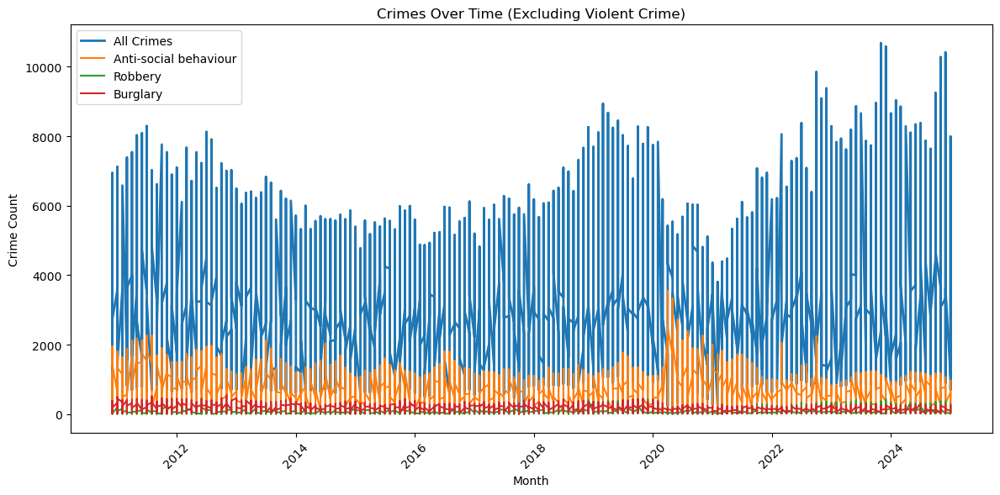

In [ ]:

# 1. Prepare the data, sorting by Month for each line
df_all = grouped_all_pd[['Month', 'crime_count_all']].copy()
df_all = df_all.sort_values('Month')

df_asb = grouped_type_pd['Anti-social behaviour'][['Month','crime_count']].copy()
df_asb = df_asb.sort_values('Month')

df_rob = grouped_type_pd['Robbery'][['Month','crime_count']].copy()
df_rob = df_rob.sort_values('Month')

df_bur = grouped_type_pd['Burglary'][['Month','crime_count']].copy()
df_bur = df_bur.sort_values('Month')

# 2. Create a single figure/axis
plt.figure(figsize=(12, 6))

# 3. Plot each line
plt.plot(df_all['Month'], df_all['crime_count_all'], label='All Crimes', linewidth=2)
plt.plot(df_asb['Month'], df_asb['crime_count'], label='Anti-social behaviour')
plt.plot(df_rob['Month'], df_rob['crime_count'], label='Robbery')
plt.plot(df_bur['Month'], df_bur['crime_count'], label='Burglary')

# 4. Formatting
plt.xlabel('Month')
plt.ylabel('Crime Count')
plt.title('Crimes Over Time (Excluding Violent Crime)')
plt.legend()
plt.xticks(rotation=45)  # If months are too crowded, rotate labels
plt.tight_layout()

# 5. Show or save
plt.savefig('four_crime_lines.png', dpi=100)
plt.show()


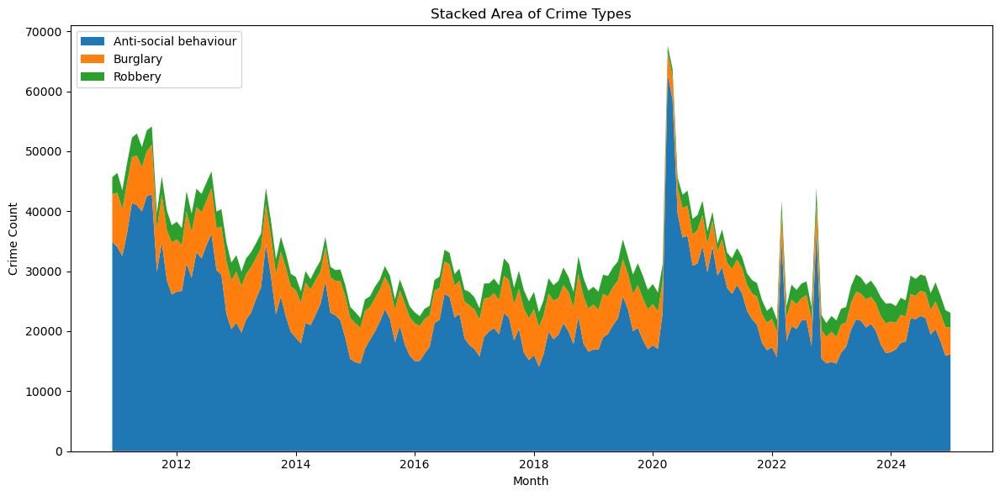

In [ ]:

# 1) Combine your data
#    Suppose you have the following for each category:
#    df_all -> columns ["Month", "crime_count", "Crime type" = "All Crimes"]
#    df_asb -> columns ["Month", "crime_count", "Crime type" = "Anti-social behaviour"]
#    df_rob -> columns ["Month", "crime_count", "Crime type" = "Robbery"]
#    df_bur -> columns ["Month", "crime_count", "Crime type" = "Burglary"]
# Make sure each DataFrame has the same column names and the final "Crime type" column

df_combined = pd.concat([df_asb, df_rob, df_bur], ignore_index=True)

# 2) Pivot *with* an aggregator to handle duplicates
df_pivot = df_combined.pivot_table(
    index="Month",
    columns="Crime type",
    values="crime_count",
    aggfunc="sum",
    fill_value=0
)

# 3) (Optional) Sort by Month if it's a datetime
df_pivot = df_pivot.sort_index()

# 4) Prepare for stackplot
months = df_pivot.index
crime_types = df_pivot.columns  # e.g. ["All Crimes", "Anti-social behaviour", "Robbery", "Burglary"]

# Transpose so each row is a crime type, each column is a month
values = df_pivot.values.T  # shape => (num_crime_types, num_months)

# 5) Plot stacked area
plt.figure(figsize=(12, 6))
plt.stackplot(months, values, labels=crime_types)

plt.xlabel("Month")
plt.ylabel("Crime Count")
plt.title("Stacked Area of Crime Types")
plt.legend(loc="upper left")
plt.tight_layout()
plt.show()


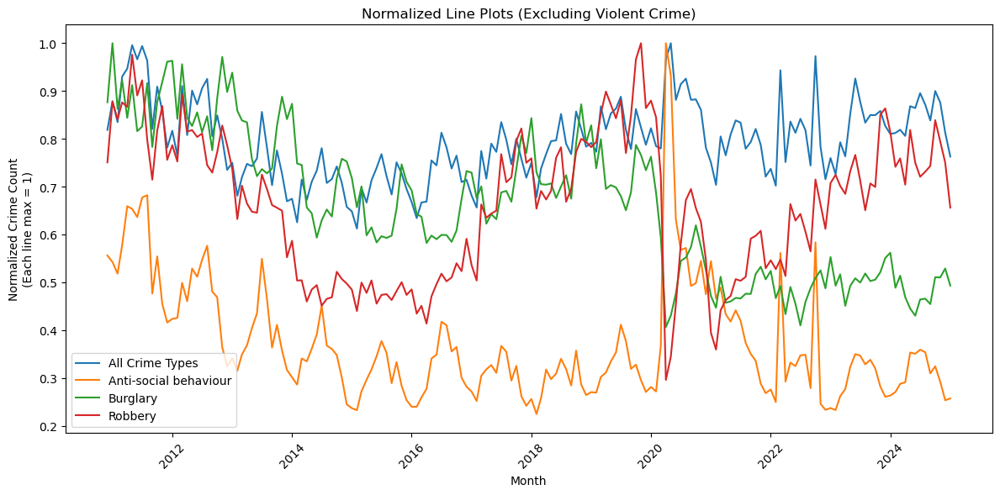

In [ ]:

# 1) Create a combined DataFrame for these four categories
#    (omitting "Violent crime").
#
# Suppose we have:
#    grouped_all_pd => columns ["Month", "crime_count_all"]
#    grouped_type_pd["Anti-social behaviour"] => ["Month", "crime_count"]
#    grouped_type_pd["Robbery"] => ["Month", "crime_count"]
#    grouped_type_pd["Burglary"] => ["Month", "crime_count"]

df_all = grouped_all_pd[['Month','crime_count_all']].copy()
df_all['Crime type'] = "All Crime Types"
df_all.rename(columns={'crime_count_all': 'crime_count'}, inplace=True)

df_asb = grouped_type_pd['Anti-social behaviour'][['Month','crime_count']].copy()
df_asb['Crime type'] = "Anti-social behaviour"

df_rob = grouped_type_pd['Robbery'][['Month','crime_count']].copy()
df_rob['Crime type'] = "Robbery"

df_bur = grouped_type_pd['Burglary'][['Month','crime_count']].copy()
df_bur['Crime type'] = "Burglary"

df_combined = pd.concat([df_all, df_asb, df_rob, df_bur], ignore_index=True)

# 2) Pivot *with aggregator* in case duplicates exist
df_pivot = df_combined.pivot_table(
    index='Month',
    columns='Crime type',
    values='crime_count',
    aggfunc='sum',
    fill_value=0
)

# 3) Sort by Month if it's a datetime
df_pivot = df_pivot.sort_index()

# 4) Normalize each column so its own max is 1
#    => Each line’s shape is preserved, but on a [0..1] scale.
df_norm = df_pivot.div(df_pivot.max())

# 5) Plot the lines
plt.figure(figsize=(12, 6))
for col in df_norm.columns:
    plt.plot(df_norm.index, df_norm[col], label=col)

plt.xlabel("Month")
plt.ylabel("Normalized Crime Count\n(Each line max = 1)")
plt.title("Normalized Line Plots (Excluding Violent Crime)")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

plt.savefig("normalized_lines_excl_violent.png", dpi=100)
plt.show()



# Temperature data
 

https://data.ceda.ac.uk/badc/ukmo-hadobs/data/insitu/MOHC/HadOBS/HadUK-Grid/v1.3.0.ceda/1km/psl/ann/v20240514

    archive
    badc
    ukmo-hadobs
    data
    insitu
    MOHC
    HadOBS
    HadUK-Grid
    v1.3.0.ceda
    1km



# Source:

HadUK-Grid Gridded Climate Observations on a 1km grid over the UK, v1.3.0.ceda (1836-2023)
========

Publication Status:
-------------------

    Published with DOI - please see catalogue record for full abstract and citation text

CEDA Data Catalogue Page for this dataset:
------------------------------------------

    https://catalogue.ceda.ac.uk/uuid/b963ead70580451aa7455782224479d5

Data Status:
------------
    This dataset has been completed.

licence: 
--------
    Use of these data is covered by the following licence(s): 
    
    http://www.nationalarchives.gov.uk/doc/open-government-licence/version/3/
    
    When using these data you must cite them correctly using the citation given on the catalogue record.
   
Access:
-------
   Access to these data is available to any registered CEDA user. Please Login or Register for an account to gain access.

Copyright © 2018 STFC All Rights Reserved

Hardly any documentation and the website is difficult to navigate. Therefore fall back to scraping once more. I have found the base folder on their data interface website manually. I will iterate through the tas folders by supplying the base url.

In [42]:
url = "https://services-beta.ceda.ac.uk/api/token/create/"

username = "rswarts"
password = "Bnmjkliop1!"
token = b64encode(f"{username}:{password}".encode('utf-8')).decode("ascii")
headers = {
    "Authorization": f'Basic {token}',
}

response = requests.request("POST", url, headers=headers)

# If successful, this will return a JSON response containing the token
response_data = json.loads(response.text)
print(response.text)
if response.status_code == 200:
    token = response_data["access_token"]

{"access_token":"eyJhbGciOiJSUzI1NiIsInR5cCIgOiAiSldUIiwia2lkIiA6ICI4ZjhmaUpyaUtDY3hmaHhzdU5vazVEekdJdFZ4amhhTWNJa05ZX2U4MnhJIn0.eyJleHAiOjE3NDQzMTU4MTMsImlhdCI6MTc0NDA1NjYxMywianRpIjoiMGIxNDkzYTMtZDYyMy00NTA3LWIxMTgtOTJhNGU1NjYxZmY1IiwiaXNzIjoiaHR0cHM6Ly9hY2NvdW50cy5jZWRhLmFjLnVrL3JlYWxtcy9jZWRhIiwic3ViIjoiMDU0NGUyMjgtNjk5My00MWQ4LTljN2UtNTAyZjVhNWMzYTlhIiwidHlwIjoiQmVhcmVyIiwiYXpwIjoic2VydmljZXMtcG9ydGFsLWNlZGEtYWMtdWsiLCJzZXNzaW9uX3N0YXRlIjoiOTU2Y2JiNjgtNzgxMS00ODdiLTkyNWQtMjlhODM4ZjZkNjMxIiwiYWNyIjoiMSIsInNjb3BlIjoiZW1haWwgb3BlbmlkIHByb2ZpbGUgZ3JvdXBfbWVtYmVyc2hpcCIsInNpZCI6Ijk1NmNiYjY4LTc4MTEtNDg3Yi05MjVkLTI5YTgzOGY2ZDYzMSIsImVtYWlsX3ZlcmlmaWVkIjp0cnVlLCJvcGVuaWQiOiJodHRwczovL2NlZGEuYWMudWsvb3BlbmlkL1J1YmVuLlN3YXJ0cyIsIm5hbWUiOiJSdWJlbiBTd2FydHMiLCJwcmVmZXJyZWRfdXNlcm5hbWUiOiJyc3dhcnRzIiwiZ2l2ZW5fbmFtZSI6IlJ1YmVuIiwiZmFtaWx5X25hbWUiOiJTd2FydHMiLCJlbWFpbCI6InIuYS5qLnN3YXJ0c0BzdHVkZW50cy51dS5ubCJ9.CZjuz4EVMq_6mFKkDmEm-eTMd8531DgJncfYEU2KKFU8iq7jLE9RAHOYlqJuvEWWVj42VxYgWdnfnBabyijd95

In [37]:
find_str = "charset="
r.headers.get('content-type')[r.headers.get('content-type').find(find_str) + len(find_str):]


'utf-8'

In [49]:
BASE_URL = r"https://dap.ceda.ac.uk/thredds/fileServer/badc/ukmo-hadobs/data/insitu/MOHC/HadOBS/HadUK-Grid/v1.3.0.ceda/"
MD5S_TXT = r"HadUK-Grid_v1.3.0.ceda_md5s.txt"
md5s_txt_url = urljoin(BASE_URL, MD5S_TXT)
save_path = TEMP_DDIR / MD5S_TXT


def download_text_from_link(url, token, save_path, encoding='utf-8'):
    """
    Downloads a plain text file from a URL using optional Bearer token and saves it to disk.

    Parameters:
    - url (str): The URL to download from.
    - token (str or None): Bearer token for authentication (optional).
    - save_path (str or Path): Path to save the downloaded file.
    - encoding (str): Encoding to use when decoding and saving (default 'utf-8').

    Returns:
    - str: The decoded text content.
    """
    headers = {"Authorization": f"Bearer {token}"} if token else {}
    f = fs.filesystem("http", headers=headers)

    try:
        with f.open(url, "rb") as file:
            raw = file.read()
            text = raw.decode(encoding)

        Path(save_path).parent.mkdir(parents=True, exist_ok=True)

        #save 
        with open(save_path, "w", encoding=encoding) as out_file:
            out_file.write(text)
            print(f"saved {save_path}")

    except Exception as e:
        raise RuntimeError(f"Failed to download or save from {url}: {e}")
download_text_from_link(md5s_txt_url, token, save_path)

saved /mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/download/HadUK-Grid_v1.3.0.ceda_md5s.txt


In [114]:
md5_links_df = pd.read_csv(
    save_path,
    delim_whitespace=True,
    header=None,
    names=['MD5_checksum', 'link'],
    dtype={'MD5_checksum': 'string', 'link': 'string'}
)


md5_links_df.dtypes
md5_links_df

/tmp/ipykernel_1045/1579129203.py:1: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  md5_links_df = pd.read_csv(


,MD5_checksum,link
0,e40940209ebb131120df09f2895b0b0e,./5km/sun/mon-30y/v20240514/sun_hadukgrid_uk_5...
1,070d2c0c822b7c97e8ce52c94a01996a,./5km/sun/mon-30y/v20240514/sun_hadukgrid_uk_5...
2,46571aafaa18bc201bfd14007df81ace,./5km/sun/mon-30y/v20240514/sun_hadukgrid_uk_5...
3,8708b9cc0fb4d651f6c5defd1646c0d3,./5km/sun/seas-20y/v20240514/sun_hadukgrid_uk_...
4,19b091b05162c4a68025ec01cb242294,./5km/sun/ann/v20240514/sun_hadukgrid_uk_5km_a...
...,...,...
33007,c49673f77075942b3055ebff37d672a3,./25km/tasmax/seas/v20240514/tasmax_hadukgrid_...
33008,3df1b795e8d82df6cf8461dce781cc32,./25km/tasmax/seas/v20240514/tasmax_hadukgrid_...
33009,94aa28d5935065419392058cf653790f,./25km/tasmax/mon-20y/v20240514/tasmax_hadukgr...
33010,28bd3fb873d0a24c13c76175c059f3dc,./HadUK-Grid_v1.3.0.ceda_change_log.txt


In [122]:
#contains 1km and (tas or tasmax or tasmin) and (mon or day)
pattern = (
    r'(?=.*1km)'
    r'(?=.*\b(?:tasmax|tas)\b)'
    r'(?=.*\b(?:mon/)\b)'
)
match = md5_links_df['link'].str.contains(pattern, regex=True, na=False)
match

0        False
1        False
2        False
3        False
4        False
         ...  
33007    False
33008    False
33009    False
33010    False
33011    False
Name: link, Length: 33012, dtype: boolean

In [124]:
monthly_t = md5_links_df[match]

#split max
pattern = "max"
match = monthly_t['link'].str.contains(pattern)
monthly_t_max = monthly_t[match]


In [125]:
monthly_t = monthly_t[~match]
monthly_t

,MD5_checksum,link
20722,cfa07f048db74a2704742e36f37217a8,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20723,3952e1613da555f3d8356f3cada9a00a,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20724,b9c011b3f109a0ac2de39347a9cefe8d,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20725,a7b20aa0c28b32d10c7817dc37213f42,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20726,d3863ae13c47ff51e32621fe110dc4fd,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
...,...,...
20857,917fedebfb6b3e74924a21e5ec4870c3,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20858,ce73d32a921be8a114dac7d86f182b68,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20859,692ec445e1fc0565210703b5c8c061e6,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...
20860,ef08b5e21aa2117e681c0c700a9e9cdb,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...


In [126]:
monthly_t_max

,MD5_checksum,link
25897,2c8faa65b210c7438ce52a1073ed0cc0,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
25898,0fa8e1d94b10c19815b7c1483321f2be,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
25899,09bd5191a722aac75aba2fc4a6d407ab,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
25900,7686ab37f20ec9d4072839f0494e1be2,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
25901,1c2c1f3a2066b38acd6233faa0c97d1c,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
...,...,...
26032,664f7122d7536417d03d59d83360ffbd,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
26033,7af5d28df86c574621bfcccc4b36bf1f,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
26034,6cb74b282011c72dcd854a47612a1584,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...
26035,11c0f0515907f11ec83810363d1038f4,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...


In [130]:
def filter_and_extract_year(df):
    # Extract the ending YYYYMM
    extracted = df['link'].str.extract(r'_(\d{6})-(\d{6})\.nc$')
    end_ym = pd.to_numeric(extracted[1], errors='coerce')  # second group = end date

    # Extract year only
    end_year = end_ym // 100

    # Filter for years >= 2011
    valid = end_year >= 2011
    df_filtered = df[valid].copy()

    # Add year column and sort
    df_filtered['year'] = end_year[valid]
    df_filtered.sort_values('year', inplace=True)

    return df_filtered

In [131]:
monthly_t = filter_and_extract_year(monthly_t)
monthly_t_max = filter_and_extract_year(monthly_t_max)


# Extacting daily data

In [135]:
pattern = (
    r'(?=.*1km)'
    r'(?=.*\b(?:tasmax)\b)'
    r'(?=.*\b(?:day/)\b)'
)
day_match = md5_links_df['link'].str.contains(pattern, regex=True, na=False)
daily_tasmax = md5_links_df[day_match].copy()
def filter_and_extract_yearmonth(df):
    # Extract end date from filenames like: ..._YYYYMMDD-YYYYMMDD.nc
    match = df['link'].str.extract(r'_(\d{8})-(\d{8})\.nc$')
    end_ymd = pd.to_numeric(match[1], errors='coerce')  # second date (end)

    # Extract yearmonth
    end_ym = end_ymd // 100  # remove day

    # Filter yearmonth >= 201101
    valid = end_ym >= 201101
    df_filtered = df[valid].copy()

    # Add columns
    df_filtered['yearmonth'] = end_ym[valid]
    df_filtered['year'] = df_filtered['yearmonth'] // 100

    # Sort
    df_filtered.sort_values('yearmonth', inplace=True)

    return df_filtered
daily_tasmax = filter_and_extract_yearmonth(daily_tasmax)



In [136]:
daily_tasmax

,MD5_checksum,link,yearmonth,year
25368,4f40741ef1744b339b820da67a67534c,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,201101,2011
25414,4a1f0518b812f5f1e0a2ffd62145d56c,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,201102,2011
25351,772f6f382c7539e101cb4eec4def82d3,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,201103,2011
25669,28ad3291f9e5951658d217a68e1d47fd,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,201104,2011
25575,77bcc7863d2c78c80816e45216faaf98,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,201105,2011
...,...,...,...,...
25405,6a31659ec1345f4aee3a325df9c25b6a,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,202308,2023
25789,d2b02344ee55c4b138bca2ab5a288888,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,202309,2023
25274,00bec0d577d89e92c1a971e8402fbd21,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,202310,2023
25706,738f79d4c472d5f435c480f14ac9f38f,./1km/tasmax/day/v20240514/tasmax_hadukgrid_uk...,202311,2023


In [137]:
monthly_t


,MD5_checksum,link,year
20734,bd640a235e071f0c0719b2dcf418a83c,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2011
20823,52e881963ffb1e6fd0e170ca5469ed17,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2012
20843,0a18ddd31220c1ac23744f3df9399823,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2013
20831,5d2c16f7ec71e71982ec60ccf6cfecd3,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2014
20722,cfa07f048db74a2704742e36f37217a8,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2015
20763,e71703207880b1b8bc21b3560c2f393d,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2016
20796,21c370315c62044c6a06bd5c8e8c0985,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2017
20744,126c4e89e7de52382442e821bc51af3d,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2018
20779,4c869c4efdca380953718864477af130,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2019
20809,11d12213fdfd1808966b1736f0016240,./1km/tas/mon/v20240514/tas_hadukgrid_uk_1km_m...,2020


In [138]:
monthly_t_max

,MD5_checksum,link,year
25911,d9cf624f42ac6746c67c8ec82a81bbc7,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2011
25980,f014640d8ebe1aebebb010a09ffef405,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2012
25968,1042518502d2a5f0c736723a708c739d,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2013
26000,4bbf67d16c0aad3ed44d84471d72a2a6,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2014
25908,4b4a02dccad724ff29613befadefc059,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2015
25988,7f1f5bc9c1aecfbf28f401d001eec253,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2016
26010,d53a89e5e6f42002d17c81b0b66657cb,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2017
25982,79e6f2185ad3b091e720bb74daa7ee85,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2018
26034,6cb74b282011c72dcd854a47612a1584,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2019
25944,f5b176690b3bed59dc10ed2169f99a64,./1km/tasmax/mon/v20240514/tasmax_hadukgrid_uk...,2020


Trying multiple links

In [ ]:
def open_files_daily_per_month(df, token):
    """
    Opens NetCDFs that each contain daily data for a single month.
    We simply combine them across the actual 'time' dimension
    instead of forcing 12 or 365 steps.
    
    DataFrame df should have:
      - 'link': path to each NetCDF
      - 'MD5_checksum': for verification
      - 'year': (optional) if you need it, but not used to reconstruct time
    """
    import os
    import io
    import logging
    import hashlib
    from urllib.parse import urljoin

    import fsspec
    import xarray as xr
    import rioxarray

    BBOX_LONDON_TARGET_CRS = (520000.0, 155000.0, 560000.0, 195000.0)
    BASE_URL = "https://dap.ceda.ac.uk"
    
    # Setup logging & HTTP filesystem
    logging.basicConfig(level=logging.INFO)
    headers = {"Authorization": f"Bearer {token}"}
    http_fs = fs.filesystem("http", headers=headers)

    valid_buffers = []
    for idx, row in df.iterrows():
        relative_path = row["link"]
        url = urljoin(BASE_URL, relative_path)
        expected_checksum = row["MD5_checksum"]

        try:
            with http_fs.open(url, "rb") as remote_file:
                content = remote_file.read()
            
            # Verify MD5
            downloaded_checksum = hashlib.md5(content).hexdigest()
            if downloaded_checksum != expected_checksum:
                logging.error(
                    f"Checksum mismatch for {url}:\n"
                    f"Expected: {expected_checksum}\n"
                    f"Got     : {downloaded_checksum}\n"
                    "Skipping this file."
                )
                continue

            valid_buffers.append(io.BytesIO(content))
            logging.info(f"File at {url} passed MD5 validation.")

        except Exception as e:
            logging.error(f"Failed to process {url}: {e}")

    if not valid_buffers:
        logging.warning("No valid files. Returning None.")
        return None

    ds_list = []
    for buf in valid_buffers:
        ds = xr.open_dataset(buf, engine="h5netcdf")
        ds.attrs.pop("creation_date", None)

        # As each file is daily data for a single month,
        # simply keep the original ds["time"] coordinate.
        # No custom dimension overrides needed.
        if "time" not in ds.dims:
            logging.error("Dataset has no 'time' dimension; skipping.")
            continue

        ds_list.append(ds)

    if not ds_list:
        logging.warning("No valid datasets after reading. Returning None.")
        return None

    # Combine across the actual time coordinate (which presumably has daily timestamps).
    # If all these NetCDFs have unique daily time values, combine_by_coords merges them in order.
    ds_all = xr.combine_by_coords(ds_list, combine_attrs="override")

    # Assign the correct CRS, if these data are in British National Grid
    ds_all = ds_all.rio.write_crs("EPSG:27700")

    # Subset bounding box
    minx, miny, maxx, maxy = BBOX_LONDON_TARGET_CRS
    ds_subset = ds_all.sel(
        projection_x_coordinate=slice(minx, maxx),
        projection_y_coordinate=slice(miny, maxy)
    )
    
    return ds_subset

def save_files(ds_subset, output_dir, suffix):
    # Save as NetCDF (main file)
    try:
        # Create directory if needed
        os.makedirs(output_dir, exist_ok=True)
        
        # Verify write permissions
        if not os.access(output_dir, os.W_OK):
            raise PermissionError(f"No write permissions for {output_dir}")

    except Exception as e:
        print(f"Failed to save file: {str(e)}")


    # Save as GeoTIFF for GIS
    ds_subset = ds_subset[suffix]
    ds_subset = ds_subset.rio.write_crs("EPSG:27700")
    ds_subset.rio.to_raster(f"{output_dir}/{suffix}.tif")

    #ds_subset.to_netcdf(f"/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/tasmonthly/{suffix}/subset_data_{suffix}.nc")
    #ds_subset.to_netcdf(f"/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/tasmonthly/{suffix}/subset_data_{suffix}_compressed.nc", encoding={suffix: {"zlib": True, "complevel": 4}})



In [200]:
ds_subset = open_files_from_link_month(daily_tasmax
, token)


In [191]:
ds_subset

<xarray.Dataset> Size: 4MB
Dimensions:                       (time: 156, projection_y_coordinate: 45,
                                   projection_x_coordinate: 58, bnds: 2)
Coordinates:
    transverse_mercator           int64 8B 0
  * projection_y_coordinate       (projection_y_coordinate) float64 360B 1.56...
  * projection_x_coordinate       (projection_x_coordinate) float64 464B 5.04...
    latitude                      (projection_y_coordinate, projection_x_coordinate) float64 21kB ...
    longitude                     (projection_y_coordinate, projection_x_coordinate) float64 21kB ...
    month_number                  (time) int64 1kB 1 2 3 4 5 6 ... 8 9 10 11 12
    season_year                   (time) int64 1kB 2011 2011 2011 ... 2023 2024
  * time                          (time) int64 1kB 201101 201102 ... 202312
Dimensions without coordinates: bnds
Data variables:
    tasmax                        (time, projection_y_coordinate, projection_x_coordinate) float64 3MB ...
    time_bnds                     (time, bnds) datetime64[ns] 2kB 2011-01-01 ...
    projection_y_coordinate_bnds  (time, projection_y_coordinate, bnds) float64 112kB ...
    projection_x_coordinate_bnds  (time, projection_x_coordinate, bnds) float64 145kB ...
Attributes:
    comment:      Monthly resolution gridded climate observations
    frequency:    mon
    institution:  Met Office
    references:   doi: 10.1002/gdj3.78
    short_name:   monthly_maxtemp
    source:       HadUK-Grid_v1.3.0.0
    title:        Gridded surface climate observations data for the UK
    version:      v20240514
    Conventions:  CF-1.7

In [192]:
TAS = TEMP_DIR / 'tas_monthly'
save_files(ds_subset, TAS, suffix="tasmax")

In [ ]:
daily_tasmax
monthly_t
monthly_t_max


In [ ]:
subsets_max_min = []
for links in max_min:
    subset = open_files_from_link(links = links)
    subsets_max_min.append(subset)

In [ ]:
list_max_min = ["tasmax", "tasmin"]
for i in range(2):
    save_files(subsets_max_min[i], list_max_min[i])

# Checking tas data
 

Inspect loaded data (tas, monthly, from 2010)

In [ ]:
print("Variables in dataset:", list(ds_all.data_vars))
print("Coordinates:", ds_all.coords)

Variables in dataset: ['tas', 'time_bnds', 'projection_y_coordinate_bnds', 'projection_x_coordinate_bnds']
Coordinates: Coordinates:
    transverse_mercator      int64 8B 0
  * time                     (time) datetime64[ns] 1kB 2010-01-16 ... 2023-12-16
  * projection_y_coordinate  (projection_y_coordinate) float64 12kB -1.995e+0...
  * projection_x_coordinate  (projection_x_coordinate) float64 7kB -1.995e+05...
    latitude                 (projection_y_coordinate, projection_x_coordinate) float64 10MB ...
    longitude                (projection_y_coordinate, projection_x_coordinate) float64 10MB ...
    month_number             (time) int64 1kB 1 2 3 4 5 6 7 ... 6 7 8 9 10 11 12
    season_year              (time) int64 1kB 2010 2010 2010 ... 2023 2023 2024


In [ ]:
# Check grid mapping info
print(ds_all["tas"].attrs)

{'standard_name': 'air_temperature', 'long_name': 'Mean air temperature', 'units': 'degC', 'description': 'Mean air temperature', 'label_units': '°C', 'level': '1.5m', 'plot_label': 'Mean air temperature at 1.5m (°C)', 'cell_methods': 'time: mid_range within days time: mean over days', 'grid_mapping': 'transverse_mercator'}


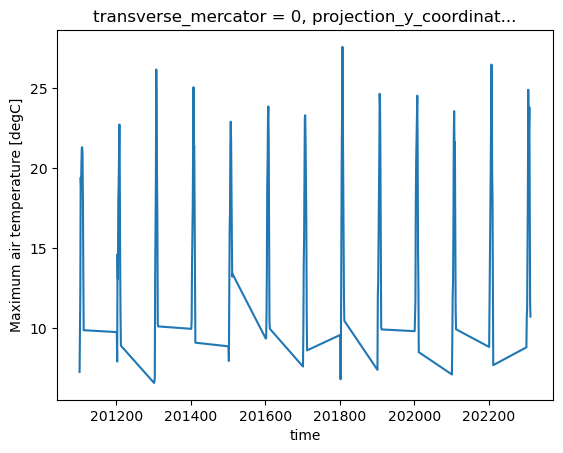

In [195]:
ds_subset["tasmax"].sel(
    projection_x_coordinate=385100,  # Easting (X) in meters
    projection_y_coordinate=150000,  # Northing (Y) in meters
    method="nearest"
).plot()

In [ ]:
# Print the grid mapping variable (usually named after the projection, e.g., 'transverse_mercator')
print(ds_all["transverse_mercator"])

<xarray.DataArray 'transverse_mercator' (time: 168)> Size: 672B
array([-2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,
       -2147483647, -2147483647, -2147483647, -2147483647, -2147483647,


In [ ]:
print("CRS:", ds_all.rio.crs)

CRS: EPSG:27700


{'standard_name': 'air_temperature', 'long_name': 'Mean air temperature', 'units': 'degC', 'description': 'Mean air temperature', 'label_units': '°C', 'level': '1.5m', 'plot_label': 'Mean air temperature at 1.5m (°C)', 'cell_methods': 'time: mid_range within days time: mean over days'}


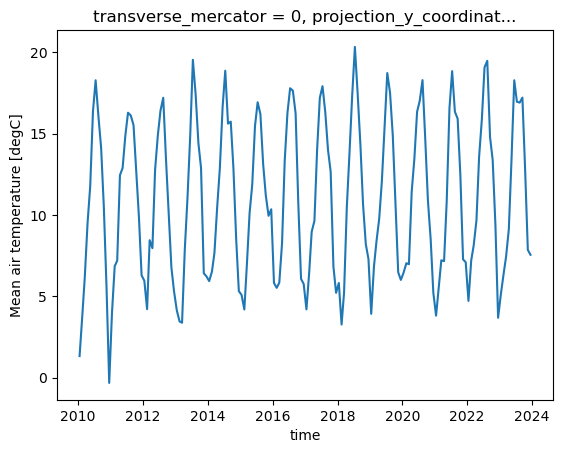

In [ ]:
# Check grid mapping info
print(ds_all["tas"].attrs)
ds_all["tas"].sel(
    projection_x_coordinate=385000,  # Easting (X) in meters
    projection_y_coordinate=160000,  # Northing (Y) in meters
    method="nearest"
).plot()

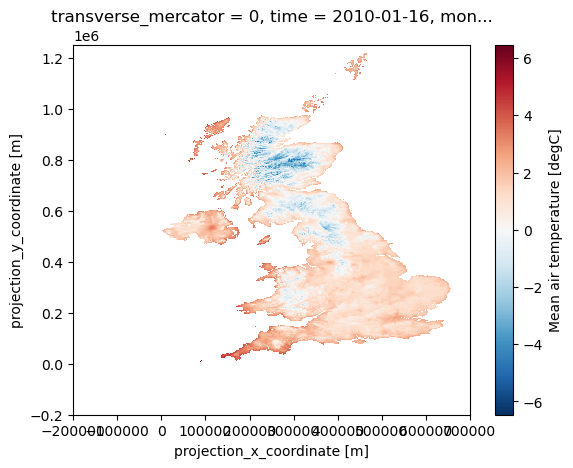

In [ ]:
ds_all["tas"].isel(time=0).plot()

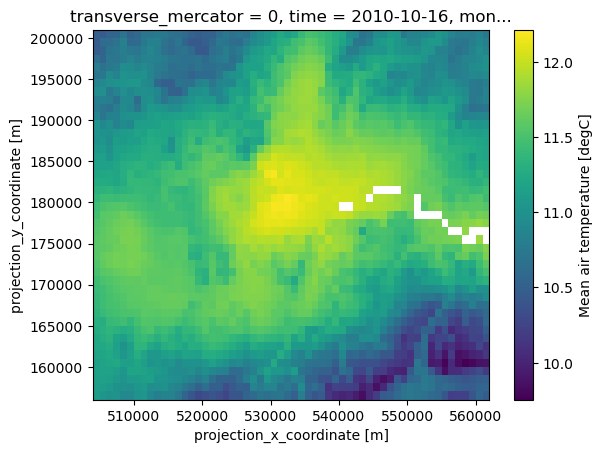

In [ ]:
ds_subset["tas"].isel(time=9).plot()

In [ ]:

# Create temporary directory for frames
TEMP_DIR = "plots/tas_mean_monthly"
os.makedirs(TEMP_DIR, exist_ok=True)

# Get consistent color scale limits for all frames
vmin = float(ds_subset["tas"].min())
vmax = float(ds_subset["tas"].max())

# Get datetime objects for titles
times = ds_subset.time.values.astype('datetime64[ms]').astype(datetime)

# Generate individual frames
filenames = []
for i, t in enumerate(tqdm(times)):
    # Create figure
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Plot with consistent color scale
    ds_subset["tas"].isel(time=i).plot(
        ax=ax,
        vmin=vmin,
        vmax=vmax,
        add_colorbar=True,
        cbar_kwargs={'label': ds_subset["tas"].attrs.get('units', '')}
    )
    
    # Format title with month/year
    date_str = t.strftime("%B %Y")  # Format as "Month Year"
    ax.set_title(f"Surface Temperature - {date_str}")
    
    # Save frame
    filename = f"{TEMP_DIR}/frame_{i:04d}.png"
    plt.savefig(filename, bbox_inches='tight', dpi=100)
    filenames.append(filename)
    
    plt.close()

# Create GIF from frames
with imageio.get_writer('temperature_animation.gif', mode='I', fps=10) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Cleanup temporary files
for filename in filenames:
    os.remove(filename)
os.rmdir(TEMP_DIR)

print("Animation created: temperature_animation.gif")

  0%|          | 0/168 [00:00<?, ?it/s]

100%|██████████| 168/168 [00:14<00:00, 11.88it/s]
/tmp/ipykernel_252774/3979907667.py:47: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


Animation created: temperature_animation.gif


In [ ]:


# Create temporary directory for frames
TEMP_DIR = "normalized_animation_frames"
os.makedirs(TEMP_DIR, exist_ok=True)

# Calculate anomalies (deviation from spatial mean)
anomalies = ds_subset["tas"] - ds_subset["tas"].mean(
    dim=('projection_x_coordinate', 'projection_y_coordinate')
)

# Get consistent scale for anomalies
max_abs = max(np.abs(anomalies.min()), np.abs(anomalies.max()))
vmin, vmax = -max_abs, max_abs

# Get datetime objects for titles
times = ds_subset.time.values.astype('datetime64[ms]').astype(datetime)

# Generate individual frames
filenames = []
for i, t in enumerate(tqdm(times)):
    # Create figure
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Plot normalized anomalies
    im = anomalies.isel(time=i).plot(
        ax=ax,
        vmin=vmin,
        vmax=vmax,
        cmap='RdBu_r',  # Red-Blue diverging colormap
        add_colorbar=True,
        cbar_kwargs={'label': f"Temperature Anomaly ({ds_subset['tas'].units})"}
    )
    
    # Format title
    date_str = t.strftime("%B %Y")
    ax.set_title(f"Temperature Anomalies - {date_str}\n(Relative to Spatial Average)")
    
    # Save frame
    filename = f"{TEMP_DIR}/frame_{i:04d}.png"
    plt.savefig(filename, bbox_inches='tight', dpi=100)
    filenames.append(filename)
    
    plt.close()

# Create GIF from frames
with imageio.get_writer('temperature_anomalies.gif', mode='I', fps=10) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Cleanup temporary files
for filename in filenames:
    os.remove(filename)
os.rmdir(TEMP_DIR)

print("Normalized animation created: temperature_anomalies.gif")

100%|██████████| 168/168 [00:18<00:00,  9.14it/s]
/tmp/ipykernel_252774/1749965831.py:54: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


Normalized animation created: temperature_anomalies.gif


In [ ]:


# Convert xarray DataArray to rasterio-compatible format
da = ds_subset["tas"]

# Define geotransform (adjust based on your CRS and resolution)
res = float(da.projection_x_coordinate[1] - da.projection_x_coordinate[0])
transform = from_origin(
    west=float(da.projection_x_coordinate.min()),
    north=float(da.projection_y_coordinate.max()),
    xsize=res,
    ysize=res
)

# Save each time step as a separate raster layer in GPKG
with rasterio.open(
    "temperature.gpkg",
    "w",
    driver="GPKG",
    height=da.sizes["projection_y_coordinate"],
    width=da.sizes["projection_x_coordinate"],
    count=len(da.time),
    dtype=str(da.dtype),
    crs = TARGET_CRS,
    transform=transform,
) as dst:
    for t in range(len(da.time)):
        dst.write(da.isel(time=t).values, t + 1)  # Band numbering starts at 1
        dst.set_band_description(t + 1, f"Time Step {t}")


In [ ]:
(8.13 * (29) + (8.66 * 7.5 * 0.3)) / (29 + 7.5 * 0.3)

8.16816

In [ ]:


# Convert xarray DataArray to compatible format
da = ds_subset["tas"]

# 1. Convert data type to Float32 (required by GPKG raster)
da = da.astype(np.float32)

# 2. Handle NoData values (if needed)
da = da.where(~np.isnan(da), -9999).rio.write_nodata(-9999)

# 3. Define geotransform
res = float(da.projection_x_coordinate[1] - da.projection_x_coordinate[0])
transform = from_origin(
    west=float(da.projection_x_coordinate.min()),
    north=float(da.projection_y_coordinate.max()),
    xsize=res,
    ysize=res
)

# 4. Save to GeoPackage with compression
with rasterio.open(
    "temperature.gpkg",
    "w",
    driver="GPKG",
    height=da.sizes["projection_y_coordinate"],
    width=da.sizes["projection_x_coordinate"],
    count=len(da.time),
    dtype=np.float32,  # Must match data type
    crs = TARGET_CRS,
    transform=transform,
    nodata=-9999,
    PREDICTOR=2,  # For better compression
    ZLEVEL=9       # Compression level
) as dst:
    for t in range(len(da.time)):
        dst.write(da.isel(time=t).values, t + 1)
        dst.set_band_description(t + 1, f"Time Step {t}")

RasterioIOError: Only single band dataset supported for non Byte datatype

In [ ]:
#https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london

# Aggregate crime data to OA level (polygons)

In [ ]:
OA = gpd.read_file(crime_gpkg,
                    layer= 'OA',
                    engine='pyogrio',
                    use_arrow = True)

<Axes: >

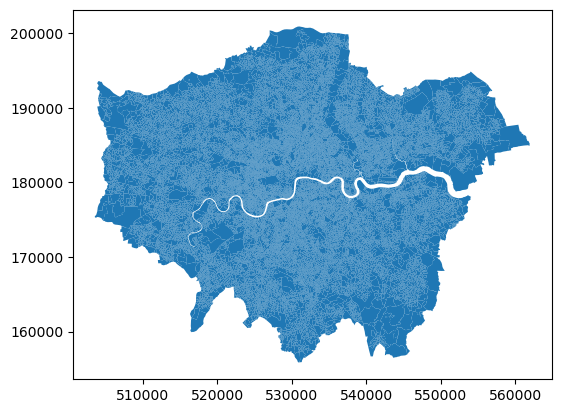

In [ ]:
OA.plot()

In [ ]:
OA.head()

,OA11CD,LSOA11CD,MSOA11CD,WD11CD_BF,WD11NM_BF,LAD11CD,LAD11NM,RGN11CD,RGN11NM,LSOA11NM,MSOA11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E00023264,E01004612,E02000954,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 032C,Wandsworth 032,462,459,3,115.2,143,3.2,"MULTIPOLYGON (((527635.452 171810.058, 527495...."
1,E00003359,E01000692,E02000128,E05000111,Chislehurst,E09000006,Bromley,E12000007,London,Bromley 002D,Bromley 002,269,259,10,36.7,133,1.9,"MULTIPOLYGON (((543581.516 171132.486, 543704 ..."
2,E00023266,E01004615,E02000956,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 034B,Wandsworth 034,277,277,0,183.4,133,2.1,"MULTIPOLYGON (((526613.539 171839.165, 526546...."
3,E00020264,E01004027,E02000809,E05000548,Riverside,E09000028,Southwark,E12000007,London,Southwark 003E,Southwark 003,415,415,0,96.1,191,2.2,"MULTIPOLYGON (((533563.521 179695.146, 533351...."
4,E00023263,E01004613,E02000955,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 033D,Wandsworth 033,304,304,0,165.2,131,2.3,"MULTIPOLYGON (((527822 172020, 527979 171903.0..."


In [ ]:
OA.columns

Index(['OA11CD', 'LSOA11CD', 'MSOA11CD', 'WD11CD_BF', 'WD11NM_BF', 'LAD11CD',
       'LAD11NM', 'RGN11CD', 'RGN11NM', 'LSOA11NM', 'MSOA11NM', 'USUALRES',
       'HHOLDRES', 'COMESTRES', 'POPDEN', 'HHOLDS', 'AVHHOLDSZ', 'geometry'],
      dtype='object')

In [ ]:
crime = gpd.read_file(crime_gpkg,
                    layer= 'crime',
                    engine='pyogrio',
                    use_arrow = True)

In [ ]:
len(crime)

3969742

In [ ]:
#join ao to crime
joined_crime_OA = gpd.sjoin(
    crime[['geometry', 'Month']], 
    OA[['OA11CD', 'geometry']],  # 'boroughs' should have a column named 'borough'
    how='left', 
    predicate='intersects'
)

In [ ]:
len(joined_crime_OA)

3969742

In [ ]:
# convert to cuDF for GPU-accelerated grouping 
df = None
df = joined_crime_OA[['OA11CD', 'Month']].dropna(subset=['OA11CD'])
cudf_df = cudf.DataFrame.from_pandas(df)
cudf_df['Month'] = pd.to_datetime(cudf_df['Month'].to_pandas())

In [ ]:
grouped_all = cudf_df.groupby(['OA11CD', 'Month']).size().reset_index(name='crime_count_per_AO_per_month')

In [ ]:
grouped_all_pd = grouped_all.to_pandas()

In [ ]:
grouped_all_pd.columns

Index(['OA11CD', 'Month', 'crime_count_per_AO_per_month'], dtype='object')

In [ ]:
len(grouped_all_pd)

1534212

In [ ]:
joined_gdf = grouped_all_pd.merge(OA[['OA11CD', 'geometry']], on='OA11CD', how='left')

In [ ]:
len(joined_gdf)

1534212

In [ ]:
joined_gdf.columns

Index(['OA11CD', 'Month', 'crime_count_per_AO_per_month', 'geometry'], dtype='object')

In [ ]:
joined_gdf = gpd.GeoDataFrame(
    joined_gdf, 
    geometry='geometry', 
    crs='EPSG:27700'  # or whatever CRS applies to your data
)

In [ ]:
joined_gdf.head()

,OA11CD,Month,crime_count_per_AO_per_month,geometry
0,E00012762,2020-11-01,2,"MULTIPOLYGON (((518423.16 178116.074, 518386.6..."
1,E00011828,2023-12-01,1,"MULTIPOLYGON (((551637.731 184158.971, 551645...."
2,E00018754,2012-02-01,2,"MULTIPOLYGON (((544275.802 185730.918, 544303...."
3,E00015184,2022-03-01,4,"MULTIPOLYGON (((530828.941 178864.197, 530635 ..."
4,E00004291,2011-03-01,2,"MULTIPOLYGON (((524832.81 184935.084, 524851.4..."


In [ ]:
joined_gdf.to_file(crime_gpkg, layer="crime_aggr_OA", driver="GPKG", mode='w')

# Aggreagate rasterized temp date into polygons

In [ ]:


# Load rasterized temperature data with rioxarray
raster = rioxarray.open_rasterio("/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/tasmonthly/subset_data.tif")


In [ ]:
raster

<xarray.DataArray (band: 168, y: 45, x: 58)> Size: 4MB
[438480 values with dtype=float64]
Coordinates:
  * band         (band) int64 1kB 1 2 3 4 5 6 7 ... 162 163 164 165 166 167 168
  * x            (x) float64 464B 5.045e+05 5.055e+05 ... 5.605e+05 5.615e+05
  * y            (y) float64 360B 1.565e+05 1.575e+05 ... 1.995e+05 2.005e+05
    spatial_ref  int64 8B 0
Attributes:
    cell_methods:   time: mid_range within days time: mean over days
    description:    Mean air temperature
    label_units:    °C
    level:          1.5m
    long_name:      Mean air temperature
    plot_label:     Mean air temperature at 1.5m (°C)
    standard_name:  air_temperature
    units:          degC
    AREA_OR_POINT:  Area
    _FillValue:     1e+20
    scale_factor:   1.0
    add_offset:     0.0

In [ ]:


start_date = pd.to_datetime("2010-12-01")  # anchor date
time_range = pd.date_range(start_date, periods=raster.band.size, freq="MS")

# Convert to "YYYY-MM" strings
time_strings = time_range.strftime("%Y-%m")

# Assign the new coordinate, drop the old 'band'
raster = raster.assign_coords(month=("band", time_strings))
raster = raster.swap_dims({"band": "month"}).drop_vars("band")

print(raster)
# ds now has a dimension named 'month' with labels like '2010-12', '2011-01', etc.


<xarray.DataArray (month: 168, y: 45, x: 58)> Size: 4MB
[438480 values with dtype=float64]
Coordinates:
  * x            (x) float64 464B 5.045e+05 5.055e+05 ... 5.605e+05 5.615e+05
  * y            (y) float64 360B 1.565e+05 1.575e+05 ... 1.995e+05 2.005e+05
    spatial_ref  int64 8B 0
  * month        (month) object 1kB '2010-12' '2011-01' ... '2024-10' '2024-11'
Attributes:
    cell_methods:   time: mid_range within days time: mean over days
    description:    Mean air temperature
    label_units:    °C
    level:          1.5m
    long_name:      Mean air temperature
    plot_label:     Mean air temperature at 1.5m (°C)
    standard_name:  air_temperature
    units:          degC
    AREA_OR_POINT:  Area
    _FillValue:     1e+20
    scale_factor:   1.0
    add_offset:     0.0


In [ ]:
#doubel check
raster.rio.crs

CRS.from_wkt('PROJCS["OSGB36 / British National Grid",GEOGCS["OSGB36",DATUM["Ordnance_Survey_of_Great_Britain_1936",SPHEROID["Airy 1830",6377563.396,299.3249646,AUTHORITY["EPSG","7001"]],AUTHORITY["EPSG","6277"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4277"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",49],PARAMETER["central_meridian",-2],PARAMETER["scale_factor",0.9996012717],PARAMETER["false_easting",400000],PARAMETER["false_northing",-100000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH],AUTHORITY["EPSG","27700"]]')

In [ ]:
OA.columns

Index(['OA11CD', 'LSOA11CD', 'MSOA11CD', 'WD11CD_BF', 'WD11NM_BF', 'LAD11CD',
       'LAD11NM', 'RGN11CD', 'RGN11NM', 'LSOA11NM', 'MSOA11NM', 'USUALRES',
       'HHOLDRES', 'COMESTRES', 'POPDEN', 'HHOLDS', 'AVHHOLDSZ', 'geometry'],
      dtype='object')

In [ ]:
print(raster)  # prints a summary: dims, shape, coordinate names, and attributes
print("Dimensions:", raster.dims)
print("Coordinates:", list(raster.coords))
print("Attributes:", raster.attrs)
temp_values = raster.values  # or simply raster.data


<xarray.DataArray (month: 168, y: 45, x: 58)> Size: 4MB
[438480 values with dtype=float64]
Coordinates:
  * x            (x) float64 464B 5.045e+05 5.055e+05 ... 5.605e+05 5.615e+05
  * y            (y) float64 360B 1.565e+05 1.575e+05 ... 1.995e+05 2.005e+05
    spatial_ref  int64 8B 0
  * month        (month) object 1kB '2010-12' '2011-01' ... '2024-10' '2024-11'
Attributes:
    cell_methods:   time: mid_range within days time: mean over days
    description:    Mean air temperature
    label_units:    °C
    level:          1.5m
    long_name:      Mean air temperature
    plot_label:     Mean air temperature at 1.5m (°C)
    standard_name:  air_temperature
    units:          degC
    AREA_OR_POINT:  Area
    _FillValue:     1e+20
    scale_factor:   1.0
    add_offset:     0.0
Dimensions: ('month', 'y', 'x')
Coordinates: ['x', 'y', 'spatial_ref', 'month']
Attributes: {'cell_methods': 'time: mid_range within days time: mean over days', 'description': 'Mean air temperature', 'label_

In [ ]:
temp_values

array([[[ 1.75284977,  1.70047423,  1.63481085, ...,  1.06041864,
          1.19589287,  1.10562655],
        [ 1.78455058,  1.77165664,  1.73288634, ...,  1.10804033,
          1.17100693,  1.18780228],
        [ 1.79938785,  1.80887942,  1.7901882 , ...,  1.06319954,
          1.10551762,  1.12342443],
        ...,
        [ 1.23304461,  1.28337587,  1.41126835, ...,  1.31287945,
          1.41125356,  1.33967919],
        [ 1.21337869,  1.3365365 ,  1.33018867, ...,  1.24656976,
          1.36061123,  1.29145387],
        [ 1.21369579,  1.17310705,  1.24548348, ...,  1.22429691,
          1.30864246,  1.22905399]],

       [[ 4.03983788,  3.97820505,  3.89798843, ...,  2.93684026,
          3.09268071,  2.98696491],
        [ 4.07047828,  4.05091018,  4.00327334, ...,  2.98241151,
          3.05418952,  3.07013868],
        [ 4.07812149,  4.08784571,  4.0603809 , ...,  2.92203904,
          2.96918398,  2.98632692],
        ...,
        [ 3.03044357,  3.14044718,  3.33522849, ...,  

In [ ]:
print("Data Variables:", list(raster.data_vars))
print("Coordinates:", list(raster.coords))


AttributeError: 'DataArray' object has no attribute 'data_vars'

In [ ]:


# --- Load AO Polygon Data ---
gdf = gpd.read_file(
    "/mnt/c/Users/Ruben/Documents/Project_crime/data/crime_data_refined.gpkg", 
    layer="crime_aggr_OA",
    engine='pyogrio',
    use_arrow=True  
)
gdf = gdf.to_crs("EPSG:27700")
id_col = "OA11CD"

results = []  # to store aggregated values

# --- Loop through each month ---
for month in raster.coords["month"].values:
    print(f"processing month {month}")
    # Subset the raster to a 2D slice for the current month
    raster_month = raster.sel(month=month)
    arr_2d = raster_month.values

    # Get the affine transform for the current slice
    affine = raster_month.rio.transform()

    # Compute zonal stats (mean temperature) for all AO polygons
    # Use boundless=True to handle polygons partially or fully outside the raster.
    stats = zonal_stats(
        gdf, 
        arr_2d, 
        affine=affine, 
        stats=["mean"],
        nodata=None,  # adjust if your raster has a specific nodata value
        boundless=True
    )

    # For each polygon, store the aggregated value along with the polygon identifier and month
    for i, stat in enumerate(stats):
        polygon_id = gdf.iloc[i][id_col]
        mean_temp = stat["mean"]
        results.append({
            id_col: polygon_id,
            "month": month,      # "YYYY-MM" formatted string
            "mean_temp": mean_temp
        })

# Convert the results to a DataFrame
results_df = pd.DataFrame(results)

# --- Merge Results with Original GeoDataFrame ---
results_gdf = gdf.merge(results_df, on=id_col, how="right")

print(results_gdf.head())


processing month 2010-12


ValueError: width and height must be > 0

In [ ]:
stats = zonal_stats(
    AO,                           # Your polygon geometries
    raster.values[0],              # Assuming the temperature data is in the first band
    affine=raster.rio.transform(), # The affine transform of your raster
    stats="mean"                   # Only calculate the mean
)

# Attach the computed mean temperature to your GeoDataFrame
gdf["mean_temp"] = [stat["mean"] for stat in stats]

# Display the resulting GeoDataFrame
print(gdf[["mean_temp"]])

In [ ]:

# Ensure both datasets use the same CRS
# For instance, convert polygons to match the raster CRS
gdf = gdf.to_crs(raster.rio.crs)

# Compute zonal statistics:
# Here we compute mean, min, and max temperature for each polygon.
stats = zonal_stats(
    gdf,                           # The polygons
    raster.values[0],              # The raster data (first band if multi-band)
    affine=raster.rio.transform(), # The spatial transform from the raster
    stats=['mean', 'min', 'max']   # Metrics to compute
)

# Attach the zonal statistics to the GeoDataFrame
gdf['mean_temp'] = [stat['mean'] for stat in stats]
gdf['min_temp']  = [stat['min']  for stat in stats]
gdf['max_temp']  = [stat['max']  for stat in stats]

# Now, gdf has the aggregated temperature data per polygon.
print(gdf.head())


In [ ]:


# Load rasterized temperature data with rioxarray
raster = rioxarray.open_rasterio("/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/tasmonthly/subset_data.tif")

# Set up time coordinates
start_date = pd.to_datetime("2010-12-01")  # anchor date
time_range = pd.date_range(start_date, periods=raster.band.size, freq="MS")
time_strings = time_range.strftime("%Y-%m")

# Assign the new coordinate, drop the old 'band'
raster = raster.assign_coords(month=("band", time_strings))
raster = raster.swap_dims({"band": "month"}).drop_vars("band")

# Print basic information about the raster
print(f"Raster shape: {raster.shape}")
print(f"Raster CRS: {raster.rio.crs}")

# --- Load AO Polygon Data ---
gdf = gpd.read_file(
    "/mnt/c/Users/Ruben/Documents/Project_crime/data/crime_data_refined.gpkg",
    layer="crime_aggr_OA",
    engine='pyogrio',
    use_arrow=True  
)
gdf = gdf.to_crs("EPSG:27700")
id_col = "OA11CD"

# Use centroids instead of full polygons
print("Computing centroids...")
gdf['centroid'] = gdf.geometry.centroid
centroid_gdf = gdf[[id_col, 'centroid']].copy()
centroid_gdf.rename(columns={'centroid': 'geometry'}, inplace=True)
centroid_gdf.set_geometry('geometry', inplace=True)

# Extract coordinates from the centroids
print("Extracting coordinates...")
centroid_gdf['x'] = centroid_gdf.geometry.x
centroid_gdf['y'] = centroid_gdf.geometry.y

# Process each month
results = []
for month in raster.coords["month"].values:
    print(f"Processing month {month}")
    try:
        # Get the raster slice for this month
        raster_month = raster.sel(month=month)
        
        # Sample the raster at each centroid point
        for idx, row in centroid_gdf.iterrows():
            try:
                # Get the value at this point
                x, y = row['x'], row['y']
                
                # Check if the point is within the raster bounds
                if (x >= raster.x.min().item() and x <= raster.x.max().item() and
                    y >= raster.y.min().item() and y <= raster.y.max().item()):
                    
                    # Sample the raster at this point
                    value = raster_month.sel(x=x, y=y, method='nearest').item()
                    
                    # Skip if no data or NaN
                    if value is not None and not np.isnan(value) and value != 1e+20:
                        results.append({
                            id_col: row[id_col],
                            'month': month,
                            'mean_temp': value
                        })
            except Exception as e:
                print(f"Error sampling point {idx}: {str(e)}")
                continue
                
    except Exception as e:
        print(f"Error processing month {month}: {str(e)}")
        continue

# Convert to DataFrame
results_df = pd.DataFrame(results)

# Check if we got any results
if len(results_df) == 0:
    print("No valid results were generated.")
else:
    print(f"Successfully processed {len(results_df)} point-month combinations")
    print(results_df.head())
    
    # Save the results to a file
    output_path = "/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature_by_oa.csv"
    results_df.to_csv(output_path, index=False)
    print(f"Results saved to {output_path}")

Raster shape: (168, 45, 58)
Raster CRS: EPSG:27700
Computing centroids...
Extracting coordinates...
Processing month 2010-12


KeyboardInterrupt: 

In [ ]:



# Load raster data and set up time coordinates
raster = rioxarray.open_rasterio("/mnt/c/Users/Ruben/Documents/Project_crime/data/temperature/tasmonthly/subset_data.tif")
start_date = pd.to_datetime("2010-12-01")
time_range = pd.date_range(start_date, periods=raster.band.size, freq="MS")
time_strings = time_range.strftime("%Y-%m")

# Prepare raster data for GPU
raster = raster.assign_coords(month=("band", time_strings)).swap_dims({"band": "month"})
raster_gpu = cp.asarray(raster.data)
x_coords = cp.asarray(raster.x.values)
y_coords = cp.asarray(raster.y.values)

# Load and prepare centroids
gdf = gpd.read_file(
    "/mnt/c/Users/Ruben/Documents/Project_crime/data/crime_data_refined.gpkg",
    layer="crime_aggr_OA",
    engine='pyogrio',
    use_arrow=True  
)
gdf = gdf.to_crs("EPSG:27700").geometry.centroid.to_frame('geometry')
centroid_gdf = gdf.assign(x=gdf.geometry.x, y=gdf.geometry.y)
centroid_cudf = cudf.DataFrame.from_pandas(centroid_gdf[['OA11CD', 'x', 'y']])

# Filter points within raster bounds
mask = (
    (centroid_cudf['x'] >= x_coords.min().item()) &
    (centroid_cudf['x'] <= x_coords.max().item()) &
    (centroid_cudf['y'] >= y_coords.min().item()) &
    (centroid_cudf['y'] <= y_coords.max().item())
)
valid_centroids = centroid_cudf[mask].reset_index(drop=True)

# Calculate grid indices
x_res = (x_coords[1] - x_coords[0]).item()
y_res = (y_coords[1] - y_coords[0]).item()

x_indices = ((valid_centroids['x'] - x_coords[0].item()) / x_res).round().astype(int).clip(0, len(x_coords)-1)
y_indices = ((valid_centroids['y'] - y_coords[0].item()) / y_res).round().astype(int).clip(0, len(y_coords)-1)

# Extract temperatures for all valid points and months
temperatures = raster_gpu[:, y_indices.to_cupy(), x_indices.to_cupy()].T  # Shape: (points, months)

# Clean and filter data
temperatures = cp.where(temperatures == 1e20, cp.nan, temperatures)
valid_mask = ~cp.isnan(temperatures).any(axis=1)

# Apply consistent filtering to both datasets
valid_temperatures = temperatures[valid_mask]
valid_centroids_filtered = valid_centroids[valid_mask.get()].reset_index(drop=True)

# Create final DataFrame
n_points, n_months = valid_temperatures.shape
results_df = cudf.DataFrame({
    'OA11CD': valid_centroids_filtered['OA11CD'].repeat(n_months).reset_index(drop=True),
    'month': np.tile(time_strings, n_points),
    'mean_temp': valid_temperatures.flatten().get()
}).dropna()

# Save results
results_df.to_pandas().to_csv("temperature_by_oa.csv", index=False)

RasterioIOError: your_raster_path.tif: No such file or directory

In [ ]:



GPKG_PATH = '/mnt/c/Users/Ruben/Documents/Project_crime/LSOA_temp_crime_monthly.gpkg'
lsoa_code_column = 'LSOA11CD'
gdf = gpd.read_file(GPKG_PATH, engine='pyogrio', use_arrow = True)


In [ ]:
gdf.head()

,LSOA11CD,crime_count_per_LSAO_per_month,mean_temperature,max_mean_temperature,date,geometry
0,E01000001,2.0,2.539914,4.639345,2010-12-01 00:00:00+00:00,"MULTIPOLYGON (((532105.092 182011.23, 532162.4..."
1,E01000001,2.0,4.493061,6.853817,2011-01-01 00:00:00+00:00,"MULTIPOLYGON (((532105.092 182011.23, 532162.4..."
2,E01000001,3.0,7.755641,11.144518,2011-02-01 00:00:00+00:00,"MULTIPOLYGON (((532105.092 182011.23, 532162.4..."
3,E01000001,2.0,10.725174,15.652281,2011-03-01 00:00:00+00:00,"MULTIPOLYGON (((532105.092 182011.23, 532162.4..."
4,E01000001,NaN,12.543472,17.205110,2011-04-01 00:00:00+00:00,"MULTIPOLYGON (((532105.092 182011.23, 532162.4..."


In [ ]:
def check_doubles(gdf, lsoa_code_column):
    code_to_geom_counts = gdf.groupby(lsoa_code_column)['geometry_wkt'].nunique()
    codes_with_multiple_geoms = code_to_geom_counts[code_to_geom_counts > 1]

    if codes_with_multiple_geoms.empty:
        print("Result: PASSED. Each LSOA code maps to exactly one unique geometry.")
    else:
        print(f"Result: FAILED. Found {len(codes_with_multiple_geoms)} LSOA codes mapping to multiple geometries:")
        print(codes_with_multiple_geoms)

    geom_to_code_counts = gdf.groupby('geometry_wkt')[lsoa_code_column].nunique()
    geoms_with_multiple_codes = geom_to_code_counts[geom_to_code_counts > 1]

    if geoms_with_multiple_codes.empty:
        print("Result: PASSED. Each unique geometry maps to exactly one LSOA code.")
    else:
        print(f"Result: FAILED. Found {len(geoms_with_multiple_codes)} unique geometries mapping to multiple LSOA codes.")
        # Printing the geometries themselves might be too verbose, let's show the count
        print(f"Example issue counts per geometry (WKT truncated):")
        # Display a few examples if there are many
        display_limit = 10
        for wkt, count in geoms_with_multiple_codes.head(display_limit).items():
                print(f"  Geometry (starts with {wkt[:50]}...): associated with {count} LSOA codes")
        if len(geoms_with_multiple_codes) > display_limit:
            print(f"  ... and {len(geoms_with_multiple_codes) - display_limit} more.")



--- Checking if any LSOA code ('LSOA11CD') maps to multiple geometries ---
Result: FAILED. Found 25 LSOA codes mapping to multiple geometries:
LSOA11CD
E01000257    2
E01000558    2
E01000665    2
E01000713    2
E01001240    2
E01001592    2
E01001988    2
E01002102    2
E01002146    2
E01002247    2
E01002258    2
E01002285    2
E01002871    2
E01002897    2
E01003085    2
E01003119    2
E01003644    2
E01003812    2
E01003828    2
E01003832    2
E01003973    2
E01004424    2
E01004526    2
E01004638    2
E01032564    2
Name: geometry_wkt, dtype: int64

--- Checking if any geometry maps to multiple LSOA codes ('LSOA11CD') ---
Result: PASSED. Each unique geometry maps to exactly one LSOA code.

--- Checking for duplicate rows (identical 'LSOA11CD' and geometry) ---
Result: WARNING. Found 819927 rows that are duplicates based on LSOA code and geometry.

Analysis complete.
